In [1]:
#bearish before
#stop loss 50
import pandas as pd
import matplotlib.pyplot as plt
import yfinance as yahooFinance
import plotly.express as px
import numpy as np

In [2]:
data = pd.read_csv('sig82.csv')
#data = pd.read_csv('sig82.csv')
data.drop(["Volume"],inplace=True,axis=1)
alpha1=2/4
data["3EMA"]=data[["Close"]].ewm(alpha=alpha1).mean()   
alpha2=2/6                                              
data["5EMA"]=data[["Close"]].ewm(alpha=alpha2).mean()
alpha3=2/8
data["7EMA"]=data[["Close"]].ewm(alpha=alpha3).mean()     
alpha4=2/10                                              
data["9EMA"]=data[["Close"]].ewm(alpha=alpha4).mean()
alpha5=2/12     
data["11EMA"]=data[["Close"]].ewm(alpha=alpha5).mean()  
data

,Time,Open,High,Low,Close,3EMA,5EMA,7EMA,9EMA,11EMA
0,2021-07-30 10:40:00,38733.53,38890.14,38722.41,38890.00,38890.000000,38890.000000,38890.000000,38890.000000,38890.000000
1,2021-07-30 10:45:00,38889.99,38940.00,38817.78,38931.15,38917.433333,38914.690000,38913.514286,38912.861111,38912.445455
2,2021-07-30 10:50:00,38931.16,38941.48,38856.92,38889.99,38901.751429,38902.990000,38903.341622,38903.487705,38903.561978
3,2021-07-30 10:55:00,38889.99,38906.46,38818.42,38854.53,38876.566667,38882.860462,38885.490514,38886.903117,38887.778212
4,2021-07-30 11:00:00,38854.54,38904.80,38800.00,38800.00,38837.048387,38851.051469,38857.468015,38861.051404,38863.318835
...,...,...,...,...,...,...,...,...,...,...
99917,2022-07-12 15:35:00,19918.31,19932.68,19867.75,19902.60,19915.184749,19919.040776,19918.162045,19915.060505,19911.217812
99918,2022-07-12 15:40:00,19902.60,19909.76,19868.00,19883.92,19899.552374,19907.333851,19909.601534,19908.832404,19906.668177
99919,2022-07-12 15:45:00,19882.28,19903.17,19859.00,19888.58,19894.066187,19901.082567,19904.346151,19904.781923,19903.653481
99920,2022-07-12 15:50:00,19891.36,19943.23,19874.76,19880.80,19887.433094,19894.321711,19898.459613,19899.985538,19899.844567


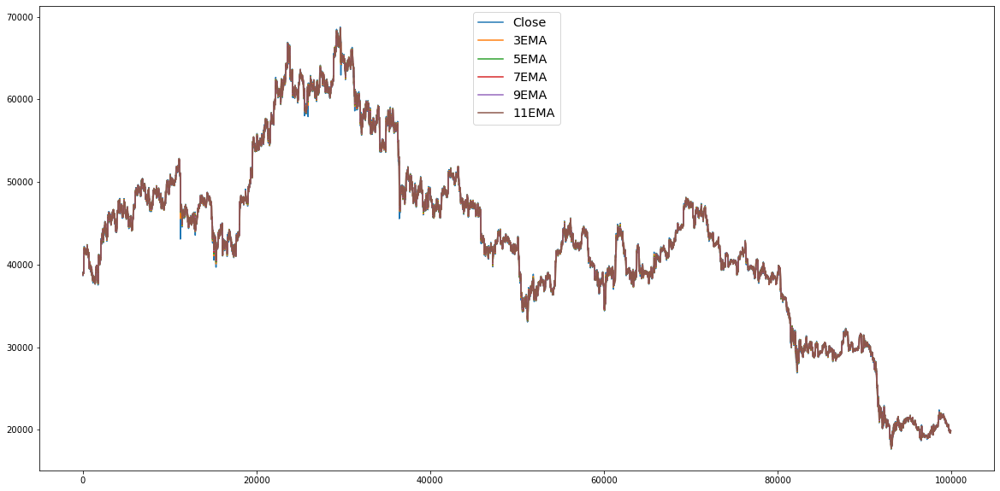

In [3]:
#see our data
plt.figure(figsize=(20,10))

plt.plot(data["Close"],label="Close")
plt.plot(data["3EMA"],label="3EMA")
plt.plot(data["5EMA"],label="5EMA")
plt.plot(data["7EMA"],label="7EMA")
plt.plot(data["9EMA"],label="9EMA")
plt.plot(data["11EMA"],label="11EMA")

plt.legend(loc='upper center',fontsize="x-large")

In [4]:
fig = px.line(data, x=data.index, y=["3EMA","5EMA","7EMA","9EMA","11EMA"])
fig.show()

In [5]:
data["diff_EMA"]=data["3EMA"]-data["11EMA"]
data

,Time,Open,High,Low,Close,3EMA,5EMA,7EMA,9EMA,11EMA,diff_EMA
0,2021-07-30 10:40:00,38733.53,38890.14,38722.41,38890.00,38890.000000,38890.000000,38890.000000,38890.000000,38890.000000,0.000000
1,2021-07-30 10:45:00,38889.99,38940.00,38817.78,38931.15,38917.433333,38914.690000,38913.514286,38912.861111,38912.445455,4.987879
2,2021-07-30 10:50:00,38931.16,38941.48,38856.92,38889.99,38901.751429,38902.990000,38903.341622,38903.487705,38903.561978,-1.810549
3,2021-07-30 10:55:00,38889.99,38906.46,38818.42,38854.53,38876.566667,38882.860462,38885.490514,38886.903117,38887.778212,-11.211545
4,2021-07-30 11:00:00,38854.54,38904.80,38800.00,38800.00,38837.048387,38851.051469,38857.468015,38861.051404,38863.318835,-26.270448
...,...,...,...,...,...,...,...,...,...,...,...
99917,2022-07-12 15:35:00,19918.31,19932.68,19867.75,19902.60,19915.184749,19919.040776,19918.162045,19915.060505,19911.217812,3.966937
99918,2022-07-12 15:40:00,19902.60,19909.76,19868.00,19883.92,19899.552374,19907.333851,19909.601534,19908.832404,19906.668177,-7.115802
99919,2022-07-12 15:45:00,19882.28,19903.17,19859.00,19888.58,19894.066187,19901.082567,19904.346151,19904.781923,19903.653481,-9.587294
99920,2022-07-12 15:50:00,19891.36,19943.23,19874.76,19880.80,19887.433094,19894.321711,19898.459613,19899.985538,19899.844567,-12.411474


In [6]:
buy_ema_price=data["Close"][0]
buy_close_price=0
status1=[0,0]
def find_crossover(fast_sma, close, slow_sma):      
    global buy_ema_price
    global buy_close_price
    global status1
    print(close,buy_close_price,close-buy_close_price,buy_ema_price)
    data_diff=close-buy_close_price
    
    if buy_close_price - close > 50 and status1[0]==0 :
        #if buy_ema_price!=0 and buy_close_price!=0 and status1!=0:
        status1[0]=1
        if status1[1]==1:
            status1[1]=0
        print("bearish")
        return 'stoploss sell' , data_diff
    
    if close > buy_ema_price and status1[0]==0 :
        #if buy_ema_price!=0 and buy_close_price!=0 and status1!=0:
        status1[0]=1
        if status1[1]==1:
            status1[1]=0
        print("bearish")
        return 'bearish crossover' , data_diff
    
    elif slow_sma -fast_sma > 30 and status1[1]==0:
        buy_ema_price=slow_sma
        buy_close_price=close
        status1[1]=1
        if status1[0]==1:
            status1[0]=0
        print("bullish")
        return 'bullish crossover' , data_diff
        #data["buy_ema"]=buy_ema_price
    return None,data_diff


data['crossover'],data["close_stoploss"] = np.vectorize(find_crossover)(data["3EMA"], data["Close"], data["11EMA"])
data

38890.0 0 38890.0 38890.0
38890.0 0 38890.0 38890.0
38931.15 0 38931.15 38890.0
bearish
38889.99 0 38889.99 38890.0
38854.53 0 38854.53 38890.0
38800.0 0 38800.0 38890.0
38830.07 0 38830.07 38890.0
38837.83 0 38837.83 38890.0
38760.24 0 38760.24 38890.0
bullish
38820.0 38760.24 59.76000000000204 38831.30535631359
38831.16 38760.24 70.92000000000553 38831.30535631359
38934.91 38760.24 174.67000000000553 38831.30535631359
bearish
38894.9 38760.24 134.6600000000035 38831.30535631359
38736.03 38760.24 -24.209999999999127 38831.30535631359
38752.49 38760.24 -7.75 38831.30535631359
bullish
38700.0 38752.49 -52.48999999999796 38820.69465592878
bearish
38642.46 38752.49 -110.02999999999884 38820.69465592878
bullish
38707.15 38642.46 64.69000000000233 38771.568608912676
38754.39 38642.46 111.93000000000029 38771.568608912676
38772.24 38642.46 129.77999999999884 38771.568608912676
bearish
38736.36 38642.46 93.90000000000146 38771.568608912676
38803.56 38642.46 161.09999999999854 38771.5686089126

41500.0 41338.92 161.08000000000175 41416.52408440089
41484.4 41338.92 145.4800000000032 41416.52408440089
41474.98 41338.92 136.06000000000495 41416.52408440089
41459.93 41338.92 121.01000000000204 41416.52408440089
41475.75 41338.92 136.83000000000175 41416.52408440089
41568.99 41338.92 230.0699999999997 41416.52408440089
41595.38 41338.92 256.4599999999991 41416.52408440089
41553.15 41338.92 214.2300000000032 41416.52408440089
41537.83 41338.92 198.9100000000035 41416.52408440089
41506.41 41338.92 167.49000000000524 41416.52408440089
41533.15 41338.92 194.2300000000032 41416.52408440089
41573.85 41338.92 234.9300000000003 41416.52408440089
41461.88 41338.92 122.95999999999913 41416.52408440089
41418.0 41338.92 79.08000000000175 41416.52408440089
bullish
41392.66 41418.0 -25.339999999996508 41497.25236974236
41338.0 41418.0 -80.0 41497.25236974236
bearish
41367.34 41418.0 -50.66000000000349 41497.25236974236
bullish
41371.25 41367.34 3.9100000000034925 41441.37632508239
41336.59 4136

39888.49 39868.48 20.00999999999476 40200.13790502671
39725.73 39868.48 -142.75 40200.13790502671
bearish
39897.86 39868.48 29.37999999999738 40200.13790502671
bullish
40095.99 39897.86 198.12999999999738 40047.797908001565
bearish
39845.44 39897.86 -52.419999999998254 40047.797908001565
bullish
39932.63 39845.44 87.18999999999505 40020.764936112195
39992.21 39845.44 146.7699999999968 40020.764936112195
40028.24 39845.44 182.79999999999563 40020.764936112195
bearish
39990.97 39845.44 145.52999999999884 40020.764936112195
39844.93 39845.44 -0.5100000000020373 40020.764936112195
bullish
39951.87 39844.93 106.94000000000233 39978.3480652457
39875.83 39844.93 30.900000000001455 39978.3480652457
39810.75 39844.93 -34.18000000000029 39978.3480652457
39636.48 39844.93 -208.4499999999971 39978.3480652457
bearish
39539.79 39844.93 -305.1399999999994 39978.3480652457
bullish
39566.0 39539.79 26.209999999999127 39826.35933563437
39518.73 39539.79 -21.05999999999767 39826.35933563437
39463.08 3953

39194.11 38835.17 358.9400000000023 38926.324230866296
bullish
39162.1 39194.11 -32.01000000000204 39340.35648540341
39147.82 39194.11 -46.29000000000087 39340.35648540341
38956.23 39194.11 -237.87999999999738 39340.35648540341
bearish
38923.56 39194.11 -270.5500000000029 39340.35648540341
bullish
38892.04 38923.56 -31.5199999999968 39178.06224026014
39005.6 38923.56 82.04000000000087 39178.06224026014
39092.11 38923.56 168.5500000000029 39178.06224026014
39255.49 38923.56 331.9300000000003 39178.06224026014
bearish
39470.52 38923.56 546.9599999999991 39178.06224026014
39676.95 38923.56 753.3899999999994 39178.06224026014
39600.0 38923.56 676.4400000000023 39178.06224026014
39613.12 38923.56 689.560000000005 39178.06224026014
39505.56 38923.56 582.0 39178.06224026014
39327.39 38923.56 403.83000000000175 39178.06224026014
39185.41 38923.56 261.8500000000058 39178.06224026014
bullish
39066.99 39185.41 -118.42000000000553 39350.546005804856
bearish
39153.59 39185.41 -31.820000000006985 39

38330.72 38233.27 97.45000000000437 38348.589170262116
38405.78 38233.27 172.51000000000204 38348.589170262116
38325.61 38233.27 92.34000000000378 38348.589170262116
bullish
38357.01 38325.61 31.400000000001455 38398.99729411614
38295.26 38325.61 -30.349999999998545 38398.99729411614
38187.01 38325.61 -138.59999999999854 38398.99729411614
bearish
38207.05 38325.61 -118.55999999999767 38398.99729411614
bullish
38147.83 38207.05 -59.220000000001164 38321.50706699274
bearish
38088.54 38207.05 -118.51000000000204 38321.50706699274
bullish
37984.41 38088.54 -104.12999999999738 38258.557407633845
bearish
38116.65 38088.54 28.110000000000582 38258.557407633845
bullish
38086.14 38116.65 -30.510000000002037 38196.830144190164
38046.43 38116.65 -70.22000000000116 38196.830144190164
bearish
38118.15 38116.65 1.5 38196.830144190164
bullish
38202.67 38118.15 84.5199999999968 38150.01651862857
bearish
38227.4 38118.15 109.25 38150.01651862857
38350.02 38118.15 231.86999999999534 38150.01651862857
38

39724.79 39659.73 65.05999999999767 39722.55306219958
39781.49 39659.73 121.75999999999476 39722.55306219958
39837.85 39659.73 178.11999999999534 39722.55306219958
39684.07 39659.73 24.339999999996508 39722.55306219958
39664.66 39659.73 4.930000000000291 39722.55306219958
bullish
39660.88 39664.66 -3.780000000006112 39746.69935291622
39662.8 39664.66 -1.860000000000582 39746.69935291622
39750.0 39664.66 85.33999999999651 39746.69935291622
bearish
39685.69 39664.66 21.029999999998836 39746.69935291622
39663.21 39664.66 -1.4500000000043656 39746.69935291622
39631.16 39664.66 -33.5 39746.69935291622
bullish
39554.63 39631.16 -76.53000000000611 39696.61253320722
bearish
39369.67 39631.16 -261.49000000000524 39696.61253320722
bullish
39343.83 39369.67 -25.839999999996508 39622.40231472724
39390.21 39369.67 20.540000000000873 39622.40231472724
39383.38 39369.67 13.709999999999127 39622.40231472724
39382.09 39369.67 12.419999999998254 39622.40231472724
39221.46 39369.67 -148.20999999999913 39

40172.66 40059.91 112.75 40512.21400963367
40174.93 40059.91 115.0199999999968 40512.21400963367
39966.45 40059.91 -93.4600000000064 40512.21400963367
bearish
40087.53 40059.91 27.619999999995343 40512.21400963367
bullish
40115.53 40087.53 28.0 40257.65810315139
40103.15 40087.53 15.62000000000262 40257.65810315139
40356.01 40087.53 268.4800000000032 40257.65810315139
bearish
40353.82 40087.53 266.2900000000009 40257.65810315139
40333.38 40087.53 245.84999999999854 40257.65810315139
40566.99 40087.53 479.4599999999991 40257.65810315139
40624.7 40087.53 537.1699999999983 40257.65810315139
40596.59 40087.53 509.0599999999977 40257.65810315139
40587.88 40087.53 500.34999999999854 40257.65810315139
40514.76 40087.53 427.2300000000032 40257.65810315139
40402.99 40087.53 315.4599999999991 40257.65810315139
40215.68 40087.53 128.15000000000146 40257.65810315139
bullish
40265.68 40215.68 50.0 40404.62515169533
40461.27 40215.68 245.5899999999965 40404.62515169533
bearish
40370.27 40215.68 154.

43530.95 43390.76 140.18999999999505 43414.410373869214
bearish
43592.33 43390.76 201.5699999999997 43414.410373869214
43510.2 43390.76 119.43999999999505 43414.410373869214
43506.16 43390.76 115.40000000000146 43414.410373869214
43428.16 43390.76 37.400000000001455 43414.410373869214
43400.0 43390.76 9.239999999997963 43414.410373869214
43392.36 43390.76 1.5999999999985448 43414.410373869214
bullish
43495.46 43392.36 103.09999999999854 43443.96427308544
bearish
43452.46 43392.36 60.099999999998545 43443.96427308544
43325.92 43392.36 -66.44000000000233 43443.96427308544
bullish
43362.14 43325.92 36.220000000001164 43431.43034322074
43121.63 43325.92 -204.29000000000087 43431.43034322074
bearish
43060.25 43325.92 -265.66999999999825 43431.43034322074
bullish
43177.4 43060.25 117.15000000000146 43318.51941158608
43203.4 43060.25 143.15000000000146 43318.51941158608
43195.82 43060.25 135.5699999999997 43318.51941158608
43254.46 43060.25 194.20999999999913 43318.51941158608
43248.19 43060.

bullish
44337.94 44350.01 -12.069999999999709 44604.1721790151
44364.29 44350.01 14.279999999998836 44604.1721790151
44382.33 44350.01 32.31999999999971 44604.1721790151
44282.09 44350.01 -67.92000000000553 44604.1721790151
bearish
44340.57 44350.01 -9.440000000002328 44604.1721790151
bullish
44414.01 44340.57 73.44000000000233 44445.29333583104
44371.36 44340.57 30.790000000000873 44445.29333583104
44505.0 44340.57 164.4300000000003 44445.29333583104
bearish
44483.53 44340.57 142.95999999999913 44445.29333583104
44361.72 44340.57 21.150000000001455 44445.29333583104
44384.45 44340.57 43.87999999999738 44445.29333583104
44486.43 44340.57 145.86000000000058 44445.29333583104
44550.0 44340.57 209.4300000000003 44445.29333583104
44648.93 44340.57 308.3600000000006 44445.29333583104
44620.0 44340.57 279.4300000000003 44445.29333583104
44465.22 44340.57 124.65000000000146 44445.29333583104
44523.95 44340.57 183.37999999999738 44445.29333583104
44462.32 44340.57 121.75 44445.29333583104
4445

45663.89 45557.5 106.38999999999942 45675.80673528644
45610.28 45557.5 52.779999999998836 45675.80673528644
45675.34 45557.5 117.83999999999651 45675.80673528644
45742.44 45557.5 184.94000000000233 45675.80673528644
45650.05 45557.5 92.55000000000291 45675.80673528644
45738.64 45557.5 181.13999999999942 45675.80673528644
45722.48 45557.5 164.9800000000032 45675.80673528644
45786.19 45557.5 228.69000000000233 45675.80673528644
45842.25 45557.5 284.75 45675.80673528644
45814.66 45557.5 257.1600000000035 45675.80673528644
45862.64 45557.5 305.1399999999994 45675.80673528644
45761.4 45557.5 203.90000000000146 45675.80673528644
45708.17 45557.5 150.66999999999825 45675.80673528644
45316.16 45557.5 -241.3399999999965 45675.80673528644
bullish
45396.01 45316.16 79.84999999999854 45680.93150041012
45458.43 45316.16 142.2699999999968 45680.93150041012
46080.15 45316.16 763.989999999998 45680.93150041012
bearish
45961.86 45316.16 645.6999999999971 45680.93150041012
46053.89 45316.16 737.72999999

45397.6 45243.02 154.58000000000175 45446.166554584284
45366.11 45243.02 123.09000000000378 45446.166554584284
45248.82 45243.02 5.80000000000291 45446.166554584284
45081.97 45243.02 -161.04999999999563 45446.166554584284
bearish
45026.67 45243.02 -216.34999999999854 45446.166554584284
bullish
45178.14 45026.67 151.47000000000116 45267.963359828726
45275.01 45026.67 248.34000000000378 45267.963359828726
bearish
45292.54 45026.67 265.8700000000026 45267.963359828726
45170.04 45026.67 143.37000000000262 45267.963359828726
bullish
45165.73 45170.04 -4.309999999997672 45247.20828695444
45146.37 45170.04 -23.669999999998254 45247.20828695444
45090.01 45170.04 -80.02999999999884 45247.20828695444
bearish
45050.56 45170.04 -119.4800000000032 45247.20828695444
bullish
44985.11 45050.56 -65.44999999999709 45173.07074795257
bearish
45095.14 45050.56 44.580000000001746 45173.07074795257
bullish
44811.91 45095.14 -283.2299999999959 45133.97663052262
bearish
44756.23 45095.14 -338.9099999999962 451

46351.5 46310.66 40.83999999999651 46402.06218944744
46386.23 46310.66 75.56999999999971 46402.06218944744
46298.44 46310.66 -12.220000000001164 46402.06218944744
46302.83 46310.66 -7.830000000001746 46402.06218944744
46316.72 46310.66 6.059999999997672 46402.06218944744
46305.56 46310.66 -5.100000000005821 46402.06218944744
46299.43 46310.66 -11.230000000003201 46402.06218944744
46286.94 46310.66 -23.720000000001164 46402.06218944744
46258.96 46310.66 -51.700000000004366 46402.06218944744
bearish
46339.98 46310.66 29.31999999999971 46402.06218944744
46331.9 46310.66 21.239999999997963 46402.06218944744
46362.22 46310.66 51.55999999999767 46402.06218944744
46359.36 46310.66 48.69999999999709 46402.06218944744
46346.28 46310.66 35.61999999999534 46402.06218944744
46412.32 46310.66 101.65999999999622 46402.06218944744
46448.0 46310.66 137.3399999999965 46402.06218944744
46543.55 46310.66 232.88999999999942 46402.06218944744
46580.51 46310.66 269.84999999999854 46402.06218944744
46601.0 4

46281.23 43889.32 2391.9100000000035 44041.633286684446
46293.25 43889.32 2403.9300000000003 44041.633286684446
46313.03 43889.32 2423.709999999999 44041.633286684446
46381.04 43889.32 2491.720000000001 44041.633286684446
46419.54 43889.32 2530.220000000001 44041.633286684446
46385.22 43889.32 2495.9000000000015 44041.633286684446
46390.63 43889.32 2501.3099999999977 44041.633286684446
46346.16 43889.32 2456.840000000004 44041.633286684446
46428.99 43889.32 2539.6699999999983 44041.633286684446
46430.89 43889.32 2541.5699999999997 44041.633286684446
46148.35 43889.32 2259.029999999999 44041.633286684446
bullish
46324.0 46148.35 175.65000000000146 46342.91787652986
46247.01 46148.35 98.66000000000349 46342.91787652986
46138.47 46148.35 -9.87999999999738 46342.91787652986
46153.71 46148.35 5.360000000000582 46342.91787652986
46261.11 46148.35 112.76000000000204 46342.91787652986
46243.01 46148.35 94.66000000000349 46342.91787652986
46293.0 46148.35 144.65000000000146 46342.91787652986
46

46411.95 46201.71 210.23999999999796 46470.35286300689
46470.98 46201.71 269.2700000000041 46470.35286300689
bearish
46569.99 46201.71 368.27999999999884 46470.35286300689
46404.01 46201.71 202.3000000000029 46470.35286300689
46380.0 46201.71 178.29000000000087 46470.35286300689
46407.88 46201.71 206.16999999999825 46470.35286300689
46294.42 46201.71 92.70999999999913 46470.35286300689
bullish
46327.97 46294.42 33.55000000000291 46391.81019266513
46310.5 46294.42 16.080000000001746 46391.81019266513
46380.5 46294.42 86.08000000000175 46391.81019266513
46392.35 46294.42 97.93000000000029 46391.81019266513
bearish
46340.83 46294.42 46.41000000000349 46391.81019266513
46359.83 46294.42 65.41000000000349 46391.81019266513
46295.32 46294.42 0.9000000000014552 46391.81019266513
46269.35 46294.42 -25.06999999999971 46391.81019266513
bullish
46327.44 46269.35 58.09000000000378 46341.15822364148
46161.28 46269.35 -108.06999999999971 46341.15822364148
bearish
46280.82 46269.35 11.470000000001164

46041.81 45840.99 200.8199999999997 46147.91135538083
45944.85 45840.99 103.86000000000058 46147.91135538083
bullish
45973.0 45944.85 28.150000000001455 46062.032791849095
45905.5 45944.85 -39.349999999998545 46062.032791849095
45890.47 45944.85 -54.37999999999738 46062.032791849095
bearish
45701.3 45944.85 -243.54999999999563 46062.032791849095
bullish
45739.56 45701.3 38.25999999999476 45951.37800532846
45713.9 45701.3 12.599999999998545 45951.37800532846
45733.07 45701.3 31.7699999999968 45951.37800532846
45737.44 45701.3 36.13999999999942 45951.37800532846
45901.05 45701.3 199.75 45951.37800532846
45981.01 45701.3 279.7099999999991 45951.37800532846
bearish
45906.15 45701.3 204.84999999999854 45951.37800532846
45969.88 45701.3 268.57999999999447 45951.37800532846
45999.19 45701.3 297.8899999999994 45951.37800532846
45989.62 45701.3 288.3199999999997 45951.37800532846
45973.9 45701.3 272.59999999999854 45951.37800532846
46031.74 45701.3 330.43999999999505 45951.37800532846
45999.99 

46180.0 45769.35 410.65000000000146 45925.327384663164
46331.97 45769.35 562.6200000000026 45925.327384663164
46197.24 45769.35 427.8899999999994 45925.327384663164
46173.75 45769.35 404.40000000000146 45925.327384663164
46168.39 45769.35 399.0400000000009 45925.327384663164
46188.22 45769.35 418.8700000000026 45925.327384663164
46093.06 45769.35 323.7099999999991 45925.327384663164
46073.14 45769.35 303.7900000000009 45925.327384663164
bullish
46162.93 46073.14 89.79000000000087 46143.016792673516
bearish
46121.11 46073.14 47.970000000001164 46143.016792673516
46101.45 46073.14 28.30999999999767 46143.016792673516
45993.17 46073.14 -79.97000000000116 46143.016792673516
bullish
46028.89 45993.17 35.720000000001164 46111.654294306296
45844.62 45993.17 -148.54999999999563 46111.654294306296
bearish
45809.96 45993.17 -183.20999999999913 46111.654294306296
bullish
45909.29 45809.96 99.33000000000175 46014.704614760594
45998.14 45809.96 188.1800000000003 46014.704614760594
46163.43 45809.96

45494.17 45379.61 114.55999999999767 45693.614034567145
45509.29 45379.61 129.6800000000003 45693.614034567145
45419.38 45379.61 39.7699999999968 45693.614034567145
45465.01 45379.61 85.40000000000146 45693.614034567145
45206.88 45379.61 -172.7300000000032 45693.614034567145
bearish
45183.04 45379.61 -196.5699999999997 45693.614034567145
bullish
45095.02 45183.04 -88.02000000000407 45439.430255153056
bearish
44893.25 45183.04 -289.7900000000009 45439.430255153056
bullish
44837.28 44893.25 -55.970000000001164 45300.56545496741
bearish
44729.03 44893.25 -164.22000000000116 45300.56545496741
bullish
44792.18 44729.03 63.150000000001455 45140.96434372736
44958.83 44729.03 229.8000000000029 45140.96434372736
44876.96 44729.03 147.9300000000003 45140.96434372736
45069.03 44729.03 340.0 45140.96434372736
44968.91 44729.03 239.88000000000466 45140.96434372736
44999.01 44729.03 269.9800000000032 45140.96434372736
44989.98 44729.03 260.95000000000437 45140.96434372736
44792.59 44729.03 63.559999

bullish
44911.99 44852.57 59.419999999998254 44972.601624621224
44831.73 44852.57 -20.839999999996508 44972.601624621224
44900.0 44852.57 47.43000000000029 44972.601624621224
44853.63 44852.57 1.0599999999976717 44972.601624621224
44830.72 44852.57 -21.849999999998545 44972.601624621224
44690.98 44852.57 -161.5899999999965 44972.601624621224
bearish
44756.91 44852.57 -95.65999999999622 44972.601624621224
bullish
44590.0 44756.91 -166.9100000000035 44850.98849927673
bearish
44600.59 44756.91 -156.32000000000698 44850.98849927673
bullish
44525.26 44600.59 -75.32999999999447 44773.00701338662
bearish
44693.9 44600.59 93.31000000000495 44773.00701338662
bullish
44710.4 44693.9 16.5 44725.41320374071
44687.03 44693.9 -6.870000000002619 44725.41320374071
44601.15 44693.9 -92.75 44725.41320374071
bearish
44597.03 44693.9 -96.87000000000262 44725.41320374071
bullish
44666.06 44597.03 69.02999999999884 44680.86669161879
44594.53 44597.03 -2.5 44680.86669161879
44558.26 44597.03 -38.769999999996

47258.16 46430.03 828.1300000000047 46479.00060531286
47268.15 46430.03 838.1200000000026 46479.00060531286
47318.86 46430.03 888.8300000000017 46479.00060531286
47257.11 46430.03 827.0800000000017 46479.00060531286
47164.99 46430.03 734.9599999999991 46479.00060531286
47075.74 46430.03 645.7099999999991 46479.00060531286
47140.45 46430.03 710.4199999999983 46479.00060531286
47018.86 46430.03 588.8300000000017 46479.00060531286
46993.75 46430.03 563.7200000000012 46479.00060531286
47051.19 46430.03 621.1600000000035 46479.00060531286
47106.08 46430.03 676.0500000000029 46479.00060531286
47159.21 46430.03 729.1800000000003 46479.00060531286
47059.89 46430.03 629.8600000000006 46479.00060531286
47170.0 46430.03 739.9700000000012 46479.00060531286
47215.79 46430.03 785.760000000002 46479.00060531286
47243.23 46430.03 813.2000000000044 46479.00060531286
47168.08 46430.03 738.0500000000029 46479.00060531286
47280.0 46430.03 849.9700000000012 46479.00060531286
47193.51 46430.03 763.480000000

48765.05 48625.67 139.38000000000466 48702.0619199559
48802.46 48625.67 176.79000000000087 48702.0619199559
48801.0 48625.67 175.33000000000175 48702.0619199559
48745.39 48625.67 119.72000000000116 48702.0619199559
48813.75 48625.67 188.08000000000175 48702.0619199559
48797.51 48625.67 171.84000000000378 48702.0619199559
48721.1 48625.67 95.43000000000029 48702.0619199559
48714.9 48625.67 89.2300000000032 48702.0619199559
bullish
48702.93 48714.9 -11.970000000001164 48772.52705377876
48712.95 48714.9 -1.9500000000043656 48772.52705377876
48623.66 48714.9 -91.23999999999796 48772.52705377876
bearish
48674.74 48714.9 -40.16000000000349 48772.52705377876
bullish
48681.2 48674.74 6.459999999999127 48721.9450606572
48651.22 48674.74 -23.5199999999968 48721.9450606572
48710.0 48674.74 35.26000000000204 48721.9450606572
48876.1 48674.74 201.36000000000058 48721.9450606572
bearish
48936.6 48674.74 261.8600000000006 48721.9450606572
48884.26 48674.74 209.52000000000407 48721.9450606572
48865.06

49300.96 48908.38 392.58000000000175 49286.54657781108
49229.0 48908.38 320.6200000000026 49286.54657781108
49348.67 48908.38 440.2900000000009 49286.54657781108
49271.37 48908.38 362.99000000000524 49286.54657781108
49336.35 48908.38 427.97000000000116 49286.54657781108
49300.02 48908.38 391.6399999999994 49286.54657781108
49357.28 48908.38 448.90000000000146 49286.54657781108
49290.0 48908.38 381.6200000000026 49286.54657781108
49245.28 48908.38 336.90000000000146 49286.54657781108
49187.38 48908.38 279.0 49286.54657781108
bullish
49138.21 49187.38 -49.169999999998254 49266.770947279736
48982.36 49187.38 -205.0199999999968 49266.770947279736
bearish
48913.63 49187.38 -273.75 49266.770947279736
bullish
48981.79 48913.63 68.16000000000349 49153.53286300911
48940.06 48913.63 26.43000000000029 49153.53286300911
48939.98 48913.63 26.35000000000582 49153.53286300911
48821.87 48913.63 -91.75999999999476 49153.53286300911
bearish
48818.88 48913.63 -94.75 49153.53286300911
bullish
48973.68 48

49272.69 48275.59 997.1000000000058 48360.31891572881
49302.32 48275.59 1026.7300000000032 48360.31891572881
49317.16 48275.59 1041.570000000007 48360.31891572881
49262.01 48275.59 986.4200000000055 48360.31891572881
49239.22 48275.59 963.6300000000047 48360.31891572881
49360.0 48275.59 1084.4100000000035 48360.31891572881
49345.77 48275.59 1070.1800000000003 48360.31891572881
49378.05 48275.59 1102.4600000000064 48360.31891572881
49340.0 48275.59 1064.4100000000035 48360.31891572881
49302.42 48275.59 1026.8300000000017 48360.31891572881
49301.27 48275.59 1025.6800000000003 48360.31891572881
49097.08 48275.59 821.4900000000052 48360.31891572881
bullish
49120.0 49097.08 22.919999999998254 49273.00261881601
49177.7 49097.08 80.61999999999534 49273.00261881601
49351.45 49097.08 254.36999999999534 49273.00261881601
bearish
49368.37 49097.08 271.2900000000009 49273.00261881601
49418.77 49097.08 321.68999999999505 49273.00261881601
49346.12 49097.08 249.04000000000087 49273.00261881601
49395

49092.97 48956.97 136.0 49040.607565581515
49079.11 48956.97 122.13999999999942 49040.607565581515
49139.17 48956.97 182.1999999999971 49040.607565581515
49167.61 48956.97 210.63999999999942 49040.607565581515
49157.58 48956.97 200.61000000000058 49040.607565581515
49195.55 48956.97 238.58000000000175 49040.607565581515
49295.89 48956.97 338.91999999999825 49040.607565581515
49275.52 48956.97 318.54999999999563 49040.607565581515
49229.99 48956.97 273.0199999999968 49040.607565581515
49262.74 48956.97 305.7699999999968 49040.607565581515
49210.87 48956.97 253.90000000000146 49040.607565581515
49266.69 48956.97 309.72000000000116 49040.607565581515
49359.46 48956.97 402.48999999999796 49040.607565581515
49314.48 48956.97 357.51000000000204 49040.607565581515
49302.6 48956.97 345.6299999999974 49040.607565581515
49330.0 48956.97 373.02999999999884 49040.607565581515
49384.0 48956.97 427.02999999999884 49040.607565581515
49331.16 48956.97 374.1900000000023 49040.607565581515
49285.99 4895

bearish
47953.83 47618.07 335.76000000000204 48019.80980891446
48069.87 47618.07 451.8000000000029 48019.80980891446
48050.0 47618.07 431.9300000000003 48019.80980891446
48007.86 47618.07 389.7900000000009 48019.80980891446
47918.53 47618.07 300.4599999999991 48019.80980891446
47789.69 47618.07 171.62000000000262 48019.80980891446
bullish
47813.26 47789.69 23.56999999999971 47937.22330101313
47814.9 47789.69 25.209999999999127 47937.22330101313
47773.34 47789.69 -16.35000000000582 47937.22330101313
47823.6 47789.69 33.90999999999622 47937.22330101313
47893.63 47789.69 103.93999999999505 47937.22330101313
47946.0 47789.69 156.30999999999767 47937.22330101313
bearish
48029.74 47789.69 240.04999999999563 47937.22330101313
48055.02 47789.69 265.32999999999447 47937.22330101313
48090.26 47789.69 300.5699999999997 47937.22330101313
48156.17 47789.69 366.4799999999959 47937.22330101313
48196.92 47789.69 407.2299999999959 47937.22330101313
48259.82 47789.69 470.1299999999974 47937.22330101313


48710.78 48731.61 -20.830000000001746 48787.46855054031
48695.54 48731.61 -36.06999999999971 48787.46855054031
48633.99 48731.61 -97.62000000000262 48787.46855054031
bearish
48373.16 48731.61 -358.4499999999971 48787.46855054031
bullish
48265.89 48373.16 -107.27000000000407 48669.469376118665
bearish
48186.14 48373.16 -187.02000000000407 48669.469376118665
bullish
48194.0 48186.14 7.860000000000582 48532.8617889713
48108.85 48186.14 -77.29000000000087 48532.8617889713
bearish
48121.36 48186.14 -64.77999999999884 48532.8617889713
bullish
48051.18 48121.36 -70.18000000000029 48366.167516765796
bearish
48020.0 48121.36 -101.36000000000058 48366.167516765796
bullish
47915.53 48020.0 -104.47000000000116 48264.72466442069
bearish
47918.01 48020.0 -101.98999999999796 48264.72466442069
bullish
47911.79 47918.01 -6.220000000001164 48158.43962806993
47833.0 47918.01 -85.01000000000204 48158.43962806993
bearish
47849.99 47918.01 -68.02000000000407 48158.43962806993
bullish
47740.5 47849.99 -109.4

bullish
47110.23 47211.29 -101.05999999999767 47297.353598425136
bearish
47080.71 47211.29 -130.58000000000175 47297.353598425136
bullish
47070.93 47080.71 -9.779999999998836 47235.25694335079
46950.01 47080.71 -130.6999999999971 47235.25694335079
bearish
46905.38 47080.71 -175.33000000000175 47235.25694335079
bullish
46768.07 46905.38 -137.30999999999767 47121.64049962429
bearish
46820.88 46905.38 -84.5 47121.64049962429
bullish
46903.7 46820.88 82.81999999999971 47022.40673585021
46738.5 46820.88 -82.37999999999738 47022.40673585021
bearish
46823.96 46820.88 3.0800000000017462 47022.40673585021
bullish
46715.95 46823.96 -108.01000000000204 46936.16158324665
bearish
46822.23 46823.96 -1.7299999999959255 46936.16158324665
bullish
46754.26 46822.23 -67.97000000000116 46886.588043921285
bearish
46686.48 46822.23 -135.75 46886.588043921285
bullish
46677.05 46686.48 -9.430000000000291 46834.85780827867
46632.93 46686.48 -53.55000000000291 46834.85780827867
bearish
46609.71 46686.48 -76.770

49059.97 48930.61 129.36000000000058 49014.63001582718
48987.98 48930.61 57.37000000000262 49014.63001582718
bullish
49035.35 48987.98 47.36999999999534 49094.884616074836
49035.2 48987.98 47.21999999999389 49094.884616074836
48991.36 48987.98 3.3799999999973807 49094.884616074836
49044.35 48987.98 56.36999999999534 49094.884616074836
48972.14 48987.98 -15.840000000003783 49094.884616074836
48852.71 48987.98 -135.27000000000407 49094.884616074836
bearish
48945.03 48987.98 -42.950000000004366 49094.884616074836
bullish
48901.83 48945.03 -43.19999999999709 49001.551336237026
48967.87 48945.03 22.840000000003783 49001.551336237026
48939.9 48945.03 -5.129999999997381 49001.551336237026
48934.93 48945.03 -10.099999999998545 49001.551336237026
48910.99 48945.03 -34.04000000000087 49001.551336237026
48927.99 48945.03 -17.040000000000873 49001.551336237026
48950.21 48945.03 5.180000000000291 49001.551336237026
48926.03 48945.03 -19.0 49001.551336237026
48961.24 48945.03 16.209999999999127 4900

48776.14 48997.99 -221.84999999999854 49211.072876131315
bullish
48580.08 48776.14 -196.05999999999767 49084.989219535644
bearish
48616.13 48776.14 -160.01000000000204 49084.989219535644
bullish
48653.81 48616.13 37.68000000000029 48936.71973578863
48572.53 48616.13 -43.599999999998545 48936.71973578863
48550.0 48616.13 -66.12999999999738 48936.71973578863
bearish
48459.6 48616.13 -156.52999999999884 48936.71973578863
bullish
48234.01 48459.6 -225.5899999999965 48734.050296965965
bearish
48297.81 48459.6 -161.79000000000087 48734.050296965965
bullish
48161.64 48297.81 -136.16999999999825 48591.89353955971
bearish
48280.28 48297.81 -17.529999999998836 48591.89353955971
bullish
48260.95 48280.28 -19.330000000001746 48480.20051358313
48313.79 48280.28 33.51000000000204 48480.20051358313
48227.31 48280.28 -52.970000000001164 48480.20051358313
bearish
48025.85 48280.28 -254.4300000000003 48480.20051358313
bullish
48049.51 48025.85 23.660000000003492 48328.944422059765
48051.99 48025.85 26.1

48055.38 47869.33 186.04999999999563 48153.60488643576
48058.62 47869.33 189.29000000000087 48153.60488643576
48053.34 47869.33 184.00999999999476 48153.60488643576
47985.05 47869.33 115.72000000000116 48153.60488643576
47930.97 47869.33 61.63999999999942 48153.60488643576
47773.97 47869.33 -95.36000000000058 48153.60488643576
bearish
47841.0 47869.33 -28.330000000001746 48153.60488643576
bullish
47787.38 47841.0 -53.62000000000262 47960.23895211597
bearish
47902.15 47841.0 61.150000000001455 47960.23895211597
bullish
47887.71 47902.15 -14.440000000002328 47926.54927230276
47869.02 47902.15 -33.13000000000466 47926.54927230276
47885.55 47902.15 -16.599999999998545 47926.54927230276
47900.99 47902.15 -1.1600000000034925 47926.54927230276
47965.04 47902.15 62.88999999999942 47926.54927230276
bearish
48000.04 47902.15 97.88999999999942 47926.54927230276
48000.02 47902.15 97.86999999999534 47926.54927230276
47915.01 47902.15 12.860000000000582 47926.54927230276
47980.71 47902.15 78.5599999

46921.14 46929.0 -7.860000000000582 47305.647561291335
46852.57 46929.0 -76.43000000000029 47305.647561291335
bearish
46747.81 46929.0 -181.19000000000233 47305.647561291335
bullish
46771.32 46747.81 23.510000000002037 47014.65569474774
46733.86 46747.81 -13.94999999999709 47014.65569474774
46738.23 46747.81 -9.57999999999447 47014.65569474774
46870.13 46747.81 122.31999999999971 47014.65569474774
46894.75 46747.81 146.94000000000233 47014.65569474774
46845.49 46747.81 97.68000000000029 47014.65569474774
46947.38 46747.81 199.5699999999997 47014.65569474774
46856.51 46747.81 108.70000000000437 47014.65569474774
46946.42 46747.81 198.61000000000058 47014.65569474774
46990.78 46747.81 242.97000000000116 47014.65569474774
46934.72 46747.81 186.9100000000035 47014.65569474774
46905.44 46747.81 157.63000000000466 47014.65569474774
46958.8 46747.81 210.99000000000524 47014.65569474774
46860.99 46747.81 113.18000000000029 47014.65569474774
46893.13 46747.81 145.3199999999997 47014.65569474774

46992.6 46954.83 37.7699999999968 47159.13360297168
46886.97 46954.83 -67.86000000000058 47159.13360297168
bearish
46915.2 46954.83 -39.63000000000466 47159.13360297168
bullish
46992.24 46915.2 77.04000000000087 47061.4027794975
46975.48 46915.2 60.28000000000611 47061.4027794975
46833.33 46915.2 -81.86999999999534 47061.4027794975
bearish
46991.53 46915.2 76.33000000000175 47061.4027794975
bullish
46995.01 46991.53 3.4800000000032014 47001.46498239656
47007.05 46991.53 15.520000000004075 47001.46498239656
bearish
47161.34 46991.53 169.80999999999767 47001.46498239656
47100.05 46991.53 108.52000000000407 47001.46498239656
47053.16 46991.53 61.63000000000466 47001.46498239656
46911.5 46991.53 -80.02999999999884 47001.46498239656
46964.67 46991.53 -26.860000000000582 47001.46498239656
bullish
46985.85 46964.67 21.18000000000029 47011.19297989445
46934.43 46964.67 -30.239999999997963 47011.19297989445
46901.76 46964.67 -62.90999999999622 47011.19297989445
bearish
46820.0 46964.67 -144.669

48509.38 48659.31 -149.9300000000003 48711.69850109567
bullish
48469.19 48509.38 -40.18999999999505 48659.498403538666
48500.0 48509.38 -9.37999999999738 48659.498403538666
48390.21 48509.38 -119.16999999999825 48659.498403538666
bearish
48427.65 48509.38 -81.72999999999593 48659.498403538666
bullish
48124.66 48427.65 -302.98999999999796 48546.64000942259
bearish
48129.82 48427.65 -297.83000000000175 48546.64000942259
bullish
48173.48 48129.82 43.66000000000349 48418.56167321013
48262.83 48129.82 133.01000000000204 48418.56167321013
48185.0 48129.82 55.18000000000029 48418.56167321013
48150.0 48129.82 20.18000000000029 48418.56167321013
48246.4 48129.82 116.58000000000175 48418.56167321013
48220.11 48129.82 90.29000000000087 48418.56167321013
48286.75 48129.82 156.9300000000003 48418.56167321013
48230.88 48129.82 101.05999999999767 48418.56167321013
48259.06 48129.82 129.23999999999796 48418.56167321013
48327.6 48129.82 197.77999999999884 48418.56167321013
48286.09 48129.82 156.2699999

49844.71 49996.59 -151.87999999999738 50070.500047730646
bearish
49812.01 49996.59 -184.57999999999447 50070.500047730646
bullish
49570.0 49812.01 -242.01000000000204 49996.058644257384
bearish
49707.73 49812.01 -104.27999999999884 49996.058644257384
bullish
49652.79 49707.73 -54.94000000000233 49888.82905851206
bearish
49529.96 49707.73 -177.77000000000407 49888.82905851206
bullish
49519.35 49529.96 -10.610000000000582 49796.23434618893
49428.34 49529.96 -101.62000000000262 49796.23434618893
bearish
49570.8 49529.96 40.84000000000378 49796.23434618893
bullish
49668.0 49570.8 97.19999999999709 49675.51871885933
49671.13 49570.8 100.32999999999447 49675.51871885933
49671.95 49570.8 101.14999999999418 49675.51871885933
49689.0 49570.8 118.19999999999709 49675.51871885933
bearish
49648.15 49570.8 77.34999999999854 49675.51871885933
49612.12 49570.8 41.31999999999971 49675.51871885933
49725.59 49570.8 154.7899999999936 49675.51871885933
49624.5 49570.8 53.69999999999709 49675.51871885933
4

49319.09 49407.66 -88.57000000000698 49478.8278673885
bullish
49355.01 49319.09 35.92000000000553 49404.84845610307
49343.4 49319.09 24.310000000004948 49404.84845610307
49364.39 49319.09 45.30000000000291 49404.84845610307
49422.45 49319.09 103.36000000000058 49404.84845610307
bearish
49505.36 49319.09 186.27000000000407 49404.84845610307
49467.36 49319.09 148.27000000000407 49404.84845610307
49364.16 49319.09 45.070000000006985 49404.84845610307
49290.32 49319.09 -28.7699999999968 49404.84845610307
bullish
49305.11 49290.32 14.790000000000873 49389.99558692895
49337.02 49290.32 46.69999999999709 49389.99558692895
49380.0 49290.32 89.68000000000029 49389.99558692895
49451.47 49290.32 161.15000000000146 49389.99558692895
bearish
49412.62 49290.32 122.30000000000291 49389.99558692895
49399.77 49290.32 109.44999999999709 49389.99558692895
49335.74 49290.32 45.419999999998254 49389.99558692895
49350.0 49290.32 59.68000000000029 49389.99558692895
49452.98 49290.32 162.6600000000035 49389.9

50270.01 50020.0 250.01000000000204 50156.8062881744
50308.29 50020.0 288.2900000000009 50156.8062881744
50300.01 50020.0 280.01000000000204 50156.8062881744
50349.99 50020.0 329.98999999999796 50156.8062881744
50240.01 50020.0 220.01000000000204 50156.8062881744
bullish
50012.03 50240.01 -227.9800000000032 50318.73673137343
bearish
50060.54 50240.01 -179.47000000000116 50318.73673137343
bullish
49789.59 50060.54 -270.95000000000437 50233.105785675994
bearish
49784.99 50060.54 -275.5500000000029 50233.105785675994
bullish
49850.73 49784.99 65.74000000000524 50096.820406719446
49858.87 49784.99 73.88000000000466 50096.820406719446
49936.02 49784.99 151.02999999999884 50096.820406719446
50022.89 49784.99 237.90000000000146 50096.820406719446
49905.44 49784.99 120.45000000000437 50096.820406719446
49817.63 49784.99 32.63999999999942 50096.820406719446
49832.05 49784.99 47.06000000000495 50096.820406719446
49806.96 49784.99 21.970000000001164 50096.820406719446
49889.38 49784.99 104.389999

50174.97 49990.1 184.87000000000262 50041.28986383737
50197.03 49990.1 206.9300000000003 50041.28986383737
50157.15 49990.1 167.0500000000029 50041.28986383737
50198.78 49990.1 208.6800000000003 50041.28986383737
50159.65 49990.1 169.5500000000029 50041.28986383737
50139.14 49990.1 149.04000000000087 50041.28986383737
50171.96 49990.1 181.86000000000058 50041.28986383737
50222.68 49990.1 232.58000000000175 50041.28986383737
50175.16 49990.1 185.06000000000495 50041.28986383737
50176.94 49990.1 186.84000000000378 50041.28986383737
50176.03 49990.1 185.9300000000003 50041.28986383737
50136.69 49990.1 146.59000000000378 50041.28986383737
50056.36 49990.1 66.26000000000204 50041.28986383737
bullish
50060.31 50056.36 3.9499999999970896 50142.84780978657
50042.34 50056.36 -14.020000000004075 50142.84780978657
50110.1 50056.36 53.73999999999796 50142.84780978657
50137.21 50056.36 80.84999999999854 50142.84780978657
50081.52 50056.36 25.159999999996217 50142.84780978657
50083.98 50056.36 27.62

51615.02 51150.0 465.0199999999968 51512.3170475103
51604.45 51150.0 454.4499999999971 51512.3170475103
51693.41 51150.0 543.4100000000035 51512.3170475103
51480.71 51150.0 330.7099999999991 51512.3170475103
bullish
51539.12 51480.71 58.41000000000349 51613.65127800176
51525.0 51480.71 44.29000000000087 51613.65127800176
51625.52 51480.71 144.80999999999767 51613.65127800176
bearish
51609.52 51480.71 128.80999999999767 51613.65127800176
51633.29 51480.71 152.58000000000175 51613.65127800176
51652.32 51480.71 171.61000000000058 51613.65127800176
51600.93 51480.71 120.22000000000116 51613.65127800176
51583.35 51480.71 102.63999999999942 51613.65127800176
51538.99 51480.71 58.279999999998836 51613.65127800176
51550.38 51480.71 69.66999999999825 51613.65127800176
51564.71 51480.71 84.0 51613.65127800176
51626.6 51480.71 145.88999999999942 51613.65127800176
51625.96 51480.71 145.25 51613.65127800176
51643.36 51480.71 162.65000000000146 51613.65127800176
51637.13 51480.71 156.41999999999825 

46850.01 45859.85 990.1600000000035 47774.72104434635
46894.58 45859.85 1034.7300000000032 47774.72104434635
46880.17 45859.85 1020.3199999999997 47774.72104434635
46808.89 45859.85 949.0400000000009 47774.72104434635
46797.24 45859.85 937.3899999999994 47774.72104434635
46769.08 45859.85 909.2300000000032 47774.72104434635
46606.44 45859.85 746.5900000000038 47774.72104434635
46791.36 45859.85 931.510000000002 47774.72104434635
46676.69 45859.85 816.8400000000038 47774.72104434635
46470.11 45859.85 610.260000000002 47774.72104434635
46116.66 45859.85 256.81000000000495 47774.72104434635
46480.58 45859.85 620.7300000000032 47774.72104434635
46758.4 45859.85 898.5500000000029 47774.72104434635
46640.33 45859.85 780.4800000000032 47774.72104434635
47132.25 45859.85 1272.4000000000015 47774.72104434635
47182.01 45859.85 1322.1600000000035 47774.72104434635
47125.65 45859.85 1265.800000000003 47774.72104434635
46934.73 45859.85 1074.8800000000047 47774.72104434635
46922.02 45859.85 1062.16

46314.49 46008.35 306.1399999999994 46205.63684979242
46354.07 46008.35 345.72000000000116 46205.63684979242
46292.54 46008.35 284.1900000000023 46205.63684979242
46313.82 46008.35 305.47000000000116 46205.63684979242
46371.85 46008.35 363.5 46205.63684979242
46496.7 46008.35 488.34999999999854 46205.63684979242
46360.26 46008.35 351.9100000000035 46205.63684979242
46350.07 46008.35 341.72000000000116 46205.63684979242
46411.38 46008.35 403.02999999999884 46205.63684979242
46448.01 46008.35 439.6600000000035 46205.63684979242
46380.37 46008.35 372.0200000000041 46205.63684979242
46389.52 46008.35 381.16999999999825 46205.63684979242
46280.0 46008.35 271.65000000000146 46205.63684979242
46293.47 46008.35 285.1200000000026 46205.63684979242
bullish
46357.48 46293.47 64.01000000000204 46346.89762538684
bearish
46290.02 46293.47 -3.4500000000043656 46346.89762538684
46416.18 46293.47 122.70999999999913 46346.89762538684
46436.32 46293.47 142.84999999999854 46346.89762538684
46080.94 46293.

46395.02 46546.67 -151.65000000000146 46806.51257607754
bullish
46222.97 46395.02 -172.04999999999563 46536.249681869245
bearish
46229.42 46395.02 -165.59999999999854 46536.249681869245
bullish
46216.52 46229.42 -12.900000000001455 46441.600334631425
46299.99 46229.42 70.56999999999971 46441.600334631425
46282.03 46229.42 52.61000000000058 46441.600334631425
46291.89 46229.42 62.470000000001164 46441.600334631425
46252.36 46229.42 22.94000000000233 46441.600334631425
46313.41 46229.42 83.99000000000524 46441.600334631425
46293.07 46229.42 63.650000000001455 46441.600334631425
46321.0 46229.42 91.58000000000175 46441.600334631425
46326.63 46229.42 97.20999999999913 46441.600334631425
46367.82 46229.42 138.40000000000146 46441.600334631425
46407.17 46229.42 177.75 46441.600334631425
46474.28 46229.42 244.86000000000058 46441.600334631425
bearish
46460.02 46229.42 230.59999999999854 46441.600334631425
46448.71 46229.42 219.29000000000087 46441.600334631425
46431.72 46229.42 202.3000000000

45080.36 44458.3 622.0599999999977 44681.587849873176
45142.24 44458.3 683.939999999995 44681.587849873176
45143.64 44458.3 685.3399999999965 44681.587849873176
45179.99 44458.3 721.689999999995 44681.587849873176
45187.53 44458.3 729.2299999999959 44681.587849873176
45221.27 44458.3 762.9699999999939 44681.587849873176
45266.22 44458.3 807.9199999999983 44681.587849873176
45270.92 44458.3 812.6199999999953 44681.587849873176
45340.46 44458.3 882.1599999999962 44681.587849873176
45360.85 44458.3 902.5499999999956 44681.587849873176
45436.46 44458.3 978.1599999999962 44681.587849873176
45381.2 44458.3 922.8999999999942 44681.587849873176
45363.98 44458.3 905.6800000000003 44681.587849873176
45382.03 44458.3 923.7299999999959 44681.587849873176
45456.31 44458.3 998.0099999999948 44681.587849873176
45402.44 44458.3 944.1399999999994 44681.587849873176
45395.03 44458.3 936.7299999999959 44681.587849873176
45338.66 44458.3 880.3600000000006 44681.587849873176
45387.26 44458.3 928.9599999999

45301.09 44810.63 490.4599999999991 44878.34817593621
45334.11 44810.63 523.4800000000032 44878.34817593621
45397.92 44810.63 587.2900000000009 44878.34817593621
45470.81 44810.63 660.1800000000003 44878.34817593621
45432.19 44810.63 621.560000000005 44878.34817593621
45417.91 44810.63 607.2800000000061 44878.34817593621
45364.67 44810.63 554.0400000000009 44878.34817593621
45416.55 44810.63 605.9200000000055 44878.34817593621
45361.34 44810.63 550.7099999999991 44878.34817593621
45357.18 44810.63 546.5500000000029 44878.34817593621
45317.87 44810.63 507.24000000000524 44878.34817593621
45394.87 44810.63 584.2400000000052 44878.34817593621
45392.29 44810.63 581.6600000000035 44878.34817593621
45365.05 44810.63 554.4200000000055 44878.34817593621
45426.13 44810.63 615.5 44878.34817593621
45333.0 44810.63 522.3700000000026 44878.34817593621
45293.0 44810.63 482.3700000000026 44878.34817593621
bullish
45278.08 45293.0 -14.919999999998254 45361.92979188634
45305.59 45293.0 12.5899999999965

44547.4 44264.44 282.9599999999991 44371.74167802669
44636.86 44264.44 372.41999999999825 44371.74167802669
44622.67 44264.44 358.2299999999959 44371.74167802669
44574.63 44264.44 310.18999999999505 44371.74167802669
44671.96 44264.44 407.5199999999968 44371.74167802669
44616.43 44264.44 351.98999999999796 44371.74167802669
44634.5 44264.44 370.0599999999977 44371.74167802669
44569.25 44264.44 304.8099999999977 44371.74167802669
44569.68 44264.44 305.23999999999796 44371.74167802669
44683.95 44264.44 419.50999999999476 44371.74167802669
44691.66 44264.44 427.22000000000116 44371.74167802669
44584.17 44264.44 319.7299999999959 44371.74167802669
44575.77 44264.44 311.32999999999447 44371.74167802669
44232.42 44264.44 -32.020000000004075 44371.74167802669
bullish
44719.74 44232.42 487.3199999999997 44542.0951697617
bearish
44659.9 44232.42 427.4800000000032 44542.0951697617
44583.08 44232.42 350.6600000000035 44542.0951697617
44760.39 44232.42 527.9700000000012 44542.0951697617
44731.1 44

46348.25 46246.55 101.69999999999709 46456.09224891611
46482.57 46246.55 236.0199999999968 46456.09224891611
bearish
46564.5 46246.55 317.9499999999971 46456.09224891611
46767.68 46246.55 521.1299999999974 46456.09224891611
46693.68 46246.55 447.1299999999974 46456.09224891611
46856.63 46246.55 610.0799999999945 46456.09224891611
46807.93 46246.55 561.3799999999974 46456.09224891611
46877.28 46246.55 630.7299999999959 46456.09224891611
46745.47 46246.55 498.91999999999825 46456.09224891611
46806.91 46246.55 560.3600000000006 46456.09224891611
46628.09 46246.55 381.5399999999936 46456.09224891611
46665.78 46246.55 419.2299999999959 46456.09224891611
46771.42 46246.55 524.8699999999953 46456.09224891611
46717.62 46246.55 471.0699999999997 46456.09224891611
46754.42 46246.55 507.86999999999534 46456.09224891611
46762.59 46246.55 516.0399999999936 46456.09224891611
46720.97 46246.55 474.41999999999825 46456.09224891611
46723.88 46246.55 477.32999999999447 46456.09224891611
46647.72 46246.5

48254.52 47660.0 594.5199999999968 47716.167180437165
48195.77 47660.0 535.7699999999968 47716.167180437165
48156.28 47660.0 496.27999999999884 47716.167180437165
48056.51 47660.0 396.51000000000204 47716.167180437165
bullish
48103.81 48056.51 47.299999999995634 48182.33660513204
48128.51 48056.51 72.0 48182.33660513204
48128.56 48056.51 72.04999999999563 48182.33660513204
48105.01 48056.51 48.5 48182.33660513204
48142.97 48056.51 86.45999999999913 48182.33660513204
48189.09 48056.51 132.57999999999447 48182.33660513204
bearish
48223.0 48056.51 166.48999999999796 48182.33660513204
48220.66 48056.51 164.15000000000146 48182.33660513204
48196.0 48056.51 139.48999999999796 48182.33660513204
48257.43 48056.51 200.91999999999825 48182.33660513204
48072.39 48056.51 15.87999999999738 48182.33660513204
47980.67 48056.51 -75.84000000000378 48182.33660513204
bullish
47903.06 47980.67 -77.61000000000058 48139.86943129935
bearish
47899.01 47980.67 -81.65999999999622 48139.86943129935
bullish
47946

47650.63 47129.07 521.5599999999977 47361.890937765755
47649.37 47129.07 520.3000000000029 47361.890937765755
47584.68 47129.07 455.6100000000006 47361.890937765755
47568.2 47129.07 439.1299999999974 47361.890937765755
47601.21 47129.07 472.1399999999994 47361.890937765755
47638.42 47129.07 509.34999999999854 47361.890937765755
47616.3 47129.07 487.2300000000032 47361.890937765755
47735.38 47129.07 606.3099999999977 47361.890937765755
47723.3 47129.07 594.2300000000032 47361.890937765755
47805.47 47129.07 676.4000000000015 47361.890937765755
47791.48 47129.07 662.4100000000035 47361.890937765755
47790.13 47129.07 661.0599999999977 47361.890937765755
47772.31 47129.07 643.239999999998 47361.890937765755
47765.69 47129.07 636.6200000000026 47361.890937765755
47804.93 47129.07 675.8600000000006 47361.890937765755
47802.91 47129.07 673.8400000000038 47361.890937765755
47780.54 47129.07 651.4700000000012 47361.890937765755
47737.82 47129.07 608.75 47361.890937765755
47714.29 47129.07 585.22

47228.27 46968.29 259.9799999999959 47169.78928628939
47191.59 46968.29 223.29999999999563 47169.78928628939
47199.18 46968.29 230.88999999999942 47169.78928628939
47114.58 46968.29 146.29000000000087 47169.78928628939
bullish
47117.14 47114.58 2.5599999999976717 47203.898959403974
47137.01 47114.58 22.43000000000029 47203.898959403974
47214.86 47114.58 100.27999999999884 47203.898959403974
bearish
47382.22 47114.58 267.6399999999994 47203.898959403974
47440.26 47114.58 325.6800000000003 47203.898959403974
47440.01 47114.58 325.4300000000003 47203.898959403974
47535.5 47114.58 420.91999999999825 47203.898959403974
47479.94 47114.58 365.3600000000006 47203.898959403974
47451.93 47114.58 337.34999999999854 47203.898959403974
47505.5 47114.58 390.91999999999825 47203.898959403974
47529.06 47114.58 414.4799999999959 47203.898959403974
47620.57 47114.58 505.98999999999796 47203.898959403974
47628.33 47114.58 513.75 47203.898959403974
47604.58 47114.58 490.0 47203.898959403974
47577.76 47114

47962.59 47809.41 153.17999999999302 47884.02522754045
47920.74 47809.41 111.32999999999447 47884.02522754045
47948.56 47809.41 139.14999999999418 47884.02522754045
48003.63 47809.41 194.2199999999939 47884.02522754045
48080.34 47809.41 270.929999999993 47884.02522754045
48108.0 47809.41 298.5899999999965 47884.02522754045
47995.16 47809.41 185.75 47884.02522754045
47917.73 47809.41 108.31999999999971 47884.02522754045
47946.17 47809.41 136.75999999999476 47884.02522754045
47944.8 47809.41 135.38999999999942 47884.02522754045
47992.01 47809.41 182.59999999999854 47884.02522754045
48023.84 47809.41 214.42999999999302 47884.02522754045
48009.27 47809.41 199.8599999999933 47884.02522754045
48000.0 47809.41 190.5899999999965 47884.02522754045
48065.6 47809.41 256.18999999999505 47884.02522754045
48129.12 47809.41 319.7099999999991 47884.02522754045
48115.81 47809.41 306.3999999999942 47884.02522754045
48172.26 47809.41 362.84999999999854 47884.02522754045
48147.85 47809.41 338.439999999995

44250.0 44364.1 -114.09999999999854 44625.93018421905
bearish
44319.2 44364.1 -44.900000000001455 44625.93018421905
bullish
44250.01 44319.2 -69.18999999999505 44522.59596126323
bearish
43867.77 44319.2 -451.4300000000003 44522.59596126323
bullish
44086.75 43867.77 218.9800000000032 44375.599139766135
43991.98 43867.77 124.2100000000064 44375.599139766135
43494.99 43867.77 -372.77999999999884 44375.599139766135
bearish
43438.08 43867.77 -429.68999999999505 44375.599139766135
bullish
43553.3 43438.08 115.22000000000116 44024.77908360636
43739.75 43438.08 301.66999999999825 44024.77908360636
43800.0 43438.08 361.91999999999825 44024.77908360636
43601.57 43438.08 163.48999999999796 44024.77908360636
43476.69 43438.08 38.61000000000058 44024.77908360636
43424.58 43438.08 -13.5 44024.77908360636
43362.17 43438.08 -75.91000000000349 44024.77908360636
bearish
43120.0 43438.08 -318.08000000000175 44024.77908360636
bullish
42992.91 43120.0 -127.08999999999651 43572.711783010964
bearish
42608.21

42614.46 42340.09 274.3700000000026 42655.21477452757
42624.82 42340.09 284.7300000000032 42655.21477452757
42694.6 42340.09 354.51000000000204 42655.21477452757
bearish
42658.61 42340.09 318.5200000000041 42655.21477452757
43025.54 42340.09 685.4500000000044 42655.21477452757
43087.66 42340.09 747.570000000007 42655.21477452757
43121.54 42340.09 781.4500000000044 42655.21477452757
43033.11 42340.09 693.0200000000041 42655.21477452757
43044.92 42340.09 704.8300000000017 42655.21477452757
43072.81 42340.09 732.7200000000012 42655.21477452757
43176.8 42340.09 836.7100000000064 42655.21477452757
43098.18 42340.09 758.0900000000038 42655.21477452757
43013.87 42340.09 673.7800000000061 42655.21477452757
42805.99 42340.09 465.90000000000146 42655.21477452757
42924.27 42340.09 584.1800000000003 42655.21477452757
43038.64 42340.09 698.5500000000029 42655.21477452757
42743.45 42340.09 403.3600000000006 42655.21477452757
bullish
42705.2 42743.45 -38.25 42929.46257418442
42631.0 42743.45 -112.449

43091.16 43154.01 -62.849999999998545 43412.87462845342
bearish
43305.13 43154.01 151.11999999999534 43412.87462845342
bullish
43393.4 43305.13 88.27000000000407 43350.23460309266
bearish
43528.99 43305.13 223.86000000000058 43350.23460309266
43450.69 43305.13 145.56000000000495 43350.23460309266
43403.63 43305.13 98.5 43350.23460309266
43430.54 43305.13 125.41000000000349 43350.23460309266
43480.53 43305.13 175.40000000000146 43350.23460309266
43401.65 43305.13 96.52000000000407 43350.23460309266
43436.52 43305.13 131.38999999999942 43350.23460309266
43384.9 43305.13 79.77000000000407 43350.23460309266
43308.71 43305.13 3.5800000000017462 43350.23460309266
bullish
43203.04 43308.71 -105.66999999999825 43394.901606651736
bearish
43255.55 43308.71 -53.15999999999622 43394.901606651736
bullish
43350.35 43255.55 94.79999999999563 43345.02889350815
bearish
43349.99 43255.55 94.43999999999505 43345.02889350815
43375.7 43255.55 120.14999999999418 43345.02889350815
43494.06 43255.55 238.50999

44607.86 44649.99 -42.12999999999738 44735.71329707494
44638.18 44649.99 -11.809999999997672 44735.71329707494
44619.63 44649.99 -30.360000000000582 44735.71329707494
44678.52 44649.99 28.529999999998836 44735.71329707494
44678.75 44649.99 28.760000000002037 44735.71329707494
44673.45 44649.99 23.459999999999127 44735.71329707494
44568.52 44649.99 -81.47000000000116 44735.71329707494
bearish
44460.58 44649.99 -189.40999999999622 44735.71329707494
bullish
44358.99 44460.58 -101.59000000000378 44623.211240985445
bearish
44458.05 44460.58 -2.529999999998836 44623.211240985445
bullish
44471.08 44458.05 13.029999999998836 44558.98697290657
44521.15 44458.05 63.099999999998545 44558.98697290657
44494.99 44458.05 36.93999999999505 44558.98697290657
44391.65 44458.05 -66.40000000000146 44558.98697290657
bearish
44366.0 44458.05 -92.05000000000291 44558.98697290657
bullish
44396.18 44366.0 30.18000000000029 44485.45920657576
44408.79 44366.0 42.79000000000087 44485.45920657576
44410.0 44366.0 4

42690.01 42340.96 349.0500000000029 42476.91907500819
42746.45 42340.96 405.48999999999796 42476.91907500819
42804.23 42340.96 463.2700000000041 42476.91907500819
42830.15 42340.96 489.1900000000023 42476.91907500819
42799.99 42340.96 459.02999999999884 42476.91907500819
42823.36 42340.96 482.40000000000146 42476.91907500819
42775.03 42340.96 434.0699999999997 42476.91907500819
42742.89 42340.96 401.9300000000003 42476.91907500819
42673.49 42340.96 332.52999999999884 42476.91907500819
42693.01 42340.96 352.0500000000029 42476.91907500819
42796.78 42340.96 455.8199999999997 42476.91907500819
42723.36 42340.96 382.40000000000146 42476.91907500819
42428.34 42340.96 87.37999999999738 42476.91907500819
bullish
42534.19 42428.34 105.85000000000582 42686.146917028134
42467.48 42428.34 39.140000000006694 42686.146917028134
42460.49 42428.34 32.150000000001455 42686.146917028134
42620.0 42428.34 191.6600000000035 42686.146917028134
42689.72 42428.34 261.38000000000466 42686.146917028134
bearish

41406.27 40980.01 426.25999999999476 41584.17027297685
41309.53 40980.01 329.5199999999968 41584.17027297685
41508.08 40980.01 528.0699999999997 41584.17027297685
41489.56 40980.01 509.54999999999563 41584.17027297685
41607.53 40980.01 627.5199999999968 41584.17027297685
bearish
41652.28 40980.01 672.2699999999968 41584.17027297685
41541.3 40980.01 561.2900000000009 41584.17027297685
41509.9 40980.01 529.8899999999994 41584.17027297685
41806.49 40980.01 826.4799999999959 41584.17027297685
42404.1 40980.01 1424.0899999999965 41584.17027297685
42325.0 40980.01 1344.989999999998 41584.17027297685
42560.17 40980.01 1580.1599999999962 41584.17027297685
42626.46 40980.01 1646.449999999997 41584.17027297685
42566.29 40980.01 1586.2799999999988 41584.17027297685
43653.15 40980.01 2673.1399999999994 41584.17027297685
43400.0 40980.01 2419.989999999998 41584.17027297685
43251.33 40980.01 2271.3199999999997 41584.17027297685
43380.5 40980.01 2400.489999999998 41584.17027297685
43286.9 40980.01 23

43835.39 43688.03 147.36000000000058 43787.70932106273
43875.39 43688.03 187.36000000000058 43787.70932106273
43749.19 43688.03 61.16000000000349 43787.70932106273
43810.0 43688.03 121.97000000000116 43787.70932106273
43832.22 43688.03 144.19000000000233 43787.70932106273
43836.2 43688.03 148.16999999999825 43787.70932106273
43991.17 43688.03 303.1399999999994 43787.70932106273
43908.05 43688.03 220.02000000000407 43787.70932106273
43969.98 43688.03 281.95000000000437 43787.70932106273
43992.08 43688.03 304.0500000000029 43787.70932106273
44090.33 43688.03 402.3000000000029 43787.70932106273
43996.04 43688.03 308.01000000000204 43787.70932106273
43791.94 43688.03 103.91000000000349 43787.70932106273
43512.53 43688.03 -175.5 43787.70932106273
bullish
43613.43 43512.53 100.90000000000146 43846.59133968942
43525.66 43512.53 13.130000000004657 43846.59133968942
43465.33 43512.53 -47.19999999999709 43846.59133968942
43556.97 43512.53 44.44000000000233 43846.59133968942
43579.47 43512.53 66.

41822.06 41692.15 129.90999999999622 41807.579733895924
41830.15 41692.15 138.0 41807.579733895924
42003.4 41692.15 311.25 41807.579733895924
42049.29 41692.15 357.1399999999994 41807.579733895924
42018.24 41692.15 326.0899999999965 41807.579733895924
42018.51 41692.15 326.3600000000006 41807.579733895924
42026.78 41692.15 334.6299999999974 41807.579733895924
42034.31 41692.15 342.1599999999962 41807.579733895924
41994.86 41692.15 302.7099999999991 41807.579733895924
41891.99 41692.15 199.8399999999965 41807.579733895924
41776.97 41692.15 84.81999999999971 41807.579733895924
bullish
41680.36 41776.97 -96.61000000000058 41920.44867646086
bearish
41779.32 41776.97 2.349999999998545 41920.44867646086
bullish
41766.04 41779.32 -13.279999999998836 41863.5815808756
41902.61 41779.32 123.29000000000087 41863.5815808756
bearish
41659.74 41779.32 -119.58000000000175 41863.5815808756
bullish
41775.67 41659.74 115.93000000000029 41823.739063006724
41682.93 41659.74 23.19000000000233 41823.7390630

bearish
41823.55 41924.38 -100.82999999999447 42133.512607542885
bullish
41790.63 41823.55 -32.92000000000553 42030.383755238116
41793.2 41823.55 -30.35000000000582 42030.383755238116
41698.98 41823.55 -124.56999999999971 42030.383755238116
bearish
41784.77 41823.55 -38.78000000000611 42030.383755238116
bullish
41714.61 41784.77 -70.15999999999622 41892.843608814685
bearish
41693.81 41784.77 -90.95999999999913 41892.843608814685
bullish
41690.48 41693.81 -3.3299999999944703 41834.91667278797
41491.58 41693.81 -202.22999999999593 41834.91667278797
bearish
41533.85 41693.81 -159.95999999999913 41834.91667278797
bullish
41505.02 41533.85 -28.830000000001746 41720.33603749305
41450.99 41533.85 -82.86000000000058 41720.33603749305
bearish
41494.04 41533.85 -39.80999999999767 41720.33603749305
bullish
41485.47 41494.04 -8.569999999999709 41620.290021697365
41513.33 41494.04 19.290000000000873 41620.290021697365
41497.31 41494.04 3.2699999999967986 41620.290021697365
41461.0 41494.04 -33.0400

43688.44 42940.0 748.4400000000023 43051.54510250355
bullish
43712.05 43688.44 23.610000000000582 43806.19298116957
43634.21 43688.44 -54.2300000000032 43806.19298116957
bearish
43532.31 43688.44 -156.13000000000466 43806.19298116957
bullish
43677.51 43532.31 145.20000000000437 43725.763114102774
43693.0 43532.31 160.69000000000233 43725.763114102774
43720.11 43532.31 187.8000000000029 43725.763114102774
43650.02 43532.31 117.70999999999913 43725.763114102774
43613.87 43532.31 81.56000000000495 43725.763114102774
43622.34 43532.31 90.02999999999884 43725.763114102774
43421.06 43532.31 -111.25 43725.763114102774
bearish
43365.12 43532.31 -167.18999999999505 43725.763114102774
bullish
43187.99 43365.12 -177.13000000000466 43590.03394544729
bearish
43274.67 43365.12 -90.45000000000437 43590.03394544729
bullish
43393.0 43274.67 118.33000000000175 43481.63385100506
43435.08 43274.67 160.4100000000035 43481.63385100506
43509.0 43274.67 234.33000000000175 43481.63385100506
bearish
43500.01 43

48141.61 47808.68 332.9300000000003 48100.6650309426
bearish
48175.53 47808.68 366.84999999999854 48100.6650309426
48025.0 47808.68 216.3199999999997 48100.6650309426
47715.6 47808.68 -93.08000000000175 48100.6650309426
bullish
47796.25 47715.6 80.65000000000146 48008.33183428392
47886.84 47715.6 171.23999999999796 48008.33183428392
47903.75 47715.6 188.15000000000146 48008.33183428392
47825.7 47715.6 110.09999999999854 48008.33183428392
47636.8 47715.6 -78.79999999999563 48008.33183428392
bearish
47695.89 47715.6 -19.709999999999127 48008.33183428392
bullish
47745.31 47695.89 49.419999999998254 47849.46150121499
47718.34 47695.89 22.44999999999709 47849.46150121499
47817.73 47695.89 121.84000000000378 47849.46150121499
47895.0 47695.89 199.11000000000058 47849.46150121499
bearish
47889.26 47695.89 193.37000000000262 47849.46150121499
47987.25 47695.89 291.3600000000006 47849.46150121499
48024.6 47695.89 328.7099999999991 47849.46150121499
47943.26 47695.89 247.37000000000262 47849.461

47676.88 47705.18 -28.30000000000291 47770.58547306854
47717.69 47705.18 12.510000000002037 47770.58547306854
47743.0 47705.18 37.81999999999971 47770.58547306854
47633.07 47705.18 -72.11000000000058 47770.58547306854
bearish
47568.64 47705.18 -136.54000000000087 47770.58547306854
bullish
47514.56 47568.64 -54.080000000001746 47702.00233324836
bearish
47206.29 47568.64 -362.34999999999854 47702.00233324836
bullish
47264.9 47206.29 58.61000000000058 47593.34995364469
47272.06 47206.29 65.7699999999968 47593.34995364469
47360.64 47206.29 154.34999999999854 47593.34995364469
47365.42 47206.29 159.12999999999738 47593.34995364469
47294.43 47206.29 88.13999999999942 47593.34995364469
47382.46 47206.29 176.16999999999825 47593.34995364469
47240.47 47206.29 34.18000000000029 47593.34995364469
47334.56 47206.29 128.2699999999968 47593.34995364469
47314.53 47206.29 108.23999999999796 47593.34995364469
47391.7 47206.29 185.40999999999622 47593.34995364469
47477.96 47206.29 271.66999999999825 475

47595.86 47391.81 204.0500000000029 47556.30895992767
47525.45 47391.81 133.63999999999942 47556.30895992767
47591.71 47391.81 199.90000000000146 47556.30895992767
47685.36 47391.81 293.5500000000029 47556.30895992767
47723.45 47391.81 331.6399999999994 47556.30895992767
47742.79 47391.81 350.9800000000032 47556.30895992767
47825.81 47391.81 434.0 47556.30895992767
47750.0 47391.81 358.1900000000023 47556.30895992767
47751.99 47391.81 360.1800000000003 47556.30895992767
47784.62 47391.81 392.81000000000495 47556.30895992767
47768.23 47391.81 376.42000000000553 47556.30895992767
47750.01 47391.81 358.20000000000437 47556.30895992767
47795.69 47391.81 403.88000000000466 47556.30895992767
47822.42 47391.81 430.6100000000006 47556.30895992767
47779.35 47391.81 387.5400000000009 47556.30895992767
47729.99 47391.81 338.1800000000003 47556.30895992767
47781.83 47391.81 390.0200000000041 47556.30895992767
47783.31 47391.81 391.5 47556.30895992767
47805.4 47391.81 413.5900000000038 47556.308959

49809.89 49168.31 641.5800000000017 49196.72085217107
49854.88 49168.31 686.5699999999997 49196.72085217107
49888.82 49168.31 720.510000000002 49196.72085217107
49798.97 49168.31 630.6600000000035 49196.72085217107
49871.62 49168.31 703.310000000005 49196.72085217107
49760.23 49168.31 591.9200000000055 49196.72085217107
49887.98 49168.31 719.6700000000055 49196.72085217107
49928.97 49168.31 760.6600000000035 49196.72085217107
50192.27 49168.31 1023.9599999999991 49196.72085217107
50206.65 49168.31 1038.3400000000038 49196.72085217107
50210.0 49168.31 1041.6900000000023 49196.72085217107
50269.35 49168.31 1101.0400000000009 49196.72085217107
50221.55 49168.31 1053.2400000000052 49196.72085217107
50233.07 49168.31 1064.760000000002 49196.72085217107
50270.3 49168.31 1101.9900000000052 49196.72085217107
50173.45 49168.31 1005.1399999999994 49196.72085217107
50107.26 49168.31 938.9500000000044 49196.72085217107
50233.32 49168.31 1065.010000000002 49196.72085217107
50163.89 49168.31 995.580

54432.52 51199.16 3233.3599999999933 51274.70733344302
54590.66 51199.16 3391.5 51274.70733344302
54637.92 51199.16 3438.7599999999948 51274.70733344302
54762.47 51199.16 3563.3099999999977 51274.70733344302
54929.13 51199.16 3729.969999999994 51274.70733344302
54782.32 51199.16 3583.159999999996 51274.70733344302
54953.69 51199.16 3754.529999999999 51274.70733344302
54984.19 51199.16 3785.029999999999 51274.70733344302
54774.78 51199.16 3575.6199999999953 51274.70733344302
54716.99 51199.16 3517.8299999999945 51274.70733344302
54829.52 51199.16 3630.3599999999933 51274.70733344302
54672.99 51199.16 3473.8299999999945 51274.70733344302
54820.68 51199.16 3621.519999999997 51274.70733344302
54707.99 51199.16 3508.8299999999945 51274.70733344302
54583.79 51199.16 3384.6299999999974 51274.70733344302
bullish
54594.41 54583.79 10.62000000000262 54712.085176933826
54682.96 54583.79 99.16999999999825 54712.085176933826
54737.05 54583.79 153.26000000000204 54712.085176933826
bearish
54806.24 5

54054.56 53930.68 123.87999999999738 54004.83375990316
bearish
54183.45 53930.68 252.7699999999968 54004.83375990316
54214.08 53930.68 283.40000000000146 54004.83375990316
54156.4 53930.68 225.72000000000116 54004.83375990316
54208.59 53930.68 277.9099999999962 54004.83375990316
54207.08 53930.68 276.40000000000146 54004.83375990316
54159.54 53930.68 228.86000000000058 54004.83375990316
54177.85 53930.68 247.16999999999825 54004.83375990316
54167.17 53930.68 236.48999999999796 54004.83375990316
54189.02 53930.68 258.3399999999965 54004.83375990316
54241.98 53930.68 311.3000000000029 54004.83375990316
54242.99 53930.68 312.3099999999977 54004.83375990316
54285.52 53930.68 354.8399999999965 54004.83375990316
54314.48 53930.68 383.8000000000029 54004.83375990316
54413.06 53930.68 482.3799999999974 54004.83375990316
54460.52 53930.68 529.8399999999965 54004.83375990316
54490.0 53930.68 559.3199999999997 54004.83375990316
54486.28 53930.68 555.5999999999985 54004.83375990316
54341.24 53930.

54118.04 54060.05 57.98999999999796 54123.772017568626
54019.43 54060.05 -40.62000000000262 54123.772017568626
53854.49 54060.05 -205.56000000000495 54123.772017568626
bearish
53899.99 54060.05 -160.06000000000495 54123.772017568626
bullish
53986.54 53899.99 86.55000000000291 54029.96521807504
53840.01 53899.99 -59.979999999995925 54029.96521807504
bearish
53852.19 53899.99 -47.799999999995634 54029.96521807504
bullish
53859.12 53852.19 6.930000000000291 53968.927278978605
53878.43 53852.19 26.239999999997963 53968.927278978605
53951.43 53852.19 99.23999999999796 53968.927278978605
53802.71 53852.19 -49.4800000000032 53968.927278978605
54013.44 53852.19 161.25 53968.927278978605
bearish
54092.42 53852.19 240.22999999999593 53968.927278978605
54074.98 53852.19 222.79000000000087 53968.927278978605
54220.45 53852.19 368.25999999999476 53968.927278978605
54152.84 53852.19 300.6499999999942 53968.927278978605
54236.54 53852.19 384.34999999999854 53968.927278978605
54229.97 53852.19 377.779

55110.72 54283.32 827.4000000000015 54503.07863257742
55124.52 54283.32 841.1999999999971 54503.07863257742
55078.45 54283.32 795.1299999999974 54503.07863257742
55092.95 54283.32 809.6299999999974 54503.07863257742
55085.35 54283.32 802.0299999999988 54503.07863257742
54960.78 54283.32 677.4599999999991 54503.07863257742
54941.8 54283.32 658.4800000000032 54503.07863257742
55218.69 54283.32 935.3700000000026 54503.07863257742
55675.05 54283.32 1391.7300000000032 54503.07863257742
55868.59 54283.32 1585.2699999999968 54503.07863257742
55873.06 54283.32 1589.739999999998 54503.07863257742
55689.63 54283.32 1406.3099999999977 54503.07863257742
55704.84 54283.32 1421.5199999999968 54503.07863257742
55814.98 54283.32 1531.6600000000035 54503.07863257742
55657.17 54283.32 1373.8499999999985 54503.07863257742
55472.36 54283.32 1189.0400000000009 54503.07863257742
55522.3 54283.32 1238.9800000000032 54503.07863257742
55494.25 54283.32 1210.9300000000003 54503.07863257742
55619.29 54283.32 133

56508.17 56342.81 165.36000000000058 56375.216878880456
56541.16 56342.81 198.35000000000582 56375.216878880456
56664.52 56342.81 321.7099999999991 56375.216878880456
56644.14 56342.81 301.33000000000175 56375.216878880456
56680.99 56342.81 338.1800000000003 56375.216878880456
56619.93 56342.81 277.1200000000026 56375.216878880456
56606.26 56342.81 263.45000000000437 56375.216878880456
56678.63 56342.81 335.8199999999997 56375.216878880456
56850.36 56342.81 507.5500000000029 56375.216878880456
56804.92 56342.81 462.1100000000006 56375.216878880456
56775.01 56342.81 432.20000000000437 56375.216878880456
56603.44 56342.81 260.63000000000466 56375.216878880456
56640.23 56342.81 297.42000000000553 56375.216878880456
56677.72 56342.81 334.9100000000035 56375.216878880456
56949.99 56342.81 607.1800000000003 56375.216878880456
56812.6 56342.81 469.7900000000009 56375.216878880456
56734.41 56342.81 391.6000000000058 56375.216878880456
56712.0 56342.81 369.1900000000023 56375.216878880456
56765

56935.44 56866.63 68.81000000000495 57090.85564830207
56913.0 56866.63 46.37000000000262 57090.85564830207
56840.05 56866.63 -26.57999999999447 57090.85564830207
56884.27 56866.63 17.639999999999418 57090.85564830207
57050.02 56866.63 183.38999999999942 57090.85564830207
57240.0 56866.63 373.3700000000026 57090.85564830207
bearish
57154.36 56866.63 287.7300000000032 57090.85564830207
57172.52 56866.63 305.8899999999994 57090.85564830207
57280.16 56866.63 413.5300000000061 57090.85564830207
57246.2 56866.63 379.5699999999997 57090.85564830207
57366.11 56866.63 499.4800000000032 57090.85564830207
57325.77 56866.63 459.1399999999994 57090.85564830207
57223.46 56866.63 356.83000000000175 57090.85564830207
57021.59 56866.63 154.95999999999913 57090.85564830207
57100.17 56866.63 233.54000000000087 57090.85564830207
bullish
56948.69 57100.17 -151.47999999999593 57157.189853132826
bearish
57054.0 57100.17 -46.169999999998254 57157.189853132826
bullish
56967.91 57054.0 -86.08999999999651 57111.

56940.01 54722.2 2217.810000000005 54921.55336945411
56906.85 54722.2 2184.6500000000015 54921.55336945411
56940.31 54722.2 2218.1100000000006 54921.55336945411
56933.05 54722.2 2210.850000000006 54921.55336945411
56907.79 54722.2 2185.590000000004 54921.55336945411
56880.02 54722.2 2157.8199999999997 54921.55336945411
56807.24 54722.2 2085.040000000001 54921.55336945411
56933.02 54722.2 2210.8199999999997 54921.55336945411
56891.12 54722.2 2168.9200000000055 54921.55336945411
57013.08 54722.2 2290.8800000000047 54921.55336945411
56902.82 54722.2 2180.6200000000026 54921.55336945411
56928.34 54722.2 2206.1399999999994 54921.55336945411
56889.59 54722.2 2167.3899999999994 54921.55336945411
56952.64 54722.2 2230.4400000000023 54921.55336945411
56991.83 54722.2 2269.6300000000047 54921.55336945411
56931.9 54722.2 2209.7000000000044 54921.55336945411
56961.79 54722.2 2239.590000000004 54921.55336945411
56980.42 54722.2 2258.220000000001 54921.55336945411
57126.27 54722.2 2404.0699999999997

57618.0 57518.8 99.19999999999709 57564.39562051016
bearish
57586.77 57518.8 67.96999999999389 57564.39562051016
57468.77 57518.8 -50.03000000000611 57564.39562051016
bullish
57584.13 57468.77 115.36000000000058 57557.54450834789
bearish
57558.22 57468.77 89.45000000000437 57557.54450834789
57448.6 57468.77 -20.169999999998254 57557.54450834789
bullish
57293.13 57448.6 -155.47000000000116 57542.55793307171
bearish
57239.37 57448.6 -209.22999999999593 57542.55793307171
bullish
57290.41 57239.37 51.04000000000087 57457.383842410905
57365.0 57239.37 125.62999999999738 57457.383842410905
57441.43 57239.37 202.05999999999767 57457.383842410905
57385.33 57239.37 145.95999999999913 57457.383842410905
57346.58 57239.37 107.20999999999913 57457.383842410905
57347.94 57239.37 108.56999999999971 57457.383842410905
57246.98 57239.37 7.610000000000582 57457.383842410905
57211.35 57239.37 -28.020000000004075 57457.383842410905
57343.31 57239.37 103.93999999999505 57457.383842410905
57259.99 57239.37

61526.86 61219.99 306.8700000000026 61302.360173019784
61469.55 61219.99 249.56000000000495 61302.360173019784
bullish
61391.79 61469.55 -77.76000000000204 61573.480570722575
bearish
61484.51 61469.55 14.959999999999127 61573.480570722575
bullish
61655.99 61484.51 171.47999999999593 61533.41734077957
bearish
61659.27 61484.51 174.75999999999476 61533.41734077957
61739.44 61484.51 254.9300000000003 61533.41734077957
62071.65 61484.51 587.1399999999994 61533.41734077957
61909.21 61484.51 424.6999999999971 61533.41734077957
61850.28 61484.51 365.7699999999968 61533.41734077957
61854.95 61484.51 370.43999999999505 61533.41734077957
61800.38 61484.51 315.86999999999534 61533.41734077957
61785.23 61484.51 300.72000000000116 61533.41734077957
61838.26 61484.51 353.75 61533.41734077957
61774.91 61484.51 290.40000000000146 61533.41734077957
61854.88 61484.51 370.36999999999534 61533.41734077957
61747.64 61484.51 263.1299999999974 61533.41734077957
61800.01 61484.51 315.5 61533.41734077957
61900

61052.72 61060.36 -7.639999999999418 61132.46005119723
61074.17 61060.36 13.809999999997672 61132.46005119723
61067.27 61060.36 6.9099999999962165 61132.46005119723
61033.61 61060.36 -26.75 61132.46005119723
60944.73 61060.36 -115.62999999999738 61132.46005119723
bearish
60912.35 61060.36 -148.01000000000204 61132.46005119723
bullish
60907.48 60912.35 -4.869999999995343 61041.946776405115
60899.01 60912.35 -13.339999999996508 61041.946776405115
60921.81 60912.35 9.459999999999127 61041.946776405115
60876.47 60912.35 -35.87999999999738 61041.946776405115
60772.0 60912.35 -140.34999999999854 61041.946776405115
bearish
60762.28 60912.35 -150.0699999999997 61041.946776405115
bullish
60805.48 60762.28 43.200000000004366 60906.60822105046
60735.15 60762.28 -27.12999999999738 60906.60822105046
60759.72 60762.28 -2.5599999999976717 60906.60822105046
60829.51 60762.28 67.2300000000032 60906.60822105046
60699.01 60762.28 -63.2699999999968 60906.60822105046
bearish
60648.87 60762.28 -113.40999999

61745.98 61710.55 35.43000000000029 62018.65231909905
62021.07 61710.55 310.5199999999968 62018.65231909905
bearish
61967.11 61710.55 256.5599999999977 62018.65231909905
61885.51 61710.55 174.95999999999913 62018.65231909905
61970.29 61710.55 259.73999999999796 62018.65231909905
61832.25 61710.55 121.69999999999709 62018.65231909905
61835.52 61710.55 124.96999999999389 62018.65231909905
61724.15 61710.55 13.599999999998545 62018.65231909905
bullish
61663.66 61724.15 -60.48999999999796 61853.60031623666
bearish
61281.13 61724.15 -443.0200000000041 61853.60031623666
bullish
61245.6 61281.13 -35.529999999998836 61731.80799738656
61172.38 61281.13 -108.75 61731.80799738656
bearish
60783.74 61281.13 -497.3899999999994 61731.80799738656
bullish
60976.94 60783.74 193.20000000000437 61439.824257746855
60729.27 60783.74 -54.470000000001164 61439.824257746855
bearish
60920.58 60783.74 136.84000000000378 61439.824257746855
bullish
61000.0 60920.58 79.41999999999825 61201.02088989981
60973.57 6092

62223.65 62097.38 126.27000000000407 62173.631122353174
62188.69 62097.38 91.31000000000495 62173.631122353174
62318.6 62097.38 221.22000000000116 62173.631122353174
62397.0 62097.38 299.6200000000026 62173.631122353174
62671.85 62097.38 574.4700000000012 62173.631122353174
62510.45 62097.38 413.0699999999997 62173.631122353174
62539.71 62097.38 442.33000000000175 62173.631122353174
63003.9 62097.38 906.5200000000041 62173.631122353174
62844.45 62097.38 747.0699999999997 62173.631122353174
62690.92 62097.38 593.5400000000009 62173.631122353174
62821.55 62097.38 724.1700000000055 62173.631122353174
62803.25 62097.38 705.8700000000026 62173.631122353174
62604.41 62097.38 507.0300000000061 62173.631122353174
62638.62 62097.38 541.2400000000052 62173.631122353174
62438.81 62097.38 341.4300000000003 62173.631122353174
bullish
62406.41 62438.81 -32.39999999999418 62606.43990275675
62491.63 62438.81 52.81999999999971 62606.43990275675
62228.43 62438.81 -210.37999999999738 62606.43990275675
be

66495.27 66412.05 83.22000000000116 66573.96121804013
66464.1 66412.05 52.05000000000291 66573.96121804013
66449.01 66412.05 36.95999999999185 66573.96121804013
66280.45 66412.05 -131.60000000000582 66573.96121804013
bearish
66242.1 66412.05 -169.9499999999971 66573.96121804013
bullish
66199.7 66242.1 -42.40000000000873 66446.50259212646
66308.27 66242.1 66.16999999999825 66446.50259212646
66369.41 66242.1 127.30999999999767 66446.50259212646
66444.85 66242.1 202.75 66446.50259212646
66429.92 66242.1 187.81999999999243 66446.50259212646
66425.51 66242.1 183.40999999998894 66446.50259212646
66461.0 66242.1 218.89999999999418 66446.50259212646
bearish
66402.54 66242.1 160.43999999998778 66446.50259212646
66343.19 66242.1 101.08999999999651 66446.50259212646
66363.02 66242.1 120.91999999999825 66446.50259212646
66378.85 66242.1 136.75 66446.50259212646
66423.96 66242.1 181.86000000000058 66446.50259212646
66578.42 66242.1 336.31999999999243 66446.50259212646
66609.56 66242.1 367.459999999

62969.26 62991.14 -21.87999999999738 63146.64710420318
62842.57 62991.14 -148.5699999999997 63146.64710420318
bearish
62805.11 62991.14 -186.02999999999884 63146.64710420318
bullish
62632.77 62805.11 -172.34000000000378 63026.96040752499
bearish
62554.72 62805.11 -250.38999999999942 63026.96040752499
bullish
62487.0 62554.72 -67.72000000000116 62893.505005225685
bearish
62722.65 62554.72 167.9300000000003 62893.505005225685
bullish
63051.67 62722.65 329.0199999999968 62808.57014251785
bearish
63026.01 62722.65 303.3600000000006 62808.57014251785
63144.47 62722.65 421.8199999999997 62808.57014251785
63010.0 62722.65 287.34999999999854 62808.57014251785
63097.56 62722.65 374.9099999999962 62808.57014251785
62883.4 62722.65 160.75 62808.57014251785
62726.02 62722.65 3.3699999999953434 62808.57014251785
bullish
62688.47 62726.02 -37.549999999995634 62913.21185468896
62859.57 62726.02 133.5500000000029 62913.21185468896
62721.22 62726.02 -4.799999999995634 62913.21185468896
62737.67 62726.0

60763.99 60852.19 -88.20000000000437 61476.67554333542
bearish
61071.91 60852.19 219.72000000000116 61476.67554333542
bullish
61065.5 61071.91 -6.4100000000034925 61310.23051620514
61005.29 61071.91 -66.62000000000262 61310.23051620514
bearish
60881.14 61071.91 -190.77000000000407 61310.23051620514
bullish
60585.08 60881.14 -296.0599999999977 61168.03728947057
bearish
60690.94 60881.14 -190.1999999999971 61168.03728947057
bullish
60764.93 60690.94 73.98999999999796 61007.55478435457
60596.64 60690.94 -94.30000000000291 61007.55478435457
bearish
60214.53 60690.94 -476.4100000000035 61007.55478435457
bullish
60697.53 60214.53 483.0 60790.23091687186
61167.0 60214.53 952.4700000000012 60790.23091687186
bearish
61237.46 60214.53 1022.9300000000003 60790.23091687186
61230.55 60214.53 1016.0200000000041 60790.23091687186
61327.08 60214.53 1112.550000000003 60790.23091687186
61290.06 60214.53 1075.5299999999988 60790.23091687186
61256.82 60214.53 1042.2900000000009 60790.23091687186
61318.93 

61467.25 60955.01 512.239999999998 61216.14617092133
61334.99 60955.01 379.9799999999959 61216.14617092133
61264.87 60955.01 309.8600000000006 61216.14617092133
61174.91 60955.01 219.90000000000146 61216.14617092133
bullish
61119.88 61174.91 -55.03000000000611 61320.334646548734
bearish
61073.07 61174.91 -101.84000000000378 61320.334646548734
bullish
61120.91 61073.07 47.84000000000378 61251.282948992186
60975.08 61073.07 -97.98999999999796 61251.282948992186
bearish
61138.47 61073.07 65.40000000000146 61251.282948992186
bullish
61050.0 61138.47 -88.47000000000116 61179.02980844456
bearish
61093.94 61138.47 -44.529999999998836 61179.02980844456
bullish
61145.0 61093.94 51.05999999999767 61146.9273669754
61170.16 61093.94 76.22000000000116 61146.9273669754
bearish
61146.13 61093.94 52.18999999999505 61146.9273669754
61033.35 61093.94 -60.59000000000378 61146.9273669754
bullish
61028.0 61033.35 -5.349999999998545 61130.39012682069
61017.21 61033.35 -16.139999999999418 61130.39012682069
6

60029.85 59650.0 379.84999999999854 60008.95037617256
59859.97 59650.0 209.97000000000116 60008.95037617256
bullish
59768.94 59859.97 -91.02999999999884 60005.344989876896
bearish
59568.3 59859.97 -291.66999999999825 60005.344989876896
bullish
59749.99 59568.3 181.68999999999505 59899.670131858955
59988.02 59568.3 419.7199999999939 59899.670131858955
bearish
60122.99 59568.3 554.689999999995 59899.670131858955
60063.87 59568.3 495.5699999999997 59899.670131858955
60129.81 59568.3 561.5099999999948 59899.670131858955
60208.05 59568.3 639.75 59899.670131858955
60167.06 59568.3 598.7599999999948 59899.670131858955
60206.76 59568.3 638.4599999999991 59899.670131858955
60246.23 59568.3 677.9300000000003 59899.670131858955
60361.99 59568.3 793.689999999995 59899.670131858955
60280.38 59568.3 712.0799999999945 59899.670131858955
60284.51 59568.3 716.2099999999991 59899.670131858955
60340.8 59568.3 772.5 59899.670131858955
60432.15 59568.3 863.8499999999985 59899.670131858955
60395.51 59568.3 

63409.48 62779.09 630.3900000000067 62772.6712829902
bullish
63240.34 63409.48 -169.1400000000067 63519.93531136384
bearish
63264.89 63409.48 -144.59000000000378 63519.93531136384
bullish
63211.32 63264.89 -53.56999999999971 63438.59507733601
bearish
63199.98 63264.89 -64.90999999999622 63438.59507733601
bullish
62941.87 63199.98 -258.1100000000006 63367.25991481667
bearish
63016.81 63199.98 -183.17000000000553 63367.25991481667
bullish
62998.33 63016.81 -18.479999999995925 63249.769663067134
63240.96 63016.81 224.15000000000146 63249.769663067134
63091.81 63016.81 75.0 63249.769663067134
63090.44 63016.81 73.63000000000466 63249.769663067134
62890.78 63016.81 -126.02999999999884 63249.769663067134
bearish
62940.88 63016.81 -75.93000000000029 63249.769663067134
bullish
62890.86 62940.88 -50.0199999999968 63097.20272881139
bearish
62913.45 62940.88 -27.43000000000029 63097.20272881139
bullish
62959.35 62913.45 45.900000000001455 63037.918561674574
62978.27 62913.45 64.81999999999971 630

62102.37 61978.6 123.77000000000407 62000.12454130753
62007.2 61978.6 28.599999999998545 62000.12454130753
62541.86 61978.6 563.260000000002 62000.12454130753
62581.61 61978.6 603.010000000002 62000.12454130753
62660.0 61978.6 681.4000000000015 62000.12454130753
62514.59 61978.6 535.989999999998 62000.12454130753
62283.28 61978.6 304.6800000000003 62000.12454130753
62119.19 61978.6 140.59000000000378 62000.12454130753
62362.71 61978.6 384.1100000000006 62000.12454130753
62269.07 61978.6 290.47000000000116 62000.12454130753
62386.31 61978.6 407.7099999999991 62000.12454130753
62355.01 61978.6 376.4100000000035 62000.12454130753
62325.52 61978.6 346.91999999999825 62000.12454130753
62263.55 61978.6 284.95000000000437 62000.12454130753
62183.04 61978.6 204.44000000000233 62000.12454130753
bullish
62013.82 62183.04 -169.22000000000116 62287.66248414177
bearish
61974.21 62183.04 -208.83000000000175 62287.66248414177
bullish
62072.38 61974.21 98.16999999999825 62197.386725098455
62106.91 619

58796.58 58283.77 512.810000000005 58629.0007240621
58675.37 58283.77 391.6000000000058 58629.0007240621
bullish
58692.28 58675.37 16.909999999996217 58835.920639751195
58583.35 58675.37 -92.02000000000407 58835.920639751195
bearish
58706.45 58675.37 31.07999999999447 58835.920639751195
bullish
58868.89 58706.45 162.44000000000233 58762.63787022638
bearish
58871.57 58706.45 165.12000000000262 58762.63787022638
58894.76 58706.45 188.31000000000495 58762.63787022638
58804.11 58706.45 97.66000000000349 58762.63787022638
58836.2 58706.45 129.75 58762.63787022638
58932.36 58706.45 225.9100000000035 58762.63787022638
58813.99 58706.45 107.54000000000087 58762.63787022638
58803.7 58706.45 97.25 58762.63787022638
58955.74 58706.45 249.29000000000087 58762.63787022638
58940.0 58706.45 233.5500000000029 58762.63787022638
58975.01 58706.45 268.56000000000495 58762.63787022638
58946.06 58706.45 239.61000000000058 58762.63787022638
58877.52 58706.45 171.0699999999997 58762.63787022638
58745.48 5870

61818.74 57918.07 3900.6699999999983 60522.94921956069
61783.45 57918.07 3865.3799999999974 60522.94921956069
61738.94 57918.07 3820.8700000000026 60522.94921956069
61735.2 57918.07 3817.1299999999974 60522.94921956069
61649.99 57918.07 3731.9199999999983 60522.94921956069
61615.37 57918.07 3697.300000000003 60522.94921956069
61381.93 57918.07 3463.8600000000006 60522.94921956069
60825.79 57918.07 2907.720000000001 60522.94921956069
bullish
60810.0 60825.79 -15.790000000000873 61426.30003878151
60741.2 60825.79 -84.59000000000378 61426.30003878151
bearish
60909.47 60825.79 83.68000000000029 61426.30003878151
bullish
60862.04 60909.47 -47.43000000000029 61173.67789281339
60516.07 60909.47 -393.40000000000146 61173.67789281339
bearish
60781.21 60909.47 -128.26000000000204 61173.67789281339
bullish
60773.36 60781.21 -7.849999999998545 60980.86294722997
60697.34 60781.21 -83.87000000000262 60980.86294722997
bearish
60790.36 60781.21 9.150000000001455 60980.86294722997
bullish
60784.78 6079

62173.12 62108.22 64.90000000000146 62212.83326969601
62110.43 62108.22 2.209999999999127 62212.83326969601
bullish
62148.61 62110.43 38.18000000000029 62188.321434949416
62053.72 62110.43 -56.70999999999913 62188.321434949416
bearish
62070.86 62110.43 -39.56999999999971 62188.321434949416
bullish
62105.95 62070.86 35.08999999999651 62145.45365448461
62122.5 62070.86 51.63999999999942 62145.45365448461
62040.26 62070.86 -30.599999999998545 62145.45365448461
62055.17 62070.86 -15.690000000002328 62145.45365448461
61928.55 62070.86 -142.30999999999767 62145.45365448461
bearish
61915.36 62070.86 -155.5 62145.45365448461
bullish
62015.0 61915.36 99.63999999999942 62051.89286396867
62017.27 61915.36 101.90999999999622 62051.89286396867
62062.74 61915.36 147.37999999999738 62051.89286396867
bearish
61934.42 61915.36 19.05999999999767 62051.89286396867
bullish
61973.31 61934.42 38.88999999999942 62026.25498455279
61833.34 61934.42 -101.08000000000175 62026.25498455279
bearish
61927.88 61934.4

61549.8 61642.34 -92.5399999999936 61750.6841602024
bearish
61586.69 61642.34 -55.64999999999418 61750.6841602024
bullish
61546.56 61586.69 -40.13000000000466 61643.534071868744
61494.37 61586.69 -92.31999999999971 61643.534071868744
bearish
61463.06 61586.69 -123.63000000000466 61643.534071868744
bullish
61404.85 61463.06 -58.20999999999913 61581.513976775896
bearish
61380.0 61463.06 -83.05999999999767 61581.513976775896
bullish
61372.97 61380.0 -7.029999999998836 61523.39165053881
61300.0 61380.0 -80.0 61523.39165053881
bearish
61354.79 61380.0 -25.209999999999127 61523.39165053881
bullish
61392.99 61354.79 38.19999999999709 61446.8548440618
61255.64 61354.79 -99.15000000000146 61446.8548440618
bearish
61323.82 61354.79 -30.970000000001164 61446.8548440618
bullish
61340.01 61323.82 16.19000000000233 61393.55706253577
61288.92 61323.82 -34.900000000001455 61393.55706253577
61311.23 61323.82 -12.589999999996508 61393.55706253577
61357.4 61323.82 33.580000000001746 61393.55706253577
612

62333.55 61893.86 439.6900000000023 61989.05176290837
62306.97 61893.86 413.1100000000006 61989.05176290837
62165.48 61893.86 271.6200000000026 61989.05176290837
62078.68 61893.86 184.8199999999997 61989.05176290837
62064.39 61893.86 170.52999999999884 61989.05176290837
62103.35 61893.86 209.48999999999796 61989.05176290837
62081.47 61893.86 187.61000000000058 61989.05176290837
62044.79 61893.86 150.9300000000003 61989.05176290837
bullish
61905.18 62044.79 -139.61000000000058 62107.08177981127
bearish
61885.72 62044.79 -159.0699999999997 62107.08177981127
bullish
61923.76 61885.72 38.04000000000087 62042.14623598004
61807.99 61885.72 -77.7300000000032 62042.14623598004
bearish
61980.8 61885.72 95.08000000000175 62042.14623598004
bullish
61974.89 61980.8 -5.9100000000034925 61985.69805322919
62073.99 61980.8 93.18999999999505 61985.69805322919
bearish
61920.55 61980.8 -60.25 61985.69805322919
61774.23 61980.8 -206.5699999999997 61985.69805322919
bullish
61831.39 61774.23 57.159999999996

63311.3 63037.24 274.06000000000495 63110.36060214262
63359.84 63037.24 322.59999999999854 63110.36060214262
63451.99 63037.24 414.75 63110.36060214262
63395.12 63037.24 357.88000000000466 63110.36060214262
63305.1 63037.24 267.8600000000006 63110.36060214262
63305.68 63037.24 268.4400000000023 63110.36060214262
63310.03 63037.24 272.7900000000009 63110.36060214262
63335.29 63037.24 298.0500000000029 63110.36060214262
63365.49 63037.24 328.25 63110.36060214262
63431.44 63037.24 394.20000000000437 63110.36060214262
63383.0 63037.24 345.76000000000204 63110.36060214262
63446.93 63037.24 409.6900000000023 63110.36060214262
63439.0 63037.24 401.76000000000204 63110.36060214262
63422.54 63037.24 385.3000000000029 63110.36060214262
63431.32 63037.24 394.08000000000175 63110.36060214262
63771.99 63037.24 734.75 63110.36060214262
63895.86 63037.24 858.6200000000026 63110.36060214262
64042.53 63037.24 1005.2900000000009 63110.36060214262
64044.66 63037.24 1007.4200000000055 63110.36060214262
64

62435.76 61680.14 755.6200000000026 62271.94424532164
62792.66 61680.14 1112.520000000004 62271.94424532164
63081.34 61680.14 1401.199999999997 62271.94424532164
63018.16 61680.14 1338.020000000004 62271.94424532164
63149.04 61680.14 1468.9000000000015 62271.94424532164
63182.06 61680.14 1501.9199999999983 62271.94424532164
63257.29 61680.14 1577.1500000000015 62271.94424532164
63164.99 61680.14 1484.8499999999985 62271.94424532164
62839.15 61680.14 1159.010000000002 62271.94424532164
63107.31 61680.14 1427.1699999999983 62271.94424532164
63000.01 61680.14 1319.8700000000026 62271.94424532164
62986.96 61680.14 1306.8199999999997 62271.94424532164
62936.38 61680.14 1256.239999999998 62271.94424532164
62983.51 61680.14 1303.3700000000026 62271.94424532164
62952.53 61680.14 1272.3899999999994 62271.94424532164
62858.07 61680.14 1177.9300000000003 62271.94424532164
62800.0 61680.14 1119.8600000000006 62271.94424532164
bullish
63000.0 62800.0 200.0 62912.64492109861
bearish
62890.26 62800.0

61491.43 60873.95 617.4800000000032 61105.088519158795
61784.72 60873.95 910.7700000000041 61105.088519158795
61730.67 60873.95 856.7200000000012 61105.088519158795
61893.06 60873.95 1019.1100000000006 61105.088519158795
61878.15 60873.95 1004.2000000000044 61105.088519158795
61843.78 60873.95 969.8300000000017 61105.088519158795
61800.01 60873.95 926.060000000005 61105.088519158795
61820.0 60873.95 946.0500000000029 61105.088519158795
61759.0 60873.95 885.0500000000029 61105.088519158795
61690.69 60873.95 816.7400000000052 61105.088519158795
61687.8 60873.95 813.8500000000058 61105.088519158795
61730.43 60873.95 856.4800000000032 61105.088519158795
61720.01 60873.95 846.060000000005 61105.088519158795
61624.99 60873.95 751.0400000000009 61105.088519158795
61761.8 60873.95 887.8500000000058 61105.088519158795
61820.0 60873.95 946.0500000000029 61105.088519158795
62139.76 60873.95 1265.810000000005 61105.088519158795
62308.0 60873.95 1434.050000000003 61105.088519158795
62132.74 60873.9

61062.69 60917.9 144.79000000000087 61033.61167875105
61109.52 60917.9 191.61999999999534 61033.61167875105
61098.77 60917.9 180.86999999999534 61033.61167875105
61038.05 60917.9 120.15000000000146 61033.61167875105
61050.81 60917.9 132.90999999999622 61033.61167875105
61010.78 60917.9 92.87999999999738 61033.61167875105
61191.27 60917.9 273.36999999999534 61033.61167875105
61228.0 60917.9 310.09999999999854 61033.61167875105
61248.48 60917.9 330.58000000000175 61033.61167875105
61190.89 60917.9 272.98999999999796 61033.61167875105
61217.83 60917.9 299.9300000000003 61033.61167875105
61234.97 60917.9 317.0699999999997 61033.61167875105
61207.64 60917.9 289.73999999999796 61033.61167875105
61193.63 60917.9 275.7299999999959 61033.61167875105
61238.25 60917.9 320.34999999999854 61033.61167875105
61228.87 60917.9 310.97000000000116 61033.61167875105
61289.0 60917.9 371.09999999999854 61033.61167875105
61262.52 60917.9 344.61999999999534 61033.61167875105
61230.13 60917.9 312.2299999999959

61914.36 61798.01 116.34999999999854 61916.9571010571
61780.0 61798.01 -18.010000000002037 61916.9571010571
61741.38 61798.01 -56.63000000000466 61916.9571010571
bearish
61759.87 61798.01 -38.13999999999942 61916.9571010571
bullish
61741.6 61759.87 -18.270000000004075 61816.532677381045
61795.27 61759.87 35.39999999999418 61816.532677381045
61768.89 61759.87 9.019999999996799 61816.532677381045
61678.09 61759.87 -81.78000000000611 61816.532677381045
bearish
61640.81 61759.87 -119.06000000000495 61816.532677381045
bullish
61652.53 61640.81 11.720000000001164 61754.42966522836
61667.8 61640.81 26.99000000000524 61754.42966522836
61662.23 61640.81 21.42000000000553 61754.42966522836
61645.82 61640.81 5.010000000002037 61754.42966522836
61654.27 61640.81 13.459999999999127 61754.42966522836
61725.41 61640.81 84.60000000000582 61754.42966522836
61685.41 61640.81 44.60000000000582 61754.42966522836
61587.88 61640.81 -52.93000000000029 61754.42966522836
bearish
61488.15 61640.81 -152.65999999

65476.61 65306.0 170.61000000000058 65622.88090733625
65499.98 65306.0 193.9800000000032 65622.88090733625
65512.24 65306.0 206.23999999999796 65622.88090733625
65358.41 65306.0 52.41000000000349 65622.88090733625
65425.8 65306.0 119.80000000000291 65622.88090733625
65421.0 65306.0 115.0 65622.88090733625
65466.59 65306.0 160.5899999999965 65622.88090733625
65189.67 65306.0 -116.33000000000175 65622.88090733625
bearish
65247.4 65306.0 -58.599999999998545 65622.88090733625
bullish
65300.01 65247.4 52.61000000000058 65403.52898675875
65305.4 65247.4 58.0 65403.52898675875
65326.06 65247.4 78.65999999999622 65403.52898675875
65457.83 65247.4 210.4300000000003 65403.52898675875
bearish
65499.62 65247.4 252.22000000000116 65403.52898675875
65571.07 65247.4 323.67000000000553 65403.52898675875
65506.04 65247.4 258.6399999999994 65403.52898675875
65610.97 65247.4 363.5699999999997 65403.52898675875
65740.85 65247.4 493.45000000000437 65403.52898675875
65863.98 65247.4 616.5799999999945 65403.

66520.37 66650.02 -129.65000000000873 66784.20817027384
bearish
66464.88 66650.02 -185.13999999999942 66784.20817027384
bullish
66381.73 66464.88 -83.15000000000873 66694.3426182457
bearish
66354.09 66464.88 -110.79000000000815 66694.3426182457
bullish
66519.56 66354.09 165.47000000000116 66594.21542933727
66516.16 66354.09 162.07000000000698 66594.21542933727
66607.48 66354.09 253.38999999999942 66594.21542933727
bearish
66531.38 66354.09 177.29000000000815 66594.21542933727
66465.54 66354.09 111.44999999999709 66594.21542933727
bullish
66613.85 66465.54 148.31000000001222 66552.0486698404
bearish
66744.95 66465.54 279.4100000000035 66552.0486698404
66776.69 66465.54 311.15000000000873 66552.0486698404
66800.21 66465.54 334.6700000000128 66552.0486698404
66768.46 66465.54 302.9200000000128 66552.0486698404
66800.0 66465.54 334.4600000000064 66552.0486698404
66732.16 66465.54 266.6200000000099 66552.0486698404
66680.44 66465.54 214.90000000000873 66552.0486698404
67005.28 66465.54 539.

65045.78 62947.71 2098.0699999999997 65510.75432810487
64967.92 62947.71 2020.2099999999991 65510.75432810487
64627.99 62947.71 1680.2799999999988 65510.75432810487
64663.69 62947.71 1715.9800000000032 65510.75432810487
64511.45 62947.71 1563.739999999998 65510.75432810487
64650.0 62947.71 1702.2900000000009 65510.75432810487
64547.46 62947.71 1599.75 65510.75432810487
64636.19 62947.71 1688.4800000000032 65510.75432810487
64775.51 62947.71 1827.800000000003 65510.75432810487
64945.2 62947.71 1997.489999999998 65510.75432810487
64882.43 62947.71 1934.7200000000012 65510.75432810487
64786.01 62947.71 1838.300000000003 65510.75432810487
64635.94 62947.71 1688.2300000000032 65510.75432810487
64586.3 62947.71 1638.5900000000038 65510.75432810487
64344.44 62947.71 1396.7300000000032 65510.75432810487
64371.66 62947.71 1423.9500000000044 65510.75432810487
64665.53 62947.71 1717.8199999999997 65510.75432810487
64502.28 62947.71 1554.5699999999997 65510.75432810487
64472.0 62947.71 1524.290000

65077.77 64350.7 727.0699999999997 64692.81604230617
65043.68 64350.7 692.9800000000032 64692.81604230617
65102.9 64350.7 752.2000000000044 64692.81604230617
65191.77 64350.7 841.0699999999997 64692.81604230617
65053.93 64350.7 703.2300000000032 64692.81604230617
65010.42 64350.7 659.7200000000012 64692.81604230617
bullish
64924.0 65010.42 -86.41999999999825 65104.125148004474
bearish
64849.99 65010.42 -160.4300000000003 65104.125148004474
bullish
64882.59 64849.99 32.599999999998545 65036.751908336446
65032.57 64849.99 182.58000000000175 65036.751908336446
64965.69 64849.99 115.70000000000437 65036.751908336446
64935.52 64849.99 85.52999999999884 65036.751908336446
64806.26 64849.99 -43.729999999995925 65036.751908336446
64868.58 64849.99 18.590000000003783 65036.751908336446
64806.46 64849.99 -43.529999999998836 65036.751908336446
64871.08 64849.99 21.090000000003783 65036.751908336446
64854.02 64849.99 4.029999999998836 65036.751908336446
64826.63 64849.99 -23.360000000000582 65036.

63643.98 63564.97 79.01000000000204 63668.50617656167
63630.12 63564.97 65.15000000000146 63668.50617656167
63656.28 63564.97 91.30999999999767 63668.50617656167
63749.98 63564.97 185.01000000000204 63668.50617656167
63698.06 63564.97 133.0899999999965 63668.50617656167
63740.29 63564.97 175.3199999999997 63668.50617656167
63691.42 63564.97 126.44999999999709 63668.50617656167
63761.08 63564.97 196.11000000000058 63668.50617656167
63788.01 63564.97 223.04000000000087 63668.50617656167
63844.16 63564.97 279.1900000000023 63668.50617656167
63806.24 63564.97 241.2699999999968 63668.50617656167
63864.7 63564.97 299.7299999999959 63668.50617656167
63878.43 63564.97 313.4599999999991 63668.50617656167
63827.47 63564.97 262.5 63668.50617656167
63807.86 63564.97 242.88999999999942 63668.50617656167
63820.98 63564.97 256.01000000000204 63668.50617656167
63721.46 63564.97 156.48999999999796 63668.50617656167
63759.98 63564.97 195.01000000000204 63668.50617656167
63800.01 63564.97 235.04000000000

64645.44 64290.18 355.26000000000204 64360.11017689967
64603.83 64290.18 313.65000000000146 64360.11017689967
64600.52 64290.18 310.3399999999965 64360.11017689967
64583.21 64290.18 293.02999999999884 64360.11017689967
64547.66 64290.18 257.4800000000032 64360.11017689967
64533.44 64290.18 243.26000000000204 64360.11017689967
64582.49 64290.18 292.3099999999977 64360.11017689967
64664.68 64290.18 374.5 64360.11017689967
64736.25 64290.18 446.0699999999997 64360.11017689967
64676.46 64290.18 386.27999999999884 64360.11017689967
64656.48 64290.18 366.3000000000029 64360.11017689967
64614.92 64290.18 324.73999999999796 64360.11017689967
64646.52 64290.18 356.3399999999965 64360.11017689967
64688.99 64290.18 398.8099999999977 64360.11017689967
64630.66 64290.18 340.4800000000032 64360.11017689967
64551.11 64290.18 260.9300000000003 64360.11017689967
64514.99 64290.18 224.80999999999767 64360.11017689967
bullish
64599.13 64514.99 84.13999999999942 64600.364773925794
64622.77 64514.99 107.77

64569.16 64332.68 236.4800000000032 64656.05864809677
64357.66 64332.68 24.9800000000032 64656.05864809677
64288.16 64332.68 -44.5199999999968 64656.05864809677
64308.88 64332.68 -23.80000000000291 64656.05864809677
64248.27 64332.68 -84.41000000000349 64656.05864809677
bearish
64122.18 64332.68 -210.5 64656.05864809677
bullish
64090.91 64122.18 -31.2699999999968 64404.97041444856
64105.06 64122.18 -17.12000000000262 64404.97041444856
64121.99 64122.18 -0.1900000000023283 64404.97041444856
64318.63 64122.18 196.4499999999971 64404.97041444856
64270.99 64122.18 148.80999999999767 64404.97041444856
64143.07 64122.18 20.889999999999418 64404.97041444856
64031.98 64122.18 -90.19999999999709 64404.97041444856
bearish
64070.06 64122.18 -52.12000000000262 64404.97041444856
bullish
64275.7 64070.06 205.63999999999942 64196.87119582927
bearish
64244.31 64070.06 174.25 64196.87119582927
64284.62 64070.06 214.56000000000495 64196.87119582927
64372.41 64070.06 302.3500000000058 64196.87119582927
6

60525.67 59346.54 1179.1299999999974 59706.891082628055
60489.99 59346.54 1143.449999999997 59706.891082628055
60334.04 59346.54 987.5 59706.891082628055
60379.01 59346.54 1032.4700000000012 59706.891082628055
60453.49 59346.54 1106.949999999997 59706.891082628055
60582.35 59346.54 1235.8099999999977 59706.891082628055
60437.44 59346.54 1090.9000000000015 59706.891082628055
60629.92 59346.54 1283.3799999999974 59706.891082628055
60488.36 59346.54 1141.8199999999997 59706.891082628055
60620.88 59346.54 1274.3399999999965 59706.891082628055
60829.95 59346.54 1483.4099999999962 59706.891082628055
60954.7 59346.54 1608.1599999999962 59706.891082628055
60660.64 59346.54 1314.0999999999985 59706.891082628055
60725.42 59346.54 1378.8799999999974 59706.891082628055
60674.04 59346.54 1327.5 59706.891082628055
60672.99 59346.54 1326.449999999997 59706.891082628055
60569.46 59346.54 1222.9199999999983 59706.891082628055
60563.09 59346.54 1216.5499999999956 59706.891082628055
60571.46 59346.54 122

59779.29 59785.0 -5.709999999999127 59948.302717496495
59868.77 59785.0 83.7699999999968 59948.302717496495
59944.54 59785.0 159.54000000000087 59948.302717496495
59900.73 59785.0 115.7300000000032 59948.302717496495
59894.22 59785.0 109.22000000000116 59948.302717496495
59969.01 59785.0 184.01000000000204 59948.302717496495
bearish
60087.07 59785.0 302.0699999999997 59948.302717496495
59962.11 59785.0 177.11000000000058 59948.302717496495
59830.51 59785.0 45.51000000000204 59948.302717496495
59925.44 59785.0 140.44000000000233 59948.302717496495
60030.72 59785.0 245.72000000000116 59948.302717496495
60043.82 59785.0 258.8199999999997 59948.302717496495
59962.99 59785.0 177.98999999999796 59948.302717496495
59963.98 59785.0 178.9800000000032 59948.302717496495
60022.43 59785.0 237.4300000000003 59948.302717496495
60366.17 59785.0 581.1699999999983 59948.302717496495
60376.34 59785.0 591.3399999999965 59948.302717496495
60344.87 59785.0 559.8700000000026 59948.302717496495
60177.92 5978

56123.18 55724.07 399.1100000000006 55944.00216997701
56109.01 55724.07 384.9400000000023 55944.00216997701
56198.15 55724.07 474.08000000000175 55944.00216997701
56251.65 55724.07 527.5800000000017 55944.00216997701
56232.94 55724.07 508.8700000000026 55944.00216997701
56309.01 55724.07 584.9400000000023 55944.00216997701
56317.99 55724.07 593.9199999999983 55944.00216997701
56147.08 55724.07 423.01000000000204 55944.00216997701
56120.26 55724.07 396.1900000000023 55944.00216997701
56051.26 55724.07 327.1900000000023 55944.00216997701
bullish
56306.12 56051.26 254.86000000000058 56150.385477689444
bearish
56331.2 56051.26 279.93999999999505 56150.385477689444
56380.27 56051.26 329.00999999999476 56150.385477689444
56369.99 56051.26 318.7299999999959 56150.385477689444
56475.86 56051.26 424.59999999999854 56150.385477689444
56404.75 56051.26 353.48999999999796 56150.385477689444
56328.54 56051.26 277.27999999999884 56150.385477689444
56389.27 56051.26 338.00999999999476 56150.385477689

58592.89 58380.06 212.83000000000175 58475.79590833137
58606.19 58380.06 226.13000000000466 58475.79590833137
58500.84 58380.06 120.77999999999884 58475.79590833137
58590.4 58380.06 210.34000000000378 58475.79590833137
58461.93 58380.06 81.87000000000262 58475.79590833137
58558.0 58380.06 177.94000000000233 58475.79590833137
58587.57 58380.06 207.51000000000204 58475.79590833137
58607.95 58380.06 227.88999999999942 58475.79590833137
58519.73 58380.06 139.67000000000553 58475.79590833137
58490.06 58380.06 110.0 58475.79590833137
58414.97 58380.06 34.91000000000349 58475.79590833137
bullish
58385.64 58414.97 -29.330000000001746 58509.24876212072
58434.8 58414.97 19.830000000001746 58509.24876212072
58529.56 58414.97 114.58999999999651 58509.24876212072
bearish
58545.96 58414.97 130.98999999999796 58509.24876212072
58531.42 58414.97 116.44999999999709 58509.24876212072
58490.19 58414.97 75.22000000000116 58509.24876212072
58405.57 58414.97 -9.400000000001455 58509.24876212072
58437.76 584

58985.31 58950.58 34.729999999995925 59008.09378439292
59046.58 58950.58 96.0 59008.09378439292
bearish
58994.47 58950.58 43.88999999999942 59008.09378439292
58910.02 58950.58 -40.56000000000495 59008.09378439292
bullish
58900.18 58910.02 -9.839999999996508 58992.11287441789
58858.69 58910.02 -51.32999999999447 58992.11287441789
bearish
58946.61 58910.02 36.59000000000378 58992.11287441789
bullish
58925.04 58946.61 -21.56999999999971 58955.3577282511
58833.25 58946.61 -113.36000000000058 58955.3577282511
bearish
58782.94 58946.61 -163.66999999999825 58955.3577282511
bullish
58724.47 58782.94 -58.470000000001164 58906.153037182354
bearish
58822.82 58782.94 39.87999999999738 58906.153037182354
bullish
58781.04 58822.82 -41.779999999998836 58867.03044248776
58833.13 58822.82 10.309999999997672 58867.03044248776
58794.98 58822.82 -27.839999999996508 58867.03044248776
58884.09 58822.82 61.2699999999968 58867.03044248776
bearish
58888.87 58822.82 66.05000000000291 58867.03044248776
58986.07 

bearish
56197.19 56370.23 -173.04000000000087 56747.3995070793
bullish
55983.95 56197.19 -213.24000000000524 56577.36187991619
bearish
56217.23 56197.19 20.040000000000873 56577.36187991619
bullish
56132.66 56217.23 -84.56999999999971 56434.921583275136
bearish
55871.2 56217.23 -346.0300000000061 56434.921583275136
bullish
55993.03 55871.2 121.83000000000175 56298.98721060774
56100.01 55871.2 228.81000000000495 56298.98721060774
56224.31 55871.2 353.1100000000006 56298.98721060774
56111.92 55871.2 240.72000000000116 56298.98721060774
56257.31 55871.2 386.1100000000006 56298.98721060774
56040.99 55871.2 169.79000000000087 56298.98721060774
55994.24 55871.2 123.04000000000087 56298.98721060774
56148.33 55871.2 277.13000000000466 56298.98721060774
56178.57 55871.2 307.3700000000026 56298.98721060774
56012.18 55871.2 140.9800000000032 56298.98721060774
55965.14 55871.2 93.94000000000233 56298.98721060774
55751.27 55871.2 -119.93000000000029 56298.98721060774
bearish
55850.59 55871.2 -20.61

57588.69 57459.46 129.2300000000032 57517.51245192127
57700.0 57459.46 240.54000000000087 57517.51245192127
57624.21 57459.46 164.75 57517.51245192127
57646.59 57459.46 187.12999999999738 57517.51245192127
57556.26 57459.46 96.80000000000291 57517.51245192127
57577.75 57459.46 118.29000000000087 57517.51245192127
57604.27 57459.46 144.80999999999767 57517.51245192127
57601.1 57459.46 141.63999999999942 57517.51245192127
57460.9 57459.46 1.4400000000023283 57517.51245192127
bullish
57561.23 57460.9 100.33000000000175 57586.797526559305
57565.37 57460.9 104.47000000000116 57586.797526559305
57533.9 57460.9 73.0 57586.797526559305
57536.83 57460.9 75.93000000000029 57586.797526559305
57603.59 57460.9 142.68999999999505 57586.797526559305
bearish
57585.51 57460.9 124.61000000000058 57586.797526559305
57582.67 57460.9 121.7699999999968 57586.797526559305
57629.0 57460.9 168.09999999999854 57586.797526559305
57710.97 57460.9 250.0699999999997 57586.797526559305
57673.1 57460.9 212.1999999999

57656.58 57649.07 7.510000000002037 57640.09687681941
57695.01 57649.07 45.94000000000233 57640.09687681941
57714.65 57649.07 65.58000000000175 57640.09687681941
57667.64 57649.07 18.56999999999971 57640.09687681941
57754.99 57649.07 105.91999999999825 57640.09687681941
57749.99 57649.07 100.91999999999825 57640.09687681941
57729.87 57649.07 80.80000000000291 57640.09687681941
57650.0 57649.07 0.930000000000291 57640.09687681941
57603.43 57649.07 -45.63999999999942 57640.09687681941
bullish
57540.01 57603.43 -63.419999999998254 57679.881750776716
bearish
57477.78 57603.43 -125.65000000000146 57679.881750776716
bullish
57356.0 57477.78 -121.77999999999884 57626.77149359495
bearish
57324.26 57477.78 -153.5199999999968 57626.77149359495
bullish
57260.91 57324.26 -63.349999999998545 57538.74575944094
bearish
57265.87 57324.26 -58.38999999999942 57538.74575944094
bullish
57281.3 57265.87 15.430000000000291 57454.67816627844
57233.76 57265.87 -32.11000000000058 57454.67816627844
57237.75 572

bullish
57609.97 57586.52 23.450000000004366 57643.71416232008
57580.04 57586.52 -6.4799999999959255 57643.71416232008
57571.34 57586.52 -15.180000000000291 57643.71416232008
57530.2 57586.52 -56.31999999999971 57643.71416232008
bearish
57564.99 57586.52 -21.529999999998836 57643.71416232008
bullish
57487.83 57564.99 -77.15999999999622 57597.597356899474
bearish
57336.94 57564.99 -228.04999999999563 57597.597356899474
bullish
57133.26 57336.94 -203.6800000000003 57538.90899784686
bearish
56968.14 57336.94 -368.8000000000029 57538.90899784686
bullish
56754.01 56968.14 -214.12999999999738 57387.44069294922
bearish
56676.89 56968.14 -291.25 57387.44069294922
bullish
56957.86 56676.89 280.97000000000116 57181.039092325846
56749.29 56676.89 72.40000000000146 57181.039092325846
56600.64 56676.89 -76.25 57181.039092325846
bearish
56733.27 56676.89 56.37999999999738 57181.039092325846
bullish
56329.93 56733.27 -403.3399999999965 56954.30320424664
bearish
56034.56 56733.27 -698.7099999999991 56

54612.05 54683.37 -71.31999999999971 54769.01674282136
bearish
54598.54 54683.37 -84.83000000000175 54769.01674282136
bullish
54605.73 54598.54 7.190000000002328 54705.60547616977
54605.29 54598.54 6.75 54705.60547616977
54595.55 54598.54 -2.9899999999979627 54705.60547616977
54715.33 54598.54 116.79000000000087 54705.60547616977
bearish
54500.01 54598.54 -98.52999999999884 54705.60547616977
bullish
54530.0 54500.01 29.989999999997963 54642.24925707697
54620.0 54500.01 119.98999999999796 54642.24925707697
54646.29 54500.01 146.27999999999884 54642.24925707697
bearish
54732.55 54500.01 232.54000000000087 54642.24925707697
54748.01 54500.01 248.0 54642.24925707697
54763.54 54500.01 263.52999999999884 54642.24925707697
54751.74 54500.01 251.72999999999593 54642.24925707697
54725.73 54500.01 225.72000000000116 54642.24925707697
54787.98 54500.01 287.97000000000116 54642.24925707697
54830.02 54500.01 330.00999999999476 54642.24925707697
54880.0 54500.01 379.98999999999796 54642.24925707697


54124.27 54102.32 21.94999999999709 54125.68989642425
54188.43 54102.32 86.11000000000058 54125.68989642425
bearish
54172.02 54102.32 69.69999999999709 54125.68989642425
54221.28 54102.32 118.95999999999913 54125.68989642425
54223.01 54102.32 120.69000000000233 54125.68989642425
54206.99 54102.32 104.66999999999825 54125.68989642425
54129.71 54102.32 27.389999999999418 54125.68989642425
54053.57 54102.32 -48.75 54125.68989642425
bullish
54023.13 54053.57 -30.44000000000233 54147.246732801264
53820.02 54053.57 -233.5500000000029 54147.246732801264
bearish
53852.28 54053.57 -201.29000000000087 54147.246732801264
bullish
53845.63 53852.28 -6.650000000001455 54038.27209074148
53923.15 53852.28 70.87000000000262 54038.27209074148
53896.37 53852.28 44.09000000000378 54038.27209074148
53969.52 53852.28 117.23999999999796 54038.27209074148
53963.22 53852.28 110.94000000000233 54038.27209074148
53896.95 53852.28 44.669999999998254 54038.27209074148
53827.13 53852.28 -25.150000000001455 54038.27

58247.0 57865.55 381.4499999999971 58070.667775606504
58291.0 57865.55 425.4499999999971 58070.667775606504
58197.36 57865.55 331.8099999999977 58070.667775606504
58212.01 57865.55 346.4599999999991 58070.667775606504
58153.08 57865.55 287.52999999999884 58070.667775606504
58182.35 57865.55 316.79999999999563 58070.667775606504
58344.18 57865.55 478.6299999999974 58070.667775606504
58247.18 57865.55 381.6299999999974 58070.667775606504
58297.49 57865.55 431.93999999999505 58070.667775606504
58346.55 57865.55 481.0 58070.667775606504
58232.97 57865.55 367.41999999999825 58070.667775606504
58237.48 57865.55 371.9300000000003 58070.667775606504
58123.93 57865.55 258.3799999999974 58070.667775606504
bullish
58187.94 58123.93 64.01000000000204 58224.37253577395
58149.9 58123.93 25.970000000001164 58224.37253577395
58123.99 58123.93 0.059999999997671694 58224.37253577395
58133.19 58123.93 9.260000000002037 58224.37253577395
58163.16 58123.93 39.2300000000032 58224.37253577395
58075.01 58123.

56813.62 57008.36 -194.73999999999796 57096.70539447852
bullish
57134.0 56813.62 320.3799999999974 57029.22652394342
bearish
57198.47 56813.62 384.84999999999854 57029.22652394342
57408.01 56813.62 594.3899999999994 57029.22652394342
57410.0 56813.62 596.3799999999974 57029.22652394342
57507.44 56813.62 693.8199999999997 57029.22652394342
57408.07 56813.62 594.4499999999971 57029.22652394342
57327.15 56813.62 513.5299999999988 57029.22652394342
57343.31 56813.62 529.689999999995 57029.22652394342
57493.11 56813.62 679.489999999998 57029.22652394342
57609.24 56813.62 795.6199999999953 57029.22652394342
57577.07 56813.62 763.4499999999971 57029.22652394342
57456.34 56813.62 642.7199999999939 57029.22652394342
57409.41 56813.62 595.7900000000009 57029.22652394342
57329.21 56813.62 515.5899999999965 57029.22652394342
57125.01 56813.62 311.3899999999994 57029.22652394342
bullish
57142.68 57125.01 17.669999999998254 57351.712123088924
57084.4 57125.01 -40.61000000000058 57351.712123088924
57

57001.71 56746.98 254.72999999999593 56833.900783211204
bullish
57063.0 57001.71 61.29000000000087 57084.416127576
56959.08 57001.71 -42.62999999999738 57084.416127576
57134.65 57001.71 132.94000000000233 57084.416127576
bearish
56999.23 57001.71 -2.4799999999959255 57084.416127576
57022.97 57001.71 21.260000000002037 57084.416127576
56846.74 57001.71 -154.97000000000116 57084.416127576
bullish
56819.34 56846.74 -27.400000000001455 57019.74643847254
56728.91 56846.74 -117.82999999999447 57019.74643847254
bearish
56823.73 56846.74 -23.00999999999476 57019.74643847254
bullish
57009.29 56823.73 185.55999999999767 56923.48789263457
bearish
56878.71 56823.73 54.979999999995925 56923.48789263457
bullish
56903.44 56878.71 24.7300000000032 56927.941869885115
57055.73 56878.71 177.02000000000407 56927.941869885115
bearish
57040.84 56878.71 162.12999999999738 56927.941869885115
56955.8 56878.71 77.09000000000378 56927.941869885115
57295.46 56878.71 416.75 56927.941869885115
57187.41 56878.71 308

56465.27 56480.34 -15.069999999999709 56572.66733714186
56520.47 56480.34 40.13000000000466 56572.66733714186
56535.86 56480.34 55.520000000004075 56572.66733714186
56434.99 56480.34 -45.349999999998545 56572.66733714186
56484.04 56480.34 3.7000000000043656 56572.66733714186
56737.02 56480.34 256.6800000000003 56572.66733714186
bearish
56620.68 56480.34 140.34000000000378 56572.66733714186
56645.9 56480.34 165.56000000000495 56572.66733714186
56570.43 56480.34 90.09000000000378 56572.66733714186
56601.71 56480.34 121.37000000000262 56572.66733714186
56513.44 56480.34 33.10000000000582 56572.66733714186
56561.71 56480.34 81.37000000000262 56572.66733714186
56646.58 56480.34 166.24000000000524 56572.66733714186
56580.17 56480.34 99.83000000000175 56572.66733714186
56711.78 56480.34 231.44000000000233 56572.66733714186
56538.91 56480.34 58.570000000006985 56572.66733714186
56494.86 56480.34 14.520000000004075 56572.66733714186
bullish
56549.64 56494.86 54.779999999998836 56576.03077532951

52532.27 52478.21 54.05999999999767 52769.298222839265
52470.74 52478.21 -7.470000000001164 52769.298222839265
52519.06 52478.21 40.849999999998545 52769.298222839265
52362.23 52478.21 -115.97999999999593 52769.298222839265
bearish
52000.0 52478.21 -478.2099999999991 52769.298222839265
bullish
52099.8 52000.0 99.80000000000291 52497.45119345558
52259.9 52000.0 259.90000000000146 52497.45119345558
52425.35 52000.0 425.34999999999854 52497.45119345558
52539.55 52000.0 539.5500000000029 52497.45119345558
bearish
52604.68 52000.0 604.6800000000003 52497.45119345558
52306.87 52000.0 306.8700000000026 52497.45119345558
52250.01 52000.0 250.01000000000204 52497.45119345558
bullish
52044.32 52250.01 -205.69000000000233 52402.310898379335
bearish
51874.03 52250.01 -375.9800000000032 52402.310898379335
bullish
52139.15 51874.03 265.1200000000026 52264.54312387453
50529.57 51874.03 -1344.4599999999991 52264.54312387453
bearish
50256.61 51874.03 -1617.4199999999983 52264.54312387453
bullish
48969.

49467.25 49285.64 181.61000000000058 49374.086050285034
49496.69 49285.64 211.0500000000029 49374.086050285034
49456.97 49285.64 171.33000000000175 49374.086050285034
49474.55 49285.64 188.9100000000035 49374.086050285034
49418.01 49285.64 132.37000000000262 49374.086050285034
49097.5 49285.64 -188.13999999999942 49374.086050285034
bullish
49027.46 49097.5 -70.04000000000087 49371.18620714625
bearish
48838.6 49097.5 -258.90000000000146 49371.18620714625
bullish
48865.37 48838.6 26.770000000004075 49234.68208829602
49051.0 48838.6 212.40000000000146 49234.68208829602
49021.66 48838.6 183.06000000000495 49234.68208829602
49202.45 48838.6 363.84999999999854 49234.68208829602
49209.31 48838.6 370.7099999999991 49234.68208829602
49173.02 48838.6 334.41999999999825 49234.68208829602
49053.99 48838.6 215.38999999999942 49234.68208829602
48990.84 48838.6 152.23999999999796 49234.68208829602
48900.03 48838.6 61.43000000000029 49234.68208829602
49058.31 48838.6 219.70999999999913 49234.682088296

49071.71 48066.82 1004.8899999999994 48180.028617716525
49210.52 48066.82 1143.699999999997 48180.028617716525
49088.41 48066.82 1021.5900000000038 48180.028617716525
48988.0 48066.82 921.1800000000003 48180.028617716525
48976.07 48066.82 909.25 48180.028617716525
bullish
49029.18 48976.07 53.11000000000058 49049.87618060396
48964.59 48976.07 -11.480000000003201 49049.87618060396
48961.23 48976.07 -14.839999999996508 49049.87618060396
48902.5 48976.07 -73.56999999999971 49049.87618060396
bearish
48859.72 48976.07 -116.34999999999854 49049.87618060396
bullish
48873.42 48859.72 13.69999999999709 48977.56522432966
48803.79 48859.72 -55.93000000000029 48977.56522432966
bearish
48824.67 48859.72 -35.05000000000291 48977.56522432966
bullish
48964.0 48824.67 139.33000000000175 48915.893393709295
bearish
49149.99 48824.67 325.3199999999997 48915.893393709295
49064.46 48824.67 239.79000000000087 48915.893393709295
49120.67 48824.67 296.0 48915.893393709295
49128.61 48824.67 303.9400000000023 48

50945.6 50848.2 97.40000000000146 50974.32885750136
50970.13 50848.2 121.93000000000029 50974.32885750136
50750.52 50848.2 -97.68000000000029 50974.32885750136
bearish
50756.86 50848.2 -91.33999999999651 50974.32885750136
bullish
50467.7 50756.86 -289.1600000000035 50893.218253996456
bearish
50491.94 50756.86 -264.91999999999825 50893.218253996456
bullish
50358.56 50491.94 -133.38000000000466 50767.23878749754
bearish
50232.0 50491.94 -259.9400000000023 50767.23878749754
bullish
50386.13 50232.0 154.12999999999738 50621.271380206614
50308.06 50232.0 76.05999999999767 50621.271380206614
50283.9 50232.0 51.900000000001455 50621.271380206614
50441.59 50232.0 209.5899999999965 50621.271380206614
50418.81 50232.0 186.80999999999767 50621.271380206614
50725.77 50232.0 493.7699999999968 50621.271380206614
bearish
50686.63 50232.0 454.6299999999974 50621.271380206614
50773.09 50232.0 541.0899999999965 50621.271380206614
50577.67 50232.0 345.66999999999825 50621.271380206614
50700.01 50232.0 46

50605.57 50519.36 86.20999999999913 50645.58187322477
50640.45 50519.36 121.08999999999651 50645.58187322477
50588.98 50519.36 69.62000000000262 50645.58187322477
50638.27 50519.36 118.90999999999622 50645.58187322477
50589.94 50519.36 70.58000000000175 50645.58187322477
50630.9 50519.36 111.54000000000087 50645.58187322477
50556.43 50519.36 37.06999999999971 50645.58187322477
50512.88 50519.36 -6.480000000003201 50645.58187322477
50514.84 50519.36 -4.5200000000040745 50645.58187322477
50632.18 50519.36 112.81999999999971 50645.58187322477
50669.99 50519.36 150.62999999999738 50645.58187322477
bearish
50700.0 50519.36 180.63999999999942 50645.58187322477
50784.74 50519.36 265.3799999999974 50645.58187322477
50799.22 50519.36 279.8600000000006 50645.58187322477
50586.16 50519.36 66.80000000000291 50645.58187322477
50204.87 50519.36 -314.48999999999796 50645.58187322477
bullish
50224.42 50204.87 19.549999999995634 50583.07578331456
50174.89 50204.87 -29.9800000000032 50583.07578331456
50

48331.61 47792.46 539.1500000000015 48038.646695316864
48509.15 47792.46 716.6900000000023 48038.646695316864
48649.23 47792.46 856.7700000000041 48038.646695316864
48527.63 47792.46 735.1699999999983 48038.646695316864
48496.33 47792.46 703.8700000000026 48038.646695316864
48540.7 47792.46 748.239999999998 48038.646695316864
48627.66 47792.46 835.2000000000044 48038.646695316864
48617.0 47792.46 824.5400000000009 48038.646695316864
48503.83 47792.46 711.3700000000026 48038.646695316864
48466.06 47792.46 673.5999999999985 48038.646695316864
48530.32 47792.46 737.8600000000006 48038.646695316864
48479.98 47792.46 687.5200000000041 48038.646695316864
48451.04 47792.46 658.5800000000017 48038.646695316864
48427.28 47792.46 634.8199999999997 48038.646695316864
bullish
48425.0 48427.28 -2.279999999998836 48484.86641539194
48409.59 48427.28 -17.69000000000233 48484.86641539194
48382.58 48427.28 -44.69999999999709 48484.86641539194
48348.06 48427.28 -79.22000000000116 48484.86641539194
bearis

48774.36 48381.81 392.5500000000029 48399.554924507305
bearish
48590.99 48381.81 209.1800000000003 48399.554924507305
48379.0 48381.81 -2.8099999999976717 48399.554924507305
48343.22 48381.81 -38.58999999999651 48399.554924507305
bullish
48262.67 48343.22 -80.55000000000291 48445.61793813046
bearish
48312.68 48343.22 -30.540000000000873 48445.61793813046
bullish
48341.69 48312.68 29.010000000002037 48398.05217925727
48096.19 48312.68 -216.48999999999796 48398.05217925727
bearish
48105.99 48312.68 -206.69000000000233 48398.05217925727
bullish
48042.18 48105.99 -63.80999999999767 48300.92644632944
bearish
48085.07 48105.99 -20.919999999998254 48300.92644632944
bullish
48046.41 48085.07 -38.65999999999622 48229.01336550655
48064.59 48085.07 -20.4800000000032 48229.01336550655
48052.53 48085.07 -32.54000000000087 48229.01336550655
48017.47 48085.07 -67.59999999999854 48229.01336550655
bearish
47962.4 48085.07 -122.66999999999825 48229.01336550655
bullish
47954.55 47962.4 -7.849999999998545

48787.75 48753.7 34.05000000000291 48857.36868086131
48815.07 48753.7 61.37000000000262 48857.36868086131
48880.01 48753.7 126.31000000000495 48857.36868086131
bearish
48860.01 48753.7 106.31000000000495 48857.36868086131
48785.32 48753.7 31.62000000000262 48857.36868086131
48832.14 48753.7 78.44000000000233 48857.36868086131
48844.07 48753.7 90.37000000000262 48857.36868086131
48821.98 48753.7 68.28000000000611 48857.36868086131
48917.02 48753.7 163.3199999999997 48857.36868086131
48879.1 48753.7 125.40000000000146 48857.36868086131
48904.5 48753.7 150.8000000000029 48857.36868086131
48913.37 48753.7 159.67000000000553 48857.36868086131
48969.44 48753.7 215.74000000000524 48857.36868086131
49017.5 48753.7 263.8000000000029 48857.36868086131
49010.98 48753.7 257.2800000000061 48857.36868086131
49041.76 48753.7 288.06000000000495 48857.36868086131
49055.54 48753.7 301.8400000000038 48857.36868086131
49251.26 48753.7 497.56000000000495 48857.36868086131
49193.31 48753.7 439.6100000000006

47524.37 47554.35 -29.979999999995925 47643.83104195904
47272.01 47554.35 -282.3399999999965 47643.83104195904
bearish
47191.78 47554.35 -362.5699999999997 47643.83104195904
bullish
47252.02 47191.78 60.23999999999796 47503.02088076334
47255.61 47191.78 63.830000000001746 47503.02088076334
47412.97 47191.78 221.19000000000233 47503.02088076334
47365.32 47191.78 173.54000000000087 47503.02088076334
47233.69 47191.78 41.91000000000349 47503.02088076334
46895.15 47191.78 -296.6299999999974 47503.02088076334
bearish
47065.22 47191.78 -126.55999999999767 47503.02088076334
bullish
46879.77 47065.22 -185.45000000000437 47263.35435110038
bearish
46989.39 47065.22 -75.83000000000175 47263.35435110038
bullish
47117.52 46989.39 128.12999999999738 47164.41802159749
47195.26 46989.39 205.87000000000262 47164.41802159749
bearish
47116.72 46989.39 127.33000000000175 47164.41802159749
bullish
47141.41 47116.72 24.69000000000233 47155.32394768374
47241.18 47116.72 124.45999999999913 47155.32394768374
b

bullish
46737.53 46817.05 -79.52000000000407 46930.43273343982
bearish
46706.88 46817.05 -110.17000000000553 46930.43273343982
bullish
46887.55 46706.88 180.67000000000553 46866.38189822209
bearish
46853.6 46706.88 146.72000000000116 46866.38189822209
47017.42 46706.88 310.5400000000009 46866.38189822209
47069.31 46706.88 362.4300000000003 46866.38189822209
47069.0 46706.88 362.1200000000026 46866.38189822209
46983.02 46706.88 276.1399999999994 46866.38189822209
46830.54 46706.88 123.66000000000349 46866.38189822209
46809.39 46706.88 102.51000000000204 46866.38189822209
bullish
46699.36 46809.39 -110.02999999999884 46911.6457160345
bearish
46739.03 46809.39 -70.36000000000058 46911.6457160345
bullish
46622.03 46739.03 -117.0 46853.39230280173
bearish
46732.59 46739.03 -6.440000000002328 46853.39230280173
bullish
46918.88 46732.59 186.29000000000087 46801.1249325012
bearish
46823.21 46732.59 90.62000000000262 46801.1249325012
46795.93 46732.59 63.34000000000378 46801.1249325012
46653.42

46795.0 46632.31 162.69000000000233 46956.58830002845
bullish
46820.27 46795.0 25.2699999999968 46890.47806567013
46794.46 46795.0 -0.5400000000008731 46890.47806567013
46919.99 46795.0 124.98999999999796 46890.47806567013
bearish
47004.32 46795.0 209.3199999999997 46890.47806567013
47044.03 46795.0 249.02999999999884 46890.47806567013
47097.12 46795.0 302.1200000000026 46890.47806567013
46966.15 46795.0 171.15000000000146 46890.47806567013
46886.79 46795.0 91.79000000000087 46890.47806567013
46870.39 46795.0 75.38999999999942 46890.47806567013
47039.5 46795.0 244.5 46890.47806567013
47150.64 46795.0 355.6399999999994 46890.47806567013
47292.34 46795.0 497.3399999999965 46890.47806567013
47194.21 46795.0 399.2099999999991 46890.47806567013
47135.75 46795.0 340.75 46890.47806567013
47127.87 46795.0 332.8700000000026 46890.47806567013
47086.3 46795.0 291.3000000000029 46890.47806567013
47038.83 46795.0 243.83000000000175 46890.47806567013
47172.98 46795.0 377.9800000000032 46890.47806567

48354.24 48360.02 -5.779999999998836 48515.744065357554
48471.96 48360.02 111.94000000000233 48515.744065357554
48587.58 48360.02 227.56000000000495 48515.744065357554
bearish
48550.01 48360.02 189.99000000000524 48515.744065357554
48506.58 48360.02 146.56000000000495 48515.744065357554
48390.26 48360.02 30.24000000000524 48515.744065357554
48183.58 48360.02 -176.43999999999505 48515.744065357554
bullish
48223.49 48183.58 39.90999999999622 48422.648289206154
48276.59 48183.58 93.00999999999476 48422.648289206154
48221.79 48183.58 38.20999999999913 48422.648289206154
48141.04 48183.58 -42.54000000000087 48422.648289206154
48190.82 48183.58 7.239999999997963 48422.648289206154
48092.18 48183.58 -91.40000000000146 48422.648289206154
bearish
48088.51 48183.58 -95.06999999999971 48422.648289206154
bullish
48085.1 48088.51 -3.4100000000034925 48230.02363148802
48180.0 48088.51 91.48999999999796 48230.02363148802
48084.14 48088.51 -4.370000000002619 48230.02363148802
48144.75 48088.51 56.2399

46777.51 46642.08 135.4300000000003 46812.24219367319
46806.16 46642.08 164.08000000000175 46812.24219367319
46989.28 46642.08 347.1999999999971 46812.24219367319
bearish
46987.2 46642.08 345.11999999999534 46812.24219367319
46962.08 46642.08 320.0 46812.24219367319
46926.34 46642.08 284.25999999999476 46812.24219367319
46982.37 46642.08 340.2900000000009 46812.24219367319
46957.32 46642.08 315.23999999999796 46812.24219367319
46846.6 46642.08 204.5199999999968 46812.24219367319
46776.41 46642.08 134.33000000000175 46812.24219367319
46739.22 46642.08 97.13999999999942 46812.24219367319
bullish
46787.68 46739.22 48.45999999999913 46843.878505522196
46800.74 46739.22 61.5199999999968 46843.878505522196
46706.25 46739.22 -32.970000000001164 46843.878505522196
46765.66 46739.22 26.44000000000233 46843.878505522196
46715.0 46739.22 -24.220000000001164 46843.878505522196
46803.28 46739.22 64.05999999999767 46843.878505522196
46696.61 46739.22 -42.61000000000058 46843.878505522196
46520.0 467

46822.58 46414.95 407.63000000000466 46666.702444953014
46898.51 46414.95 483.56000000000495 46666.702444953014
46898.15 46414.95 483.20000000000437 46666.702444953014
46900.0 46414.95 485.0500000000029 46666.702444953014
46935.65 46414.95 520.7000000000044 46666.702444953014
46917.74 46414.95 502.7900000000009 46666.702444953014
46948.38 46414.95 533.4300000000003 46666.702444953014
46865.13 46414.95 450.1800000000003 46666.702444953014
46853.17 46414.95 438.22000000000116 46666.702444953014
46941.93 46414.95 526.9800000000032 46666.702444953014
47025.83 46414.95 610.8800000000047 46666.702444953014
47049.18 46414.95 634.2300000000032 46666.702444953014
46866.28 46414.95 451.33000000000175 46666.702444953014
46920.0 46414.95 505.0500000000029 46666.702444953014
46838.79 46414.95 423.8400000000038 46666.702444953014
46842.79 46414.95 427.8400000000038 46666.702444953014
bullish
46848.58 46842.79 5.790000000000873 46895.88751139668
46842.99 46842.79 0.19999999999708962 46895.88751139668

46619.56 46524.13 95.43000000000029 46722.2546191584
46571.68 46524.13 47.55000000000291 46722.2546191584
46497.39 46524.13 -26.739999999997963 46722.2546191584
46535.82 46524.13 11.690000000002328 46722.2546191584
46611.04 46524.13 86.91000000000349 46722.2546191584
46669.93 46524.13 145.8000000000029 46722.2546191584
46704.47 46524.13 180.34000000000378 46722.2546191584
46741.77 46524.13 217.63999999999942 46722.2546191584
bearish
46784.49 46524.13 260.3600000000006 46722.2546191584
46748.53 46524.13 224.40000000000146 46722.2546191584
46704.84 46524.13 180.70999999999913 46722.2546191584
46649.01 46524.13 124.88000000000466 46722.2546191584
46731.84 46524.13 207.70999999999913 46722.2546191584
46780.12 46524.13 255.99000000000524 46722.2546191584
46769.94 46524.13 245.81000000000495 46722.2546191584
46740.01 46524.13 215.88000000000466 46722.2546191584
46561.12 46524.13 36.99000000000524 46722.2546191584
bullish
46555.46 46561.12 -5.6600000000034925 46695.15205159127
46543.85 46561.

46908.92 46700.0 208.91999999999825 46807.40560586615
46908.99 46700.0 208.98999999999796 46807.40560586615
46972.02 46700.0 272.0199999999968 46807.40560586615
46920.63 46700.0 220.62999999999738 46807.40560586615
46942.23 46700.0 242.2300000000032 46807.40560586615
46934.32 46700.0 234.3199999999997 46807.40560586615
46942.54 46700.0 242.54000000000087 46807.40560586615
47027.19 46700.0 327.1900000000023 46807.40560586615
47003.73 46700.0 303.7300000000032 46807.40560586615
47089.42 46700.0 389.41999999999825 46807.40560586615
47110.61 46700.0 410.6100000000006 46807.40560586615
47203.01 46700.0 503.01000000000204 46807.40560586615
47273.66 46700.0 573.6600000000035 46807.40560586615
47536.01 46700.0 836.010000000002 46807.40560586615
47425.0 46700.0 725.0 46807.40560586615
47376.13 46700.0 676.1299999999974 46807.40560586615
47469.6 46700.0 769.5999999999985 46807.40560586615
47875.42 46700.0 1175.4199999999983 46807.40560586615
47928.47 46700.0 1228.4700000000012 46807.40560586615


49161.82 48507.49 654.3300000000017 48565.801230389596
49018.03 48507.49 510.5400000000009 48565.801230389596
48955.18 48507.49 447.6900000000023 48565.801230389596
49084.25 48507.49 576.760000000002 48565.801230389596
49034.98 48507.49 527.4900000000052 48565.801230389596
48994.24 48507.49 486.75 48565.801230389596
48998.0 48507.49 490.51000000000204 48565.801230389596
49026.49 48507.49 519.0 48565.801230389596
49000.0 48507.49 492.51000000000204 48565.801230389596
48990.0 48507.49 482.51000000000204 48565.801230389596
49030.34 48507.49 522.8499999999985 48565.801230389596
49050.0 48507.49 542.510000000002 48565.801230389596
49055.0 48507.49 547.510000000002 48565.801230389596
49130.11 48507.49 622.6200000000026 48565.801230389596
49213.99 48507.49 706.5 48565.801230389596
49287.92 48507.49 780.4300000000003 48565.801230389596
49219.99 48507.49 712.5 48565.801230389596
49198.99 48507.49 691.5 48565.801230389596
49115.21 48507.49 607.7200000000012 48565.801230389596
49053.02 48507.49 5

48588.16 48611.52 -23.359999999993306 48725.40045514563
48632.93 48611.52 21.410000000003492 48725.40045514563
48423.72 48611.52 -187.79999999999563 48725.40045514563
bearish
48399.15 48611.52 -212.36999999999534 48725.40045514563
bullish
48189.99 48399.15 -209.1600000000035 48597.11685600954
bearish
48163.22 48399.15 -235.9300000000003 48597.11685600954
bullish
48223.48 48163.22 60.26000000000204 48468.2553166733
48177.85 48163.22 14.62999999999738 48468.2553166733
48171.1 48163.22 7.879999999997381 48468.2553166733
48300.55 48163.22 137.33000000000175 48468.2553166733
48333.01 48163.22 169.79000000000087 48468.2553166733
48317.84 48163.22 154.61999999999534 48468.2553166733
48290.0 48163.22 126.77999999999884 48468.2553166733
48262.24 48163.22 99.0199999999968 48468.2553166733
48352.26 48163.22 189.04000000000087 48468.2553166733
48250.0 48163.22 86.77999999999884 48468.2553166733
48175.61 48163.22 12.389999999999418 48468.2553166733
48168.6 48163.22 5.379999999997381 48468.255316673

50838.81 50570.8 268.00999999999476 50692.3794781447
50788.94 50570.8 218.13999999999942 50692.3794781447
50741.68 50570.8 170.87999999999738 50692.3794781447
50687.66 50570.8 116.86000000000058 50692.3794781447
50790.16 50570.8 219.36000000000058 50692.3794781447
50772.01 50570.8 201.20999999999913 50692.3794781447
50793.01 50570.8 222.20999999999913 50692.3794781447
50850.58 50570.8 279.77999999999884 50692.3794781447
50780.03 50570.8 209.22999999999593 50692.3794781447
50786.38 50570.8 215.57999999999447 50692.3794781447
50794.05 50570.8 223.25 50692.3794781447
50879.03 50570.8 308.2299999999959 50692.3794781447
50877.38 50570.8 306.57999999999447 50692.3794781447
50918.91 50570.8 348.1100000000006 50692.3794781447
51005.19 50570.8 434.3899999999994 50692.3794781447
51161.02 50570.8 590.2199999999939 50692.3794781447
50984.62 50570.8 413.8199999999997 50692.3794781447
51033.9 50570.8 463.09999999999854 50692.3794781447
51076.3 50570.8 505.5 50692.3794781447
51226.57 50570.8 655.7699

51083.29 50905.01 178.27999999999884 50966.010743537365
51020.04 50905.01 115.02999999999884 50966.010743537365
50962.21 50905.01 57.19999999999709 50966.010743537365
50859.81 50905.01 -45.200000000004366 50966.010743537365
bullish
50855.0 50859.81 -4.809999999997672 50980.48824764798
50768.43 50859.81 -91.37999999999738 50980.48824764798
bearish
50766.64 50859.81 -93.16999999999825 50980.48824764798
bullish
50827.83 50766.64 61.19000000000233 50900.870235907394
50858.03 50766.64 91.38999999999942 50900.870235907394
50856.46 50766.64 89.81999999999971 50900.870235907394
50869.92 50766.64 103.27999999999884 50900.870235907394
50908.27 50766.64 141.62999999999738 50900.870235907394
bearish
50916.13 50766.64 149.48999999999796 50900.870235907394
50928.7 50766.64 162.05999999999767 50900.870235907394
50923.74 50766.64 157.09999999999854 50900.870235907394
50865.85 50766.64 99.20999999999913 50900.870235907394
50813.01 50766.64 46.37000000000262 50900.870235907394
50844.14 50766.64 77.5 509

bearish
49926.95 50388.72 -461.7700000000041 50486.509990303006
bullish
49960.42 49926.95 33.470000000001164 50351.506938832754
50089.78 49926.95 162.83000000000175 50351.506938832754
50178.91 49926.95 251.9600000000064 50351.506938832754
50106.41 49926.95 179.4600000000064 50351.506938832754
50028.5 49926.95 101.55000000000291 50351.506938832754
49899.64 49926.95 -27.30999999999767 50351.506938832754
49952.69 49926.95 25.74000000000524 50351.506938832754
49874.24 49926.95 -52.70999999999913 50351.506938832754
bearish
49915.05 49926.95 -11.89999999999418 50351.506938832754
bullish
49925.42 49915.05 10.369999999995343 50043.389839543444
49945.59 49915.05 30.539999999993597 50043.389839543444
49881.1 49915.05 -33.950000000004366 50043.389839543444
49713.99 49915.05 -201.06000000000495 50043.389839543444
bearish
49765.8 49915.05 -149.25 50043.389839543444
bullish
49739.16 49765.8 -26.639999999999418 49913.67660089677
49805.81 49765.8 40.00999999999476 49913.67660089677
49675.56 49765.8 -9

50907.03 50880.16 26.869999999995343 50942.61440384862
50853.02 50880.16 -27.140000000006694 50942.61440384862
bullish
50852.31 50853.02 -0.7099999999991269 50915.468364717504
50847.07 50853.02 -5.94999999999709 50915.468364717504
50737.4 50853.02 -115.61999999999534 50915.468364717504
bearish
50801.01 50853.02 -52.00999999999476 50915.468364717504
bullish
50822.1 50801.01 21.089999999996508 50857.65211261454
50849.0 50801.01 47.98999999999796 50857.65211261454
50886.77 50801.01 85.75999999999476 50857.65211261454
bearish
50895.01 50801.01 94.0 50857.65211261454
50917.46 50801.01 116.44999999999709 50857.65211261454
50875.43 50801.01 74.41999999999825 50857.65211261454
50920.99 50801.01 119.97999999999593 50857.65211261454
50935.93 50801.01 134.91999999999825 50857.65211261454
50917.02 50801.01 116.00999999999476 50857.65211261454
50933.98 50801.01 132.97000000000116 50857.65211261454
50912.83 50801.01 111.81999999999971 50857.65211261454
50917.12 50801.01 116.11000000000058 50857.6521

bearish
50149.4 50167.55 -18.150000000001455 50408.62898016687
bullish
50001.54 50149.4 -147.86000000000058 50229.89038977497
bearish
49900.0 50149.4 -249.40000000000146 50229.89038977497
bullish
49790.96 49900.0 -109.04000000000087 50143.19332623261
bearish
49834.93 49900.0 -65.06999999999971 50143.19332623261
bullish
49882.65 49834.93 47.720000000001164 50042.894809883765
49818.63 49834.93 -16.30000000000291 50042.894809883765
49935.22 49834.93 100.29000000000087 50042.894809883765
49788.77 49834.93 -46.16000000000349 50042.894809883765
49758.86 49834.93 -76.06999999999971 50042.894809883765
bearish
49609.02 49834.93 -225.9100000000035 50042.894809883765
bullish
49739.61 49609.02 130.59000000000378 49862.576634825826
49810.32 49609.02 201.3000000000029 49862.576634825826
49650.0 49609.02 40.9800000000032 49862.576634825826
49836.6 49609.02 227.58000000000175 49862.576634825826
49803.4 49609.02 194.38000000000466 49862.576634825826
49681.01 49609.02 71.99000000000524 49862.57663482582

47823.15 47802.36 20.790000000000873 47873.27234335145
47868.81 47802.36 66.44999999999709 47873.27234335145
47902.01 47802.36 99.65000000000146 47873.27234335145
bearish
47900.01 47802.36 97.65000000000146 47873.27234335145
47793.68 47802.36 -8.680000000000291 47873.27234335145
47845.42 47802.36 43.05999999999767 47873.27234335145
47830.32 47802.36 27.959999999999127 47873.27234335145
47771.04 47802.36 -31.31999999999971 47873.27234335145
bullish
47828.34 47771.04 57.299999999995634 47840.8610815875
47897.4 47771.04 126.36000000000058 47840.8610815875
bearish
47898.65 47771.04 127.61000000000058 47840.8610815875
47890.12 47771.04 119.08000000000175 47840.8610815875
47918.06 47771.04 147.0199999999968 47840.8610815875
47925.51 47771.04 154.47000000000116 47840.8610815875
47940.63 47771.04 169.5899999999965 47840.8610815875
47938.59 47771.04 167.54999999999563 47840.8610815875
47919.39 47771.04 148.34999999999854 47840.8610815875
47949.62 47771.04 178.58000000000175 47840.8610815875
479

47139.98 46811.31 328.67000000000553 46853.56186784089
47422.18 46811.31 610.8700000000026 46853.56186784089
47515.31 46811.31 704.0 46853.56186784089
47524.71 46811.31 713.4000000000015 46853.56186784089
47515.45 46811.31 704.1399999999994 46853.56186784089
47458.94 46811.31 647.6300000000047 46853.56186784089
47403.05 46811.31 591.7400000000052 46853.56186784089
47460.89 46811.31 649.5800000000017 46853.56186784089
47554.69 46811.31 743.3800000000047 46853.56186784089
47662.57 46811.31 851.260000000002 46853.56186784089
47648.85 46811.31 837.5400000000009 46853.56186784089
47682.64 46811.31 871.3300000000017 46853.56186784089
47620.6 46811.31 809.2900000000009 46853.56186784089
47590.01 46811.31 778.7000000000044 46853.56186784089
47572.8 46811.31 761.4900000000052 46853.56186784089
47631.07 46811.31 819.760000000002 46853.56186784089
47514.17 46811.31 702.8600000000006 46853.56186784089
47515.3 46811.31 703.9900000000052 46853.56186784089
47500.3 46811.31 688.9900000000052 46853.561

47956.45 47895.64 60.80999999999767 47961.2536747938
47943.4 47895.64 47.76000000000204 47961.2536747938
47925.83 47895.64 30.19000000000233 47961.2536747938
bullish
47900.0 47925.83 -25.830000000001746 47978.12472654076
47883.24 47925.83 -42.59000000000378 47978.12472654076
48005.37 47925.83 79.54000000000087 47978.12472654076
bearish
47955.58 47925.83 29.75 47978.12472654076
47977.84 47925.83 52.00999999999476 47978.12472654076
48013.16 47925.83 87.33000000000175 47978.12472654076
48039.51 47925.83 113.68000000000029 47978.12472654076
48066.41 47925.83 140.58000000000175 47978.12472654076
48103.99 47925.83 178.15999999999622 47978.12472654076
47963.5 47925.83 37.669999999998254 47978.12472654076
47898.57 47925.83 -27.260000000002037 47978.12472654076
47890.84 47925.83 -34.99000000000524 47978.12472654076
bullish
47869.75 47890.84 -21.089999999996508 47971.82462143485
47598.33 47890.84 -292.50999999999476 47971.82462143485
bearish
47471.66 47890.84 -419.179999999993 47971.82462143485


47268.62 46898.82 369.8000000000029 47001.38243535689
bullish
47332.51 47268.62 63.88999999999942 47332.91155858875
47299.99 47268.62 31.369999999995343 47332.91155858875
47246.04 47268.62 -22.580000000001746 47332.91155858875
47280.87 47268.62 12.25 47332.91155858875
47255.72 47268.62 -12.900000000001455 47332.91155858875
47330.45 47268.62 61.82999999999447 47332.91155858875
47439.44 47268.62 170.8199999999997 47332.91155858875
bearish
47747.44 47268.62 478.8199999999997 47332.91155858875
47846.04 47268.62 577.4199999999983 47332.91155858875
47770.0 47268.62 501.3799999999974 47332.91155858875
47771.97 47268.62 503.34999999999854 47332.91155858875
47754.48 47268.62 485.8600000000006 47332.91155858875
47689.99 47268.62 421.36999999999534 47332.91155858875
47814.99 47268.62 546.3699999999953 47332.91155858875
47742.16 47268.62 473.5400000000009 47332.91155858875
47658.02 47268.62 389.3999999999942 47332.91155858875
47687.25 47268.62 418.6299999999974 47332.91155858875
47637.43 47268.62 

47067.95 46951.49 116.45999999999913 47150.47904192125
46917.57 46951.49 -33.919999999998254 47150.47904192125
47058.12 46951.49 106.63000000000466 47150.47904192125
47163.06 46951.49 211.5699999999997 47150.47904192125
bearish
47156.01 46951.49 204.52000000000407 47150.47904192125
47065.19 46951.49 113.70000000000437 47150.47904192125
47050.72 46951.49 99.2300000000032 47150.47904192125
46887.22 46951.49 -64.2699999999968 47150.47904192125
bullish
46915.69 46887.22 28.470000000001164 47052.03800036462
46897.29 46887.22 10.069999999999709 47052.03800036462
46941.6 46887.22 54.37999999999738 47052.03800036462
46942.1 46887.22 54.87999999999738 47052.03800036462
46930.34 46887.22 43.11999999999534 47052.03800036462
46948.99 46887.22 61.7699999999968 47052.03800036462
46907.68 46887.22 20.459999999999127 47052.03800036462
46928.97 46887.22 41.75 47052.03800036462
46941.11 46887.22 53.88999999999942 47052.03800036462
47035.48 46887.22 148.26000000000204 47052.03800036462
47019.26 46887.22 

bearish
46372.35 46208.01 164.3399999999965 46278.487708566165
46267.41 46208.01 59.400000000001455 46278.487708566165
46341.56 46208.01 133.54999999999563 46278.487708566165
46237.99 46208.01 29.979999999995925 46278.487708566165
46188.15 46208.01 -19.860000000000582 46278.487708566165
bullish
46128.63 46188.15 -59.520000000004075 46272.517742548574
bearish
46072.2 46188.15 -115.95000000000437 46272.517742548574
bullish
46121.07 46072.2 48.87000000000262 46219.14704343651
46054.99 46072.2 -17.209999999999127 46219.14704343651
46091.55 46072.2 19.35000000000582 46219.14704343651
46042.19 46072.2 -30.00999999999476 46219.14704343651
45982.58 46072.2 -89.61999999999534 46219.14704343651
bearish
46016.71 46072.2 -55.48999999999796 46219.14704343651
bullish
46079.38 46016.71 62.669999999998254 46099.99968200651
46129.53 46016.71 112.81999999999971 46099.99968200651
bearish
46152.32 46016.71 135.61000000000058 46099.99968200651
46150.0 46016.71 133.29000000000087 46099.99968200651
46202.96 

46311.76 45753.45 558.310000000005 45909.05902877552
46323.59 45753.45 570.1399999999994 45909.05902877552
46273.84 45753.45 520.3899999999994 45909.05902877552
46227.81 45753.45 474.3600000000006 45909.05902877552
46185.1 45753.45 431.65000000000146 45909.05902877552
46233.36 45753.45 479.9100000000035 45909.05902877552
46265.37 45753.45 511.92000000000553 45909.05902877552
46153.51 45753.45 400.06000000000495 45909.05902877552
46220.01 45753.45 466.56000000000495 45909.05902877552
46111.5 45753.45 358.0500000000029 45909.05902877552
bullish
46193.88 46111.5 82.37999999999738 46199.87036097988
46202.0 46111.5 90.5 46199.87036097988
bearish
46245.84 46111.5 134.3399999999965 46199.87036097988
46292.42 46111.5 180.91999999999825 46199.87036097988
46292.05 46111.5 180.5500000000029 46199.87036097988
46282.41 46111.5 170.9100000000035 46199.87036097988
46313.8 46111.5 202.3000000000029 46199.87036097988
46346.0 46111.5 234.5 46199.87036097988
46371.07 46111.5 259.5699999999997 46199.87036

43399.49 43404.56 -5.069999999999709 43495.583336900454
bullish
43526.13 43399.49 126.63999999999942 43476.587828366355
bearish
43680.9 43399.49 281.4100000000035 43476.587828366355
43699.83 43399.49 300.3400000000038 43476.587828366355
43686.21 43399.49 286.72000000000116 43476.587828366355
43636.44 43399.49 236.95000000000437 43476.587828366355
43626.88 43399.49 227.38999999999942 43476.587828366355
43680.94 43399.49 281.45000000000437 43476.587828366355
43618.95 43399.49 219.45999999999913 43476.587828366355
43579.18 43399.49 179.69000000000233 43476.587828366355
43653.47 43399.49 253.9800000000032 43476.587828366355
43758.33 43399.49 358.8400000000038 43476.587828366355
43704.1 43399.49 304.6100000000006 43476.587828366355
43601.29 43399.49 201.8000000000029 43476.587828366355
43623.76 43399.49 224.27000000000407 43476.587828366355
43558.36 43399.49 158.87000000000262 43476.587828366355
43658.36 43399.49 258.8700000000026 43476.587828366355
43560.02 43399.49 160.52999999999884 4347

42882.91 42800.0 82.91000000000349 42926.906701845466
42833.06 42800.0 33.05999999999767 42926.906701845466
42970.77 42800.0 170.7699999999968 42926.906701845466
42999.0 42800.0 199.0 42926.906701845466
42961.45 42800.0 161.4499999999971 42926.906701845466
42950.0 42800.0 150.0 42926.906701845466
42967.96 42800.0 167.95999999999913 42926.906701845466
43000.0 42800.0 200.0 42926.906701845466
43008.9 42800.0 208.90000000000146 42926.906701845466
43004.45 42800.0 204.4499999999971 42926.906701845466
42875.75 42800.0 75.75 42926.906701845466
42871.62 42800.0 71.62000000000262 42926.906701845466
bullish
42904.86 42871.62 33.23999999999796 42935.44636611529
42902.99 42871.62 31.369999999995343 42935.44636611529
42935.4 42871.62 63.779999999998836 42935.44636611529
42874.5 42871.62 2.8799999999973807 42935.44636611529
42835.71 42871.62 -35.91000000000349 42935.44636611529
42815.75 42871.62 -55.87000000000262 42935.44636611529
bearish
42823.13 42871.62 -48.49000000000524 42935.44636611529
bull

41883.41 41411.54 471.8700000000026 41554.14659998747
bullish
41894.5 41883.41 11.089999999996508 41962.85910006665
41861.52 41883.41 -21.890000000006694 41962.85910006665
41866.01 41883.41 -17.400000000001455 41962.85910006665
41867.05 41883.41 -16.360000000000582 41962.85910006665
41865.39 41883.41 -18.020000000004075 41962.85910006665
41826.02 41883.41 -57.390000000006694 41962.85910006665
bearish
41741.52 41883.41 -141.8900000000067 41962.85910006665
bullish
41709.0 41741.52 -32.5199999999968 41868.0543246053
41727.6 41741.52 -13.919999999998254 41868.0543246053
41800.81 41741.52 59.29000000000087 41868.0543246053
41838.08 41741.52 96.56000000000495 41868.0543246053
41882.85 41741.52 141.33000000000175 41868.0543246053
bearish
41853.57 41741.52 112.05000000000291 41868.0543246053
41885.43 41741.52 143.9100000000035 41868.0543246053
41833.68 41741.52 92.16000000000349 41868.0543246053
41783.81 41741.52 42.29000000000087 41868.0543246053
41700.9 41741.52 -40.61999999999534 41868.0543

41809.67 41474.37 335.29999999999563 41619.86156322784
41824.32 41474.37 349.9499999999971 41619.86156322784
41810.79 41474.37 336.41999999999825 41619.86156322784
41853.5 41474.37 379.1299999999974 41619.86156322784
41939.99 41474.37 465.61999999999534 41619.86156322784
41927.82 41474.37 453.4499999999971 41619.86156322784
42008.42 41474.37 534.0499999999956 41619.86156322784
41960.83 41474.37 486.4599999999991 41619.86156322784
41986.13 41474.37 511.75999999999476 41619.86156322784
42096.08 41474.37 621.7099999999991 41619.86156322784
42139.73 41474.37 665.3600000000006 41619.86156322784
42099.39 41474.37 625.0199999999968 41619.86156322784
42098.99 41474.37 624.6199999999953 41619.86156322784
42012.67 41474.37 538.2999999999956 41619.86156322784
41976.71 41474.37 502.3399999999965 41619.86156322784
41966.47 41474.37 492.09999999999854 41619.86156322784
41927.24 41474.37 452.86999999999534 41619.86156322784
41974.98 41474.37 500.6100000000006 41619.86156322784
41995.33 41474.37 520.9

42118.29 41691.26 427.02999999999884 41789.93294650721
42124.38 41691.26 433.11999999999534 41789.93294650721
42174.57 41691.26 483.3099999999977 41789.93294650721
42110.01 41691.26 418.75 41789.93294650721
42058.0 41691.26 366.73999999999796 41789.93294650721
42040.0 41691.26 348.73999999999796 41789.93294650721
bullish
41977.69 42040.0 -62.30999999999767 42106.90665069808
bearish
41984.92 42040.0 -55.080000000001746 42106.90665069808
bullish
42002.93 41984.92 18.010000000002037 42068.628785207
42031.29 41984.92 46.37000000000262 42068.628785207
42026.42 41984.92 41.5 42068.628785207
41914.65 41984.92 -70.2699999999968 42068.628785207
bearish
41893.95 41984.92 -90.97000000000116 42068.628785207
bullish
41936.99 41893.95 43.04000000000087 42004.36251334515
41904.3 41893.95 10.35000000000582 42004.36251334515
41957.52 41893.95 63.56999999999971 42004.36251334515
41976.67 41893.95 82.72000000000116 42004.36251334515
41956.14 41893.95 62.19000000000233 42004.36251334515
41917.99 41893.95 

41617.03 41681.25 -64.22000000000116 41806.7941086669
bullish
41749.99 41617.03 132.95999999999913 41750.75368657424
41767.58 41617.03 150.5500000000029 41750.75368657424
bearish
41750.02 41617.03 132.98999999999796 41750.75368657424
41758.21 41617.03 141.1800000000003 41750.75368657424
41804.3 41617.03 187.27000000000407 41750.75368657424
41842.73 41617.03 225.70000000000437 41750.75368657424
41834.88 41617.03 217.84999999999854 41750.75368657424
41783.07 41617.03 166.04000000000087 41750.75368657424
41857.46 41617.03 240.4300000000003 41750.75368657424
41899.33 41617.03 282.3000000000029 41750.75368657424
41809.99 41617.03 192.95999999999913 41750.75368657424
41732.69 41617.03 115.66000000000349 41750.75368657424
41858.57 41617.03 241.54000000000087 41750.75368657424
41896.21 41617.03 279.1800000000003 41750.75368657424
41878.06 41617.03 261.02999999999884 41750.75368657424
41908.96 41617.03 291.9300000000003 41750.75368657424
41882.24 41617.03 265.2099999999991 41750.75368657424
418

43747.97 42524.82 1223.1500000000015 42632.13538114087
43827.66 42524.82 1302.8400000000038 42632.13538114087
43849.54 42524.82 1324.7200000000012 42632.13538114087
43785.83 42524.82 1261.010000000002 42632.13538114087
43844.99 42524.82 1320.1699999999983 42632.13538114087
43903.52 42524.82 1378.699999999997 42632.13538114087
43860.0 42524.82 1335.1800000000003 42632.13538114087
43826.02 42524.82 1301.199999999997 42632.13538114087
43791.41 42524.82 1266.5900000000038 42632.13538114087
43620.17 42524.82 1095.3499999999985 42632.13538114087
bullish
43485.88 43620.17 -134.29000000000087 43784.22288579349
bearish
43538.9 43620.17 -81.2699999999968 43784.22288579349
bullish
43554.62 43538.9 15.720000000001164 43701.89922624548
43544.03 43538.9 5.129999999997381 43701.89922624548
43560.29 43538.9 21.389999999999418 43701.89922624548
43616.86 43538.9 77.95999999999913 43701.89922624548
43485.42 43538.9 -53.4800000000032 43701.89922624548
bearish
43470.78 43538.9 -68.12000000000262 43701.8992

42680.01 42652.86 27.150000000001455 42709.26638187372
bullish
42700.67 42680.01 20.659999999996217 42680.60470963453
bearish
42460.08 42680.01 -219.9300000000003 42680.60470963453
bullish
42387.84 42460.08 -72.24000000000524 42646.6374372462
bearish
42424.98 42460.08 -35.099999999998545 42646.6374372462
bullish
42500.31 42424.98 75.32999999999447 42573.75044253209
42511.78 42424.98 86.79999999999563 42573.75044253209
42594.59 42424.98 169.6099999999933 42573.75044253209
bearish
42576.18 42424.98 151.1999999999971 42573.75044253209
42506.84 42424.98 81.8599999999933 42573.75044253209
42626.26 42424.98 201.27999999999884 42573.75044253209
42618.2 42424.98 193.2199999999939 42573.75044253209
42615.91 42424.98 190.9300000000003 42573.75044253209
42796.18 42424.98 371.1999999999971 42573.75044253209
42736.68 42424.98 311.6999999999971 42573.75044253209
42689.6 42424.98 264.61999999999534 42573.75044253209
42743.54 42424.98 318.5599999999977 42573.75044253209
42855.02 42424.98 430.039999999

42912.15 42915.58 -3.430000000000291 43039.87429170366
42986.41 42915.58 70.83000000000175 43039.87429170366
42968.1 42915.58 52.5199999999968 43039.87429170366
43010.31 42915.58 94.72999999999593 43039.87429170366
42978.19 42915.58 62.61000000000058 43039.87429170366
43001.01 42915.58 85.43000000000029 43039.87429170366
43027.76 42915.58 112.18000000000029 43039.87429170366
43050.0 42915.58 134.41999999999825 43039.87429170366
bearish
43040.24 42915.58 124.65999999999622 43039.87429170366
43012.53 42915.58 96.94999999999709 43039.87429170366
43010.18 42915.58 94.59999999999854 43039.87429170366
43090.0 42915.58 174.41999999999825 43039.87429170366
43096.08 42915.58 180.5 43039.87429170366
43092.98 42915.58 177.40000000000146 43039.87429170366
43043.92 42915.58 128.3399999999965 43039.87429170366
43015.9 42915.58 100.31999999999971 43039.87429170366
43068.87 42915.58 153.29000000000087 43039.87429170366
43098.95 42915.58 183.36999999999534 43039.87429170366
43076.27 42915.58 160.689999

43175.42 42958.69 216.72999999999593 43035.83433069814
43171.72 42958.69 213.02999999999884 43035.83433069814
43222.0 42958.69 263.3099999999977 43035.83433069814
43188.04 42958.69 229.34999999999854 43035.83433069814
43168.26 42958.69 209.5699999999997 43035.83433069814
43122.69 42958.69 164.0 43035.83433069814
43180.52 42958.69 221.82999999999447 43035.83433069814
43226.86 42958.69 268.16999999999825 43035.83433069814
43227.97 42958.69 269.27999999999884 43035.83433069814
43247.89 42958.69 289.1999999999971 43035.83433069814
43228.82 42958.69 270.1299999999974 43035.83433069814
43202.21 42958.69 243.5199999999968 43035.83433069814
43249.43 42958.69 290.73999999999796 43035.83433069814
43249.97 42958.69 291.27999999999884 43035.83433069814
43226.52 42958.69 267.82999999999447 43035.83433069814
43232.46 42958.69 273.7699999999968 43035.83433069814
43230.01 42958.69 271.3199999999997 43035.83433069814
43182.27 42958.69 223.57999999999447 43035.83433069814
43180.95 42958.69 222.259999999

bullish
42687.8 42691.14 -3.3399999999965075 42756.13091106966
42681.73 42691.14 -9.409999999996217 42756.13091106966
42729.99 42691.14 38.849999999998545 42756.13091106966
42755.96 42691.14 64.81999999999971 42756.13091106966
42671.31 42691.14 -19.830000000001746 42756.13091106966
42619.21 42691.14 -71.93000000000029 42756.13091106966
bearish
42540.4 42691.14 -150.73999999999796 42756.13091106966
bullish
42560.41 42540.4 20.010000000002037 42680.42683373099
42546.21 42540.4 5.809999999997672 42680.42683373099
42620.01 42540.4 79.61000000000058 42680.42683373099
42700.0 42540.4 159.59999999999854 42680.42683373099
bearish
42761.54 42540.4 221.13999999999942 42680.42683373099
42702.63 42540.4 162.22999999999593 42680.42683373099
42624.38 42540.4 83.97999999999593 42680.42683373099
42633.01 42540.4 92.61000000000058 42680.42683373099
42619.86 42540.4 79.45999999999913 42680.42683373099
42550.09 42540.4 9.689999999995052 42680.42683373099
bullish
42529.21 42550.09 -20.87999999999738 42635

41511.99 41456.82 55.169999999998254 41561.08265278442
41327.74 41456.82 -129.08000000000175 41561.08265278442
bearish
41406.27 41456.82 -50.55000000000291 41561.08265278442
bullish
41591.47 41406.27 185.20000000000437 41486.475831782605
bearish
41451.07 41406.27 44.80000000000291 41486.475831782605
41378.22 41406.27 -28.049999999995634 41486.475831782605
bullish
41449.34 41378.22 71.11999999999534 41475.66781931864
41456.88 41378.22 78.65999999999622 41475.66781931864
41599.91 41378.22 221.69000000000233 41475.66781931864
bearish
41573.39 41378.22 195.16999999999825 41475.66781931864
41581.21 41378.22 202.98999999999796 41475.66781931864
41764.78 41378.22 386.5599999999977 41475.66781931864
41793.51 41378.22 415.2900000000009 41475.66781931864
41760.99 41378.22 382.7699999999968 41475.66781931864
41665.2 41378.22 286.9799999999959 41475.66781931864
41766.51 41378.22 388.2900000000009 41475.66781931864
41691.01 41378.22 312.7900000000009 41475.66781931864
41647.79 41378.22 269.56999999

41790.0 41798.01 -8.010000000002037 41940.67492931099
41897.72 41798.01 99.70999999999913 41940.67492931099
41782.19 41798.01 -15.819999999999709 41940.67492931099
41850.01 41798.01 52.0 41940.67492931099
41873.79 41798.01 75.77999999999884 41940.67492931099
41809.55 41798.01 11.540000000000873 41940.67492931099
41836.59 41798.01 38.57999999999447 41940.67492931099
41922.18 41798.01 124.16999999999825 41940.67492931099
41895.25 41798.01 97.23999999999796 41940.67492931099
41840.01 41798.01 42.0 41940.67492931099
41712.04 41798.01 -85.97000000000116 41940.67492931099
bearish
41642.24 41798.01 -155.77000000000407 41940.67492931099
bullish
41623.21 41642.24 -19.029999999998836 41802.54571905003
41680.99 41642.24 38.75 41802.54571905003
41663.88 41642.24 21.639999999999418 41802.54571905003
41601.64 41642.24 -40.599999999998545 41802.54571905003
41631.4 41642.24 -10.839999999996508 41802.54571905003
41661.9 41642.24 19.660000000003492 41802.54571905003
41727.29 41642.24 85.05000000000291 4

43078.46 42946.64 131.8199999999997 43071.99471181795
bearish
42834.19 42946.64 -112.44999999999709 43071.99471181795
bullish
42947.35 42834.19 113.15999999999622 42990.13585048586
42920.36 42834.19 86.16999999999825 42990.13585048586
42948.34 42834.19 114.14999999999418 42990.13585048586
43086.63 42834.19 252.43999999999505 42990.13585048586
bearish
43103.11 42834.19 268.91999999999825 42990.13585048586
43073.72 42834.19 239.52999999999884 42990.13585048586
42997.8 42834.19 163.61000000000058 42990.13585048586
42983.07 42834.19 148.87999999999738 42990.13585048586
42919.61 42834.19 85.41999999999825 42990.13585048586
bullish
42928.53 42919.61 8.919999999998254 42994.655611172464
42932.14 42919.61 12.529999999998836 42994.655611172464
42917.32 42919.61 -2.290000000000873 42994.655611172464
42904.99 42919.61 -14.62000000000262 42994.655611172464
42879.99 42919.61 -39.62000000000262 42994.655611172464
42783.28 42919.61 -136.33000000000175 42994.655611172464
bearish
42814.52 42919.61 -105

35846.62 35699.21 147.4100000000035 36676.80109710957
36117.6 35699.21 418.3899999999994 36676.80109710957
36237.21 35699.21 538.0 36676.80109710957
36124.97 35699.21 425.76000000000204 36676.80109710957
36354.65 35699.21 655.4400000000023 36676.80109710957
36508.61 35699.21 809.4000000000015 36676.80109710957
36728.26 35699.21 1029.050000000003 36676.80109710957
bearish
36732.31 35699.21 1033.0999999999985 36676.80109710957
36678.85 35699.21 979.6399999999994 36676.80109710957
36548.59 35699.21 849.3799999999974 36676.80109710957
36431.98 35699.21 732.7700000000041 36676.80109710957
36409.77 35699.21 710.5599999999977 36676.80109710957
bullish
36437.18 36409.77 27.410000000003492 36497.923975531114
36445.31 36409.77 35.54000000000087 36497.923975531114
36431.6 36409.77 21.830000000001746 36497.923975531114
36280.18 36409.77 -129.5899999999965 36497.923975531114
bearish
36351.18 36409.77 -58.58999999999651 36497.923975531114
bullish
36176.27 36351.18 -174.9100000000035 36425.5910626973

34750.44 34919.15 -168.70999999999913 35097.74743095356
bearish
34843.82 34919.15 -75.33000000000175 35097.74743095356
bullish
34875.0 34843.82 31.18000000000029 35007.1890492733
34870.08 34843.82 26.260000000002037 35007.1890492733
34762.48 34843.82 -81.33999999999651 35007.1890492733
bearish
34947.97 34843.82 104.15000000000146 35007.1890492733
bullish
34932.38 34947.97 -15.590000000003783 34934.71302144739
34925.87 34947.97 -22.099999999998545 34934.71302144739
35098.53 34947.97 150.55999999999767 34934.71302144739
bearish
35040.22 34947.97 92.25 34934.71302144739
34949.01 34947.97 1.0400000000008731 34934.71302144739
34903.11 34947.97 -44.86000000000058 34934.71302144739
35023.32 34947.97 75.34999999999854 34934.71302144739
35009.19 34947.97 61.220000000001164 34934.71302144739
35071.42 34947.97 123.44999999999709 34934.71302144739
34962.18 34947.97 14.209999999999127 34934.71302144739
35173.98 34947.97 226.01000000000204 34934.71302144739
35165.94 34947.97 217.97000000000116 34934

35840.29 35819.42 20.87000000000262 35991.640568490046
35935.76 35819.42 116.34000000000378 35991.640568490046
35956.01 35819.42 136.59000000000378 35991.640568490046
35900.38 35819.42 80.95999999999913 35991.640568490046
35999.8 35819.42 180.38000000000466 35991.640568490046
bearish
35899.18 35819.42 79.76000000000204 35991.640568490046
35800.02 35819.42 -19.400000000001455 35991.640568490046
bullish
35760.4 35800.02 -39.61999999999534 35900.070250809986
35742.34 35800.02 -57.68000000000029 35900.070250809986
bearish
35681.99 35800.02 -118.02999999999884 35900.070250809986
bullish
35688.38 35681.99 6.389999999999418 35825.65102477429
35614.07 35681.99 -67.91999999999825 35825.65102477429
bearish
35652.22 35681.99 -29.7699999999968 35825.65102477429
bullish
35599.01 35652.22 -53.20999999999913 35751.47175044809
bearish
35592.03 35652.22 -60.19000000000233 35751.47175044809
bullish
35613.94 35592.03 21.910000000003492 35703.72288225561
35581.98 35592.03 -10.049999999995634 35703.7228822

36037.58 36094.48 -56.900000000001455 36346.29495927835
bearish
36086.07 36094.48 -8.410000000003492 36346.29495927835
bullish
36112.43 36086.07 26.360000000000582 36260.047055054405
35995.61 36086.07 -90.45999999999913 36260.047055054405
bearish
36069.02 36086.07 -17.05000000000291 36260.047055054405
bullish
36082.95 36069.02 13.930000000000291 36174.39653648981
36120.7 36069.02 51.68000000000029 36174.39653648981
36092.02 36069.02 23.0 36174.39653648981
36078.14 36069.02 9.12000000000262 36174.39653648981
36023.0 36069.02 -46.0199999999968 36174.39653648981
36123.8 36069.02 54.78000000000611 36174.39653648981
36114.94 36069.02 45.92000000000553 36174.39653648981
36125.31 36069.02 56.29000000000087 36174.39653648981
36128.3 36069.02 59.28000000000611 36174.39653648981
36177.84 36069.02 108.81999999999971 36174.39653648981
bearish
36187.56 36069.02 118.54000000000087 36174.39653648981
36128.68 36069.02 59.66000000000349 36174.39653648981
36110.99 36069.02 41.970000000001164 36174.39653

36865.92 36617.69 248.22999999999593 36687.26044210268
36809.75 36617.69 192.05999999999767 36687.26044210268
36823.12 36617.69 205.4300000000003 36687.26044210268
36812.89 36617.69 195.1999999999971 36687.26044210268
36830.7 36617.69 213.00999999999476 36687.26044210268
36999.27 36617.69 381.57999999999447 36687.26044210268
37016.67 36617.69 398.9799999999959 36687.26044210268
37025.99 36617.69 408.29999999999563 36687.26044210268
37113.35 36617.69 495.6599999999962 36687.26044210268
37153.99 36617.69 536.2999999999956 36687.26044210268
37279.93 36617.69 662.239999999998 36687.26044210268
37400.0 36617.69 782.3099999999977 36687.26044210268
37386.25 36617.69 768.5599999999977 36687.26044210268
37463.98 36617.69 846.2900000000009 36687.26044210268
37455.01 36617.69 837.3199999999997 36687.26044210268
37389.76 36617.69 772.0699999999997 36687.26044210268
37320.12 36617.69 702.4300000000003 36687.26044210268
37359.0 36617.69 741.3099999999977 36687.26044210268
37328.14 36617.69 710.44999

36120.74 36160.96 -40.220000000001164 36637.430539607725
35972.8 36160.96 -188.15999999999622 36637.430539607725
bearish
35882.21 36160.96 -278.75 36637.430539607725
bullish
35853.93 35882.21 -28.279999999998836 36322.43842380773
35831.12 35882.21 -51.08999999999651 36322.43842380773
bearish
35870.6 35882.21 -11.610000000000582 36322.43842380773
bullish
35924.93 35870.6 54.330000000001746 36124.6678378517
35777.32 35870.6 -93.27999999999884 36124.6678378517
bearish
35850.18 35870.6 -20.419999999998254 36124.6678378517
bullish
35756.97 35850.18 -93.20999999999913 36007.55930431232
bearish
35807.12 35850.18 -43.05999999999767 36007.55930431232
bullish
35845.05 35807.12 37.93000000000029 35939.34868355022
36004.37 35807.12 197.25 35939.34868355022
bearish
35960.0 35807.12 152.87999999999738 35939.34868355022
36008.69 35807.12 201.5699999999997 35939.34868355022
36073.12 35807.12 266.0 35939.34868355022
36213.11 35807.12 405.98999999999796 35939.34868355022
36114.55 35807.12 307.4300000000

36944.1 36958.56 -14.459999999999127 37148.94448546291
bullish
37008.96 36944.1 64.86000000000058 37001.32201244852
bearish
36978.27 36944.1 34.169999999998254 37001.32201244852
36950.0 36944.1 5.900000000001455 37001.32201244852
36799.82 36944.1 -144.27999999999884 37001.32201244852
bullish
36725.14 36799.82 -74.68000000000029 36958.67891804038
bearish
36700.0 36799.82 -99.81999999999971 36958.67891804038
bullish
36678.0 36700.0 -22.0 36883.12980419471
36636.72 36700.0 -63.279999999998836 36883.12980419471
bearish
36573.1 36700.0 -126.90000000000146 36883.12980419471
bullish
36613.26 36573.1 40.16000000000349 36773.492710760824
36616.49 36573.1 43.38999999999942 36773.492710760824
36585.98 36573.1 12.880000000004657 36773.492710760824
36522.44 36573.1 -50.65999999999622 36773.492710760824
bearish
36540.68 36573.1 -32.419999999998254 36773.492710760824
bullish
36624.42 36540.68 83.73999999999796 36650.09750528904
36658.47 36540.68 117.79000000000087 36650.09750528904
bearish
36560.58 3

37695.21 37649.83 45.37999999999738 37700.78498213149
37709.82 37649.83 59.98999999999796 37700.78498213149
37712.75 37649.83 62.919999999998254 37700.78498213149
37725.13 37649.83 75.29999999999563 37700.78498213149
37736.07 37649.83 86.23999999999796 37700.78498213149
37775.5 37649.83 125.66999999999825 37700.78498213149
37746.3 37649.83 96.47000000000116 37700.78498213149
37662.99 37649.83 13.159999999996217 37700.78498213149
37710.58 37649.83 60.75 37700.78498213149
37818.04 37649.83 168.20999999999913 37700.78498213149
37829.49 37649.83 179.65999999999622 37700.78498213149
37892.41 37649.83 242.58000000000175 37700.78498213149
37865.6 37649.83 215.7699999999968 37700.78498213149
37855.51 37649.83 205.6800000000003 37700.78498213149
37790.13 37649.83 140.29999999999563 37700.78498213149
37828.86 37649.83 179.02999999999884 37700.78498213149
37847.57 37649.83 197.73999999999796 37700.78498213149
37819.14 37649.83 169.30999999999767 37700.78498213149
37812.17 37649.83 162.33999999999

37918.64 37966.14 -47.5 38056.0945117323
bullish
37871.02 37918.64 -47.62000000000262 38018.5338229777
37938.47 37918.64 19.830000000001746 38018.5338229777
37913.85 37918.64 -4.790000000000873 38018.5338229777
37865.42 37918.64 -53.220000000001164 38018.5338229777
bearish
37916.44 37918.64 -2.1999999999970896 38018.5338229777
bullish
37929.99 37916.44 13.549999999995634 37948.557489301085
37941.01 37916.44 24.56999999999971 37948.557489301085
37970.49 37916.44 54.049999999995634 37948.557489301085
bearish
37973.65 37916.44 57.20999999999913 37948.557489301085
37908.69 37916.44 -7.75 37948.557489301085
37934.04 37916.44 17.599999999998545 37948.557489301085
37969.7 37916.44 53.25999999999476 37948.557489301085
37970.19 37916.44 53.75 37948.557489301085
37963.22 37916.44 46.779999999998836 37948.557489301085
37987.9 37916.44 71.45999999999913 37948.557489301085
37975.01 37916.44 58.56999999999971 37948.557489301085
37876.74 37916.44 -39.700000000004366 37948.557489301085
37806.62 37916.

36985.01 36965.01 20.0 37111.15574675421
36893.49 36965.01 -71.52000000000407 37111.15574675421
bearish
36916.03 36965.01 -48.9800000000032 37111.15574675421
bullish
36987.31 36916.03 71.27999999999884 37033.80323307535
37041.38 36916.03 125.34999999999854 37033.80323307535
bearish
36987.5 36916.03 71.47000000000116 37033.80323307535
36977.98 36916.03 61.950000000004366 37033.80323307535
37039.08 36916.03 123.05000000000291 37033.80323307535
37072.81 36916.03 156.77999999999884 37033.80323307535
37081.15 36916.03 165.12000000000262 37033.80323307535
36992.7 36916.03 76.66999999999825 37033.80323307535
36934.83 36916.03 18.80000000000291 37033.80323307535
bullish
37027.43 36934.83 92.59999999999854 37013.492000019665
bearish
37059.59 36934.83 124.75999999999476 37013.492000019665
37028.83 36934.83 94.0 37013.492000019665
37135.54 36934.83 200.70999999999913 37013.492000019665
37238.4 36934.83 303.5699999999997 37013.492000019665
37229.85 36934.83 295.0199999999968 37013.492000019665
373

38813.21 38126.56 686.6500000000015 38293.19080004424
38774.83 38126.56 648.2700000000041 38293.19080004424
38876.78 38126.56 750.2200000000012 38293.19080004424
38872.21 38126.56 745.6500000000015 38293.19080004424
38944.21 38126.56 817.6500000000015 38293.19080004424
38938.8 38126.56 812.2400000000052 38293.19080004424
38926.56 38126.56 800.0 38293.19080004424
38890.76 38126.56 764.2000000000044 38293.19080004424
38959.27 38126.56 832.7099999999991 38293.19080004424
38903.71 38126.56 777.1500000000015 38293.19080004424
38986.57 38126.56 860.010000000002 38293.19080004424
38734.27 38126.56 607.7099999999991 38293.19080004424
38570.58 38126.56 444.0200000000041 38293.19080004424
bullish
38551.23 38570.58 -19.349999999998545 38809.2954856488
38393.7 38570.58 -176.88000000000466 38809.2954856488
bearish
38509.46 38570.58 -61.12000000000262 38809.2954856488
bullish
38264.16 38509.46 -245.29999999999563 38671.73261900972
bearish
38326.24 38509.46 -183.22000000000116 38671.73261900972
bulli

37455.92 37162.8 293.11999999999534 37383.94028232803
37450.03 37162.8 287.2299999999959 37383.94028232803
37434.39 37162.8 271.5899999999965 37383.94028232803
37429.19 37162.8 266.3899999999994 37383.94028232803
37428.59 37162.8 265.7899999999936 37383.94028232803
37428.45 37162.8 265.6499999999942 37383.94028232803
37440.0 37162.8 277.1999999999971 37383.94028232803
37464.0 37162.8 301.1999999999971 37383.94028232803
37486.78 37162.8 323.9799999999959 37383.94028232803
37425.66 37162.8 262.8600000000006 37383.94028232803
37434.33 37162.8 271.52999999999884 37383.94028232803
37486.42 37162.8 323.61999999999534 37383.94028232803
37558.14 37162.8 395.3399999999965 37383.94028232803
37502.13 37162.8 339.32999999999447 37383.94028232803
37468.93 37162.8 306.1299999999974 37383.94028232803
37479.72 37162.8 316.91999999999825 37383.94028232803
37499.28 37162.8 336.4799999999959 37383.94028232803
37503.25 37162.8 340.4499999999971 37383.94028232803
37593.86 37162.8 431.0599999999977 37383.94

36960.0 36813.62 146.37999999999738 36878.02958553518
36953.54 36813.62 139.91999999999825 36878.02958553518
36978.64 36813.62 165.0199999999968 36878.02958553518
37000.31 36813.62 186.68999999999505 36878.02958553518
37010.88 36813.62 197.25999999999476 36878.02958553518
37061.16 36813.62 247.54000000000087 36878.02958553518
37311.61 36813.62 497.98999999999796 36878.02958553518
37222.48 36813.62 408.8600000000006 36878.02958553518
37268.7 36813.62 455.07999999999447 36878.02958553518
37240.65 36813.62 427.02999999999884 36878.02958553518
37204.0 36813.62 390.3799999999974 36878.02958553518
37231.27 36813.62 417.6499999999942 36878.02958553518
37196.06 36813.62 382.43999999999505 36878.02958553518
37140.1 36813.62 326.4799999999959 36878.02958553518
37148.77 36813.62 335.1499999999942 36878.02958553518
37120.08 36813.62 306.4599999999991 36878.02958553518
37143.61 36813.62 329.98999999999796 36878.02958553518
37132.55 36813.62 318.9300000000003 36878.02958553518
37180.53 36813.62 366.

41417.92 41268.11 149.80999999999767 41355.48968250213
41363.96 41268.11 95.84999999999854 41355.48968250213
41447.78 41268.11 179.66999999999825 41355.48968250213
41417.17 41268.11 149.05999999999767 41355.48968250213
41403.52 41268.11 135.40999999999622 41355.48968250213
41448.76 41268.11 180.65000000000146 41355.48968250213
41363.81 41268.11 95.69999999999709 41355.48968250213
41427.5 41268.11 159.38999999999942 41355.48968250213
41415.52 41268.11 147.40999999999622 41355.48968250213
41394.01 41268.11 125.90000000000146 41355.48968250213
41417.08 41268.11 148.97000000000116 41355.48968250213
41434.52 41268.11 166.40999999999622 41355.48968250213
41412.04 41268.11 143.9300000000003 41355.48968250213
41447.85 41268.11 179.73999999999796 41355.48968250213
41486.94 41268.11 218.83000000000175 41355.48968250213
41452.39 41268.11 184.27999999999884 41355.48968250213
41489.03 41268.11 220.91999999999825 41355.48968250213
41560.41 41268.11 292.3000000000029 41355.48968250213
41660.01 41268.

bullish
41481.4 41476.62 4.779999999998836 41546.2710017062
41534.56 41476.62 57.93999999999505 41546.2710017062
41544.02 41476.62 67.39999999999418 41546.2710017062
41509.41 41476.62 32.79000000000087 41546.2710017062
41471.29 41476.62 -5.330000000001746 41546.2710017062
41456.89 41476.62 -19.7300000000032 41546.2710017062
41494.54 41476.62 17.919999999998254 41546.2710017062
41505.99 41476.62 29.369999999995343 41546.2710017062
41547.9 41476.62 71.27999999999884 41546.2710017062
bearish
41541.36 41476.62 64.73999999999796 41546.2710017062
41553.26 41476.62 76.63999999999942 41546.2710017062
41479.99 41476.62 3.3699999999953434 41546.2710017062
41468.04 41476.62 -8.580000000001746 41546.2710017062
41444.04 41476.62 -32.580000000001746 41546.2710017062
bullish
41433.87 41444.04 -10.169999999998254 41498.27099059039
41332.29 41444.04 -111.75 41498.27099059039
bearish
41363.93 41444.04 -80.11000000000058 41498.27099059039
bullish
41418.74 41363.93 54.80999999999767 41445.374091776845
414

42390.83 42311.97 78.86000000000058 42493.92306500794
42410.63 42311.97 98.65999999999622 42493.92306500794
42447.19 42311.97 135.22000000000116 42493.92306500794
42399.98 42311.97 88.01000000000204 42493.92306500794
42394.14 42311.97 82.16999999999825 42493.92306500794
42482.02 42311.97 170.04999999999563 42493.92306500794
42460.56 42311.97 148.5899999999965 42493.92306500794
42495.45 42311.97 183.47999999999593 42493.92306500794
bearish
42590.8 42311.97 278.83000000000175 42493.92306500794
42552.75 42311.97 240.77999999999884 42493.92306500794
42614.03 42311.97 302.0599999999977 42493.92306500794
42580.84 42311.97 268.86999999999534 42493.92306500794
42540.89 42311.97 228.91999999999825 42493.92306500794
42560.0 42311.97 248.02999999999884 42493.92306500794
42601.29 42311.97 289.3199999999997 42493.92306500794
42660.54 42311.97 348.5699999999997 42493.92306500794
42663.26 42311.97 351.2900000000009 42493.92306500794
42674.26 42311.97 362.2900000000009 42493.92306500794
42680.01 42311

43624.95 43232.91 392.0399999999936 43586.241675523794
bearish
43608.03 43232.91 375.11999999999534 43586.241675523794
43574.99 43232.91 342.07999999999447 43586.241675523794
43577.36 43232.91 344.4499999999971 43586.241675523794
43624.65 43232.91 391.73999999999796 43586.241675523794
43682.81 43232.91 449.8999999999942 43586.241675523794
43597.45 43232.91 364.5399999999936 43586.241675523794
43530.3 43232.91 297.3899999999994 43586.241675523794
43810.57 43232.91 577.6599999999962 43586.241675523794
43747.96 43232.91 515.0499999999956 43586.241675523794
43745.0 43232.91 512.0899999999965 43586.241675523794
43718.14 43232.91 485.2299999999959 43586.241675523794
43579.31 43232.91 346.3999999999942 43586.241675523794
43287.72 43232.91 54.80999999999767 43586.241675523794
bullish
43208.48 43287.72 -79.23999999999796 43586.92270810528
bearish
43050.16 43287.72 -237.55999999999767 43586.92270810528
bullish
43217.78 43050.16 167.61999999999534 43444.90076951756
43224.96 43050.16 174.799999999

44066.0 43752.19 313.8099999999977 43898.30300098017
44043.04 43752.19 290.84999999999854 43898.30300098017
bullish
44017.19 44043.04 -25.849999999998545 44102.05139815264
43992.05 44043.04 -50.98999999999796 44102.05139815264
bearish
44030.01 44043.04 -13.029999999998836 44102.05139815264
bullish
43944.41 44030.01 -85.59999999999854 44064.944605412406
bearish
43977.01 44030.01 -53.0 44064.944605412406
bullish
43956.07 43977.01 -20.94000000000233 44033.547920425284
44005.0 43977.01 27.989999999997963 44033.547920425284
44114.6 43977.01 137.5899999999965 44033.547920425284
bearish
44112.56 43977.01 135.54999999999563 44033.547920425284
44093.07 43977.01 116.05999999999767 44033.547920425284
44167.65 43977.01 190.63999999999942 44033.547920425284
44332.82 43977.01 355.8099999999977 44033.547920425284
44399.99 43977.01 422.9799999999959 44033.547920425284
44330.29 43977.01 353.27999999999884 44033.547920425284
44346.74 43977.01 369.7299999999959 44033.547920425284
44444.52 43977.01 467.50

42711.64 42857.15 -145.51000000000204 43258.21028615364
bearish
42931.78 42857.15 74.62999999999738 43258.21028615364
bullish
42956.53 42931.78 24.75 43079.12877670929
43040.01 42931.78 108.2300000000032 43079.12877670929
43672.52 42931.78 740.739999999998 43079.12877670929
bearish
43330.87 42931.78 399.0900000000038 43079.12877670929
43499.97 42931.78 568.1900000000023 43079.12877670929
43568.92 42931.78 637.1399999999994 43079.12877670929
43379.0 42931.78 447.22000000000116 43079.12877670929
43411.0 42931.78 479.22000000000116 43079.12877670929
43344.32 42931.78 412.5400000000009 43079.12877670929
43429.5 42931.78 497.72000000000116 43079.12877670929
43076.86 42931.78 145.08000000000175 43079.12877670929
bullish
43090.01 43076.86 13.150000000001455 43300.66045104393
43134.58 43076.86 57.720000000001164 43300.66045104393
43169.78 43076.86 92.91999999999825 43300.66045104393
43081.34 43076.86 4.4799999999959255 43300.66045104393
43085.02 43076.86 8.159999999996217 43300.66045104393
429

42291.05 42280.57 10.480000000003201 42334.96966933725
42299.24 42280.57 18.669999999998254 42334.96966933725
42271.34 42280.57 -9.230000000003201 42334.96966933725
42282.69 42280.57 2.1200000000026193 42334.96966933725
42329.91 42280.57 49.34000000000378 42334.96966933725
42273.44 42280.57 -7.129999999997381 42334.96966933725
42269.07 42280.57 -11.5 42334.96966933725
42272.01 42280.57 -8.559999999997672 42334.96966933725
42213.31 42280.57 -67.26000000000204 42334.96966933725
bullish
42232.88 42213.31 19.56999999999971 42280.304084216354
42147.41 42213.31 -65.89999999999418 42280.304084216354
bearish
42184.75 42213.31 -28.55999999999767 42280.304084216354
bullish
42172.5 42184.75 -12.25 42240.431993180755
42158.12 42184.75 -26.62999999999738 42240.431993180755
42090.3 42184.75 -94.44999999999709 42240.431993180755
bearish
42056.32 42184.75 -128.4300000000003 42240.431993180755
bullish
41859.54 42056.32 -196.77999999999884 42172.81606152622
bearish
41911.72 42056.32 -144.59999999999854 

42365.62 42349.54 16.080000000001746 42411.91350803098
42339.82 42349.54 -9.720000000001164 42411.91350803098
42334.36 42349.54 -15.180000000000291 42411.91350803098
42310.59 42349.54 -38.950000000004366 42411.91350803098
42296.03 42349.54 -53.51000000000204 42411.91350803098
bearish
42257.3 42349.54 -92.23999999999796 42411.91350803098
bullish
42277.02 42257.3 19.719999999993888 42325.63357723292
42334.36 42257.3 77.05999999999767 42325.63357723292
bearish
42337.5 42257.3 80.19999999999709 42325.63357723292
42347.55 42257.3 90.25 42325.63357723292
42462.1 42257.3 204.79999999999563 42325.63357723292
42571.1 42257.3 313.79999999999563 42325.63357723292
42592.89 42257.3 335.5899999999965 42325.63357723292
42517.92 42257.3 260.61999999999534 42325.63357723292
42580.76 42257.3 323.4599999999991 42325.63357723292
42570.0 42257.3 312.6999999999971 42325.63357723292
42522.45 42257.3 265.1499999999942 42325.63357723292
42525.16 42257.3 267.8600000000006 42325.63357723292
42526.97 42257.3 269.

42497.79 42558.11 -60.31999999999971 42638.52772862934
bullish
42480.02 42497.79 -17.770000000004075 42563.70054280738
42477.99 42497.79 -19.80000000000291 42563.70054280738
42483.49 42497.79 -14.30000000000291 42563.70054280738
42452.27 42497.79 -45.520000000004075 42563.70054280738
42289.03 42497.79 -208.76000000000204 42563.70054280738
bearish
42233.91 42497.79 -263.8799999999974 42563.70054280738
bullish
42137.24 42233.91 -96.67000000000553 42437.45943804367
bearish
41999.36 42233.91 -234.5500000000029 42437.45943804367
bullish
42052.05 41999.36 52.69000000000233 42322.74572086366
42043.58 41999.36 44.220000000001164 42322.74572086366
41885.55 41999.36 -113.80999999999767 42322.74572086366
bearish
42000.23 41999.36 0.8700000000026193 42322.74572086366
bullish
42031.84 42000.23 31.609999999993306 42149.85185612639
42193.4 42000.23 193.16999999999825 42149.85185612639
bearish
42125.02 42000.23 124.7899999999936 42149.85185612639
42020.23 42000.23 20.0 42149.85185612639
bullish
42076.

43996.38 43955.21 41.169999999998254 44024.823029862666
44033.21 43955.21 78.0 44024.823029862666
bearish
44103.6 43955.21 148.38999999999942 44024.823029862666
44063.78 43955.21 108.56999999999971 44024.823029862666
44085.6 43955.21 130.38999999999942 44024.823029862666
44180.97 43955.21 225.76000000000204 44024.823029862666
44276.91 43955.21 321.70000000000437 44024.823029862666
44332.88 43955.21 377.66999999999825 44024.823029862666
44236.37 43955.21 281.1600000000035 44024.823029862666
44225.85 43955.21 270.6399999999994 44024.823029862666
44216.04 43955.21 260.83000000000175 44024.823029862666
44169.17 43955.21 213.95999999999913 44024.823029862666
44155.04 43955.21 199.83000000000175 44024.823029862666
44142.95 43955.21 187.73999999999796 44024.823029862666
44164.83 43955.21 209.62000000000262 44024.823029862666
44212.7 43955.21 257.48999999999796 44024.823029862666
44268.65 43955.21 313.4400000000023 44024.823029862666
44334.77 43955.21 379.5599999999977 44024.823029862666
44354

43835.03 43843.8 -8.770000000004075 43991.4738132217
bullish
43764.36 43835.03 -70.66999999999825 43934.74011882207
bearish
43822.32 43835.03 -12.709999999999127 43934.74011882207
bullish
43742.71 43822.32 -79.61000000000058 43892.33952695977
bearish
43583.05 43822.32 -239.2699999999968 43892.33952695977
bullish
43383.72 43583.05 -199.33000000000175 43820.00939372206
bearish
43474.81 43583.05 -108.24000000000524 43820.00939372206
bullish
43565.32 43474.81 90.51000000000204 43701.880412306986
43600.0 43474.81 125.19000000000233 43701.880412306986
43586.48 43474.81 111.67000000000553 43701.880412306986
43552.04 43474.81 77.2300000000032 43701.880412306986
43653.72 43474.81 178.9100000000035 43701.880412306986
43632.05 43474.81 157.24000000000524 43701.880412306986
43622.19 43474.81 147.38000000000466 43701.880412306986
43700.01 43474.81 225.20000000000437 43701.880412306986
43584.58 43474.81 109.77000000000407 43701.880412306986
43615.72 43474.81 140.9100000000035 43701.880412306986
4358

40787.28 40583.3 203.97999999999593 40694.076555004765
40706.0 40583.3 122.69999999999709 40694.076555004765
bullish
40760.24 40706.0 54.23999999999796 40798.61238066495
40745.31 40706.0 39.30999999999767 40798.61238066495
40786.87 40706.0 80.87000000000262 40798.61238066495
40745.21 40706.0 39.20999999999913 40798.61238066495
40821.26 40706.0 115.26000000000204 40798.61238066495
bearish
40822.82 40706.0 116.81999999999971 40798.61238066495
40788.01 40706.0 82.01000000000204 40798.61238066495
40593.27 40706.0 -112.7300000000032 40798.61238066495
bullish
40500.81 40593.27 -92.45999999999913 40758.06355751388
bearish
40414.6 40593.27 -178.66999999999825 40758.06355751388
bullish
40353.68 40414.6 -60.919999999998254 40665.08997049575
bearish
40384.54 40414.6 -30.05999999999767 40665.08997049575
bullish
40364.47 40384.54 -20.06999999999971 40575.08025728872
40324.83 40384.54 -59.70999999999913 40575.08025728872
bearish
40211.96 40384.54 -172.58000000000175 40575.08025728872
bullish
40264.5

39967.83 39715.0 252.83000000000175 39782.40220544334
39965.62 39715.0 250.62000000000262 39782.40220544334
40023.66 39715.0 308.6600000000035 39782.40220544334
40017.88 39715.0 302.8799999999974 39782.40220544334
39961.72 39715.0 246.72000000000116 39782.40220544334
39909.99 39715.0 194.98999999999796 39782.40220544334
39903.02 39715.0 188.0199999999968 39782.40220544334
39890.21 39715.0 175.20999999999913 39782.40220544334
39890.99 39715.0 175.98999999999796 39782.40220544334
39872.97 39715.0 157.97000000000116 39782.40220544334
39808.91 39715.0 93.91000000000349 39782.40220544334
bullish
39847.13 39808.91 38.21999999999389 39891.48043707362
39899.99 39808.91 91.07999999999447 39891.48043707362
bearish
39947.0 39808.91 138.0899999999965 39891.48043707362
39923.85 39808.91 114.93999999999505 39891.48043707362
39867.75 39808.91 58.83999999999651 39891.48043707362
39842.38 39808.91 33.46999999999389 39891.48043707362
39852.65 39808.91 43.73999999999796 39891.48043707362
39867.05 39808.9

38316.29 38286.03 30.260000000002037 38369.374377078326
38243.69 38286.03 -42.33999999999651 38369.374377078326
38186.31 38286.03 -99.72000000000116 38369.374377078326
bearish
38160.44 38286.03 -125.58999999999651 38369.374377078326
bullish
38144.09 38160.44 -16.35000000000582 38268.43786936176
38091.03 38160.44 -69.41000000000349 38268.43786936176
bearish
38142.05 38160.44 -18.389999999999418 38268.43786936176
bullish
38116.92 38142.05 -25.130000000004657 38208.34112810287
38119.52 38142.05 -22.530000000006112 38208.34112810287
38176.21 38142.05 34.15999999999622 38208.34112810287
38200.79 38142.05 58.73999999999796 38208.34112810287
38240.07 38142.05 98.0199999999968 38208.34112810287
bearish
38310.91 38142.05 168.86000000000058 38208.34112810287
38356.19 38142.05 214.13999999999942 38208.34112810287
38287.86 38142.05 145.80999999999767 38208.34112810287
38339.24 38142.05 197.18999999999505 38208.34112810287
38296.39 38142.05 154.3399999999965 38208.34112810287
38311.34 38142.05 169.

37149.04 36941.16 207.87999999999738 37232.57820158762
37253.29 36941.16 312.1299999999974 37232.57820158762
bearish
37250.74 36941.16 309.57999999999447 37232.57820158762
37162.86 36941.16 221.6999999999971 37232.57820158762
37229.72 36941.16 288.5599999999977 37232.57820158762
37200.0 36941.16 258.8399999999965 37232.57820158762
37174.59 36941.16 233.42999999999302 37232.57820158762
37069.78 36941.16 128.61999999999534 37232.57820158762
37116.29 36941.16 175.12999999999738 37232.57820158762
36919.37 36941.16 -21.790000000000873 37232.57820158762
bullish
36909.13 36919.37 -10.240000000005239 37111.86227630158
37036.53 36919.37 117.15999999999622 37111.86227630158
37320.72 36919.37 401.34999999999854 37111.86227630158
bearish
37344.42 36919.37 425.04999999999563 37111.86227630158
37256.46 36919.37 337.0899999999965 37111.86227630158
37222.74 36919.37 303.36999999999534 37111.86227630158
37243.25 36919.37 323.8799999999974 37111.86227630158
37097.17 36919.37 177.79999999999563 37111.862

38180.14 37850.0 330.1399999999994 37939.12956536526
38363.98 37850.0 513.9800000000032 37939.12956536526
38746.43 37850.0 896.4300000000003 37939.12956536526
38680.0 37850.0 830.0 37939.12956536526
38674.13 37850.0 824.1299999999974 37939.12956536526
38723.25 37850.0 873.25 37939.12956536526
38610.01 37850.0 760.010000000002 37939.12956536526
38617.65 37850.0 767.6500000000015 37939.12956536526
38673.03 37850.0 823.0299999999988 37939.12956536526
38641.51 37850.0 791.510000000002 37939.12956536526
38745.12 37850.0 895.1200000000026 37939.12956536526
38950.26 37850.0 1100.260000000002 37939.12956536526
38888.51 37850.0 1038.510000000002 37939.12956536526
38836.47 37850.0 986.4700000000012 37939.12956536526
38801.56 37850.0 951.5599999999977 37939.12956536526
38870.01 37850.0 1020.010000000002 37939.12956536526
38839.3 37850.0 989.3000000000029 37939.12956536526
38774.35 37850.0 924.3499999999985 37939.12956536526
38816.49 37850.0 966.489999999998 37939.12956536526
38863.51 37850.0 1013

35666.94 34428.81 1238.1300000000047 34688.098430222446
35619.08 34428.81 1190.270000000004 34688.098430222446
35358.6 34428.81 929.7900000000009 34688.098430222446
bullish
35421.59 35358.6 62.98999999999796 35558.944577076974
35429.4 35358.6 70.80000000000291 35558.944577076974
35345.54 35358.6 -13.059999999997672 35558.944577076974
35259.63 35358.6 -98.97000000000116 35558.944577076974
bearish
35457.6 35358.6 99.0 35558.944577076974
bullish
35198.56 35457.6 -259.0400000000009 35452.24814215092
bearish
35210.04 35457.6 -247.55999999999767 35452.24814215092
bullish
34888.49 35210.04 -321.5500000000029 35376.64565427147
bearish
34946.8 35210.04 -263.23999999999796 35376.64565427147
bullish
35075.59 34946.8 128.7899999999936 35237.20531546631
35172.64 34946.8 225.8399999999965 35237.20531546631
35159.2 34946.8 212.39999999999418 35237.20531546631
35192.9 34946.8 246.09999999999854 35237.20531546631
35202.53 34946.8 255.72999999999593 35237.20531546631
35198.51 34946.8 251.70999999999913 

38836.16 38408.73 427.4300000000003 38523.42350098705
38822.52 38408.73 413.7899999999936 38523.42350098705
38867.37 38408.73 458.6399999999994 38523.42350098705
38846.66 38408.73 437.9300000000003 38523.42350098705
38915.72 38408.73 506.98999999999796 38523.42350098705
38877.77 38408.73 469.0399999999936 38523.42350098705
39290.44 38408.73 881.7099999999991 38523.42350098705
39362.05 38408.73 953.3199999999997 38523.42350098705
39248.49 38408.73 839.7599999999948 38523.42350098705
39403.33 38408.73 994.5999999999985 38523.42350098705
39337.35 38408.73 928.6199999999953 38523.42350098705
39336.64 38408.73 927.9099999999962 38523.42350098705
39388.0 38408.73 979.2699999999968 38523.42350098705
39350.04 38408.73 941.3099999999977 38523.42350098705
39625.27 38408.73 1216.5399999999936 38523.42350098705
39602.31 38408.73 1193.5799999999945 38523.42350098705
39489.11 38408.73 1080.3799999999974 38523.42350098705
39419.81 38408.73 1011.0799999999945 38523.42350098705
39278.99 38408.73 870.25

39192.87 39102.49 90.38000000000466 39210.83862851663
39147.17 39102.49 44.68000000000029 39210.83862851663
39116.3 39102.49 13.810000000004948 39210.83862851663
bullish
38900.04 39116.3 -216.26000000000204 39184.568222786205
bearish
38900.0 39116.3 -216.3000000000029 39184.568222786205
bullish
38940.49 38900.0 40.48999999999796 39097.622376934865
38997.57 38900.0 97.56999999999971 39097.622376934865
38941.78 38900.0 41.779999999998836 39097.622376934865
38910.67 38900.0 10.669999999998254 39097.622376934865
39027.29 38900.0 127.29000000000087 39097.622376934865
39081.51 38900.0 181.51000000000204 39097.622376934865
39099.16 38900.0 199.1600000000035 39097.622376934865
bearish
39231.71 38900.0 331.7099999999991 39097.622376934865
39196.47 38900.0 296.47000000000116 39097.622376934865
39215.74 38900.0 315.73999999999796 39097.622376934865
39240.5 38900.0 340.5 39097.622376934865
39200.01 38900.0 300.01000000000204 39097.622376934865
39327.59 38900.0 427.5899999999965 39097.622376934865


37801.59 37564.73 236.8599999999933 37829.96348446706
37361.67 37564.73 -203.06000000000495 37829.96348446706
bullish
37412.01 37361.67 50.34000000000378 37793.98794319055
37014.35 37361.67 -347.3199999999997 37793.98794319055
bearish
37273.48 37361.67 -88.18999999999505 37793.98794319055
bullish
37380.0 37273.48 106.5199999999968 37554.74316156861
37427.72 37273.48 154.23999999999796 37554.74316156861
37426.67 37273.48 153.18999999999505 37554.74316156861
37434.76 37273.48 161.27999999999884 37554.74316156861
37424.32 37273.48 150.8399999999965 37554.74316156861
37635.47 37273.48 361.98999999999796 37554.74316156861
bearish
37417.76 37273.48 144.27999999999884 37554.74316156861
37495.56 37273.48 222.07999999999447 37554.74316156861
37540.02 37273.48 266.5399999999936 37554.74316156861
37557.74 37273.48 284.25999999999476 37554.74316156861
37548.28 37273.48 274.79999999999563 37554.74316156861
37590.09 37273.48 316.6099999999933 37554.74316156861
37635.93 37273.48 362.4499999999971 375

43042.77 43084.84 -42.06999999999971 43252.79534737223
43060.01 43084.84 -24.82999999999447 43252.79534737223
43113.74 43084.84 28.900000000001455 43252.79534737223
43117.19 43084.84 32.35000000000582 43252.79534737223
43083.66 43084.84 -1.179999999993015 43252.79534737223
43160.01 43084.84 75.17000000000553 43252.79534737223
43083.4 43084.84 -1.4399999999950523 43252.79534737223
43036.69 43084.84 -48.14999999999418 43252.79534737223
42954.96 43084.84 -129.87999999999738 43252.79534737223
bearish
42973.53 43084.84 -111.30999999999767 43252.79534737223
bullish
43015.06 42973.53 41.529999999998836 43067.56569561561
43060.0 42973.53 86.47000000000116 43067.56569561561
43088.91 42973.53 115.38000000000466 43067.56569561561
bearish
43002.49 42973.53 28.959999999999127 43067.56569561561
43077.01 42973.53 103.4800000000032 43067.56569561561
43111.92 42973.53 138.38999999999942 43067.56569561561
43063.96 42973.53 90.43000000000029 43067.56569561561
43147.71 42973.53 174.1800000000003 43067.565

43880.21 43751.13 129.08000000000175 43940.78268033841
43864.88 43751.13 113.75 43940.78268033841
43830.01 43751.13 78.88000000000466 43940.78268033841
43910.9 43751.13 159.77000000000407 43940.78268033841
43951.38 43751.13 200.25 43940.78268033841
bearish
43897.26 43751.13 146.13000000000466 43940.78268033841
43973.09 43751.13 221.95999999999913 43940.78268033841
44010.78 43751.13 259.65000000000146 43940.78268033841
43862.62 43751.13 111.49000000000524 43940.78268033841
43938.72 43751.13 187.59000000000378 43940.78268033841
44229.96 43751.13 478.83000000000175 43940.78268033841
44140.34 43751.13 389.2099999999991 43940.78268033841
44170.47 43751.13 419.3400000000038 43940.78268033841
44181.13 43751.13 430.0 43940.78268033841
44181.34 43751.13 430.2099999999991 43940.78268033841
44105.11 43751.13 353.9800000000032 43940.78268033841
43985.4 43751.13 234.27000000000407 43940.78268033841
43896.86 43751.13 145.7300000000032 43940.78268033841
bullish
43839.99 43896.86 -56.87000000000262 44

43533.09 43151.97 381.11999999999534 43260.215364340365
43689.74 43151.97 537.7699999999968 43260.215364340365
43643.72 43151.97 491.75 43260.215364340365
43610.32 43151.97 458.34999999999854 43260.215364340365
43704.85 43151.97 552.8799999999974 43260.215364340365
43697.19 43151.97 545.2200000000012 43260.215364340365
43667.93 43151.97 515.9599999999991 43260.215364340365
43775.52 43151.97 623.5499999999956 43260.215364340365
43802.64 43151.97 650.6699999999983 43260.215364340365
43759.25 43151.97 607.2799999999988 43260.215364340365
43783.76 43151.97 631.7900000000009 43260.215364340365
43987.36 43151.97 835.3899999999994 43260.215364340365
44058.82 43151.97 906.8499999999985 43260.215364340365
43990.01 43151.97 838.0400000000009 43260.215364340365
43907.17 43151.97 755.1999999999971 43260.215364340365
43887.24 43151.97 735.2699999999968 43260.215364340365
43821.52 43151.97 669.5499999999956 43260.215364340365
43814.33 43151.97 662.3600000000006 43260.215364340365
43727.25 43151.97 5

40816.12 40739.75 76.37000000000262 40804.33719572496
bearish
40826.1 40739.75 86.34999999999854 40804.33719572496
40667.59 40739.75 -72.16000000000349 40804.33719572496
bullish
40647.45 40667.59 -20.139999999999418 40782.35720472846
40659.1 40667.59 -8.489999999997963 40782.35720472846
40605.88 40667.59 -61.70999999999913 40782.35720472846
bearish
40481.55 40667.59 -186.0399999999936 40782.35720472846
bullish
40304.94 40481.55 -176.61000000000058 40680.434184379075
bearish
40203.38 40481.55 -278.17000000000553 40680.434184379075
bullish
40195.03 40203.38 -8.349999999998545 40548.77318359658
40229.78 40203.38 26.400000000001455 40548.77318359658
40280.7 40203.38 77.31999999999971 40548.77318359658
40292.37 40203.38 88.99000000000524 40548.77318359658
40197.5 40203.38 -5.879999999997381 40548.77318359658
40099.83 40203.38 -103.54999999999563 40548.77318359658
bearish
39849.28 40203.38 -354.09999999999854 40548.77318359658
bullish
39924.69 39849.28 75.41000000000349 40241.79370212649
397

39555.26 39313.61 241.65000000000146 39415.806912516804
39490.13 39313.61 176.5199999999968 39415.806912516804
39455.54 39313.61 141.9300000000003 39415.806912516804
bullish
39467.58 39455.54 12.040000000000873 39531.1316420629
39454.46 39455.54 -1.0800000000017462 39531.1316420629
39442.17 39455.54 -13.37000000000262 39531.1316420629
39446.94 39455.54 -8.599999999998545 39531.1316420629
39394.91 39455.54 -60.62999999999738 39531.1316420629
bearish
39444.92 39455.54 -10.62000000000262 39531.1316420629
bullish
39481.55 39444.92 36.63000000000466 39469.09936829631
bearish
39490.16 39444.92 45.24000000000524 39469.09936829631
39433.42 39444.92 -11.5 39469.09936829631
39488.61 39444.92 43.69000000000233 39469.09936829631
39476.35 39444.92 31.43000000000029 39469.09936829631
39464.58 39444.92 19.660000000003492 39469.09936829631
39489.07 39444.92 44.150000000001455 39469.09936829631
39480.72 39444.92 35.80000000000291 39469.09936829631
39466.42 39444.92 21.5 39469.09936829631
39507.51 39444

37915.81 37646.75 269.0599999999977 38043.0143222251
37918.63 37646.75 271.8799999999974 38043.0143222251
37927.97 37646.75 281.22000000000116 38043.0143222251
37919.07 37646.75 272.3199999999997 38043.0143222251
37930.18 37646.75 283.4300000000003 38043.0143222251
37873.61 37646.75 226.86000000000058 38043.0143222251
37843.55 37646.75 196.8000000000029 38043.0143222251
37920.72 37646.75 273.97000000000116 38043.0143222251
38117.59 37646.75 470.8399999999965 38043.0143222251
bearish
38106.64 37646.75 459.8899999999994 38043.0143222251
38057.69 37646.75 410.9400000000023 38043.0143222251
38060.23 37646.75 413.4800000000032 38043.0143222251
38125.11 37646.75 478.3600000000006 38043.0143222251
38102.15 37646.75 455.40000000000146 38043.0143222251
38087.3 37646.75 440.5500000000029 38043.0143222251
38079.92 37646.75 433.16999999999825 38043.0143222251
38024.18 37646.75 377.4300000000003 38043.0143222251
38018.96 37646.75 372.2099999999991 38043.0143222251
38043.48 37646.75 396.730000000003

38586.29 38090.43 495.8600000000006 38244.75943949813
38737.55 38090.43 647.1200000000026 38244.75943949813
38610.95 38090.43 520.5199999999968 38244.75943949813
38466.59 38090.43 376.1599999999962 38244.75943949813
38547.79 38090.43 457.3600000000006 38244.75943949813
38519.02 38090.43 428.5899999999965 38244.75943949813
38472.84 38090.43 382.4099999999962 38244.75943949813
38652.54 38090.43 562.1100000000006 38244.75943949813
38695.59 38090.43 605.1599999999962 38244.75943949813
38702.06 38090.43 611.6299999999974 38244.75943949813
38791.43 38090.43 701.0 38244.75943949813
39013.03 38090.43 922.5999999999985 38244.75943949813
38902.86 38090.43 812.4300000000003 38244.75943949813
38893.6 38090.43 803.1699999999983 38244.75943949813
38929.16 38090.43 838.7300000000032 38244.75943949813
38747.45 38090.43 657.0199999999968 38244.75943949813
38775.71 38090.43 685.2799999999988 38244.75943949813
38817.8 38090.43 727.3700000000026 38244.75943949813
38725.96 38090.43 635.5299999999988 38244.

42224.83 41388.58 836.25 41470.44862613403
42089.53 41388.58 700.9499999999971 41470.44862613403
42106.47 41388.58 717.8899999999994 41470.44862613403
42052.48 41388.58 663.9000000000015 41470.44862613403
bullish
42098.82 42052.48 46.33999999999651 42133.374254654045
42147.99 42052.48 95.50999999999476 42133.374254654045
bearish
42165.04 42052.48 112.55999999999767 42133.374254654045
42151.66 42052.48 99.18000000000029 42133.374254654045
42207.12 42052.48 154.63999999999942 42133.374254654045
42261.5 42052.48 209.0199999999968 42133.374254654045
42226.04 42052.48 173.55999999999767 42133.374254654045
42272.49 42052.48 220.00999999999476 42133.374254654045
42305.67 42052.48 253.18999999999505 42133.374254654045
42350.06 42052.48 297.57999999999447 42133.374254654045
42341.14 42052.48 288.6599999999962 42133.374254654045
42081.35 42052.48 28.869999999995343 42133.374254654045
41810.43 42052.48 -242.0500000000029 42133.374254654045
bullish
41977.88 41810.43 167.4499999999971 42155.5526197

39253.53 39013.63 239.90000000000146 39116.58587204353
39224.52 39013.63 210.88999999999942 39116.58587204353
39205.15 39013.63 191.52000000000407 39116.58587204353
39128.74 39013.63 115.11000000000058 39116.58587204353
39212.84 39013.63 199.20999999999913 39116.58587204353
39253.49 39013.63 239.86000000000058 39116.58587204353
39167.9 39013.63 154.27000000000407 39116.58587204353
39164.28 39013.63 150.65000000000146 39116.58587204353
39118.82 39013.63 105.19000000000233 39116.58587204353
39158.79 39013.63 145.1600000000035 39116.58587204353
39108.31 39013.63 94.68000000000029 39116.58587204353
39120.32 39013.63 106.69000000000233 39116.58587204353
39084.83 39013.63 71.20000000000437 39116.58587204353
bullish
39044.91 39084.83 -39.919999999998254 39139.642714768575
39161.32 39084.83 76.48999999999796 39139.642714768575
bearish
39142.73 39084.83 57.900000000001455 39139.642714768575
39131.43 39084.83 46.599999999998545 39139.642714768575
39212.29 39084.83 127.45999999999913 39139.642714

38792.0 38657.18 134.8199999999997 38774.4490557078
38852.11 38657.18 194.9300000000003 38774.4490557078
38796.22 38657.18 139.04000000000087 38774.4490557078
38810.68 38657.18 153.5 38774.4490557078
38794.78 38657.18 137.59999999999854 38774.4490557078
38792.59 38657.18 135.40999999999622 38774.4490557078
38783.0 38657.18 125.81999999999971 38774.4490557078
38840.01 38657.18 182.83000000000175 38774.4490557078
38819.2 38657.18 162.0199999999968 38774.4490557078
38893.36 38657.18 236.1800000000003 38774.4490557078
38812.99 38657.18 155.80999999999767 38774.4490557078
38696.01 38657.18 38.830000000001746 38774.4490557078
bullish
38653.66 38696.01 -42.349999999998545 38795.207934431346
38666.02 38696.01 -29.99000000000524 38795.207934431346
38592.08 38696.01 -103.93000000000029 38795.207934431346
bearish
38364.53 38696.01 -331.4800000000032 38795.207934431346
bullish
38347.81 38364.53 -16.720000000001164 38666.6113727003
38364.9 38364.53 0.37000000000261934 38666.6113727003
38598.82 3836

39160.0 38831.74 328.26000000000204 38941.017716602546
39139.47 38831.74 307.7300000000032 38941.017716602546
39172.57 38831.74 340.83000000000175 38941.017716602546
39167.6 38831.74 335.8600000000006 38941.017716602546
39138.55 38831.74 306.81000000000495 38941.017716602546
39129.03 38831.74 297.2900000000009 38941.017716602546
39138.45 38831.74 306.7099999999991 38941.017716602546
39136.14 38831.74 304.40000000000146 38941.017716602546
39135.49 38831.74 303.75 38941.017716602546
39147.28 38831.74 315.5400000000009 38941.017716602546
39164.0 38831.74 332.26000000000204 38941.017716602546
39171.15 38831.74 339.4100000000035 38941.017716602546
39149.43 38831.74 317.6900000000023 38941.017716602546
39164.0 38831.74 332.26000000000204 38941.017716602546
39159.99 38831.74 328.25 38941.017716602546
39132.56 38831.74 300.8199999999997 38941.017716602546
39156.71 38831.74 324.97000000000116 38941.017716602546
39122.07 38831.74 290.33000000000175 38941.017716602546
39123.21 38831.74 291.470000

38918.0 37980.74 937.260000000002 38059.81751714507
39014.0 37980.74 1033.260000000002 38059.81751714507
38996.73 37980.74 1015.9900000000052 38059.81751714507
39005.11 37980.74 1024.3700000000026 38059.81751714507
39019.04 37980.74 1038.300000000003 38059.81751714507
39049.36 37980.74 1068.6200000000026 38059.81751714507
39109.15 37980.74 1128.4100000000035 38059.81751714507
39152.0 37980.74 1171.260000000002 38059.81751714507
39170.0 37980.74 1189.260000000002 38059.81751714507
39187.09 37980.74 1206.3499999999985 38059.81751714507
39155.0 37980.74 1174.260000000002 38059.81751714507
39086.01 37980.74 1105.270000000004 38059.81751714507
39089.0 37980.74 1108.260000000002 38059.81751714507
39080.91 37980.74 1100.1700000000055 38059.81751714507
39041.0 37980.74 1060.260000000002 38059.81751714507
39050.87 37980.74 1070.1300000000047 38059.81751714507
39035.89 37980.74 1055.1500000000015 38059.81751714507
39054.79 37980.74 1074.050000000003 38059.81751714507
38995.5 37980.74 1014.760000

39030.53 38562.79 467.73999999999796 38746.710768356235
38930.0 38562.79 367.2099999999991 38746.710768356235
38985.72 38562.79 422.9300000000003 38746.710768356235
39078.85 38562.79 516.0599999999977 38746.710768356235
39153.3 38562.79 590.510000000002 38746.710768356235
39121.32 38562.79 558.5299999999988 38746.710768356235
39033.47 38562.79 470.6800000000003 38746.710768356235
39015.47 38562.79 452.6800000000003 38746.710768356235
39078.33 38562.79 515.5400000000009 38746.710768356235
39147.32 38562.79 584.5299999999988 38746.710768356235
39135.99 38562.79 573.1999999999971 38746.710768356235
39082.22 38562.79 519.4300000000003 38746.710768356235
39146.15 38562.79 583.3600000000006 38746.710768356235
39163.17 38562.79 600.3799999999974 38746.710768356235
39203.01 38562.79 640.2200000000012 38746.710768356235
39119.21 38562.79 556.4199999999983 38746.710768356235
39114.35 38562.79 551.5599999999977 38746.710768356235
39081.43 38562.79 518.6399999999994 38746.710768356235
39017.11 385

41222.0 39846.35 1375.6500000000015 39904.70351998603
41246.0 39846.35 1399.6500000000015 39904.70351998603
41288.0 39846.35 1441.6500000000015 39904.70351998603
41352.61 39846.35 1506.260000000002 39904.70351998603
41254.83 39846.35 1408.4800000000032 39904.70351998603
41089.13 39846.35 1242.7799999999988 39904.70351998603
41153.01 39846.35 1306.6600000000035 39904.70351998603
41135.33 39846.35 1288.9800000000032 39904.70351998603
41066.44 39846.35 1220.0900000000038 39904.70351998603
bullish
40942.07 41066.44 -124.37000000000262 41161.557459483825
bearish
41038.63 41066.44 -27.810000000004948 41161.557459483825
bullish
41164.99 41038.63 126.36000000000058 41110.5851801971
bearish
41149.19 41038.63 110.56000000000495 41110.5851801971
41102.42 41038.63 63.79000000000087 41110.5851801971
41174.01 41038.63 135.38000000000466 41110.5851801971
41154.17 41038.63 115.54000000000087 41110.5851801971
41110.0 41038.63 71.37000000000262 41110.5851801971
41047.99 41038.63 9.360000000000582 41110.

40485.54 40335.84 149.70000000000437 40723.76899438483
40464.11 40335.84 128.27000000000407 40723.76899438483
40480.0 40335.84 144.1600000000035 40723.76899438483
40514.9 40335.84 179.06000000000495 40723.76899438483
40485.24 40335.84 149.40000000000146 40723.76899438483
40571.0 40335.84 235.1600000000035 40723.76899438483
40534.03 40335.84 198.19000000000233 40723.76899438483
40508.0 40335.84 172.1600000000035 40723.76899438483
40502.01 40335.84 166.17000000000553 40723.76899438483
40511.0 40335.84 175.1600000000035 40723.76899438483
40581.94 40335.84 246.10000000000582 40723.76899438483
40559.39 40335.84 223.5500000000029 40723.76899438483
40511.03 40335.84 175.19000000000233 40723.76899438483
40482.78 40335.84 146.94000000000233 40723.76899438483
40469.94 40335.84 134.10000000000582 40723.76899438483
40536.08 40335.84 200.24000000000524 40723.76899438483
40503.99 40335.84 168.15000000000146 40723.76899438483
40451.4 40335.84 115.56000000000495 40723.76899438483
40445.35 40335.84 109

41747.0 41668.82 78.18000000000029 41736.36995833366
41722.14 41668.82 53.31999999999971 41736.36995833366
41747.55 41668.82 78.7300000000032 41736.36995833366
41757.78 41668.82 88.95999999999913 41736.36995833366
41735.01 41668.82 66.19000000000233 41736.36995833366
41711.01 41668.82 42.19000000000233 41736.36995833366
41671.93 41668.82 3.110000000000582 41736.36995833366
41620.62 41668.82 -48.19999999999709 41736.36995833366
bullish
41708.86 41620.62 88.23999999999796 41710.478777473065
41739.57 41620.62 118.94999999999709 41710.478777473065
bearish
41715.7 41620.62 95.07999999999447 41710.478777473065
41655.89 41620.62 35.2699999999968 41710.478777473065
41659.49 41620.62 38.86999999999534 41710.478777473065
41552.8 41620.62 -67.81999999999971 41710.478777473065
bullish
41612.0 41552.8 59.19999999999709 41673.532448088496
41610.0 41552.8 57.19999999999709 41673.532448088496
41614.48 41552.8 61.68000000000029 41673.532448088496
41615.08 41552.8 62.279999999998836 41673.532448088496
4

41623.8 41455.85 167.95000000000437 41562.77496637637
41649.87 41455.85 194.02000000000407 41562.77496637637
41601.39 41455.85 145.54000000000087 41562.77496637637
41542.34 41455.85 86.48999999999796 41562.77496637637
41523.7 41455.85 67.84999999999854 41562.77496637637
bullish
41490.0 41523.7 -33.69999999999709 41593.06417061377
41512.81 41523.7 -10.889999999999418 41593.06417061377
41477.0 41523.7 -46.69999999999709 41593.06417061377
41563.35 41523.7 39.650000000001455 41593.06417061377
41559.18 41523.7 35.4800000000032 41593.06417061377
41529.46 41523.7 5.760000000002037 41593.06417061377
41485.48 41523.7 -38.21999999999389 41593.06417061377
41519.85 41523.7 -3.849999999998545 41593.06417061377
41559.51 41523.7 35.81000000000495 41593.06417061377
41560.51 41523.7 36.81000000000495 41593.06417061377
41616.54 41523.7 92.84000000000378 41593.06417061377
bearish
41551.81 41523.7 28.110000000000582 41593.06417061377
41495.85 41523.7 -27.849999999998545 41593.06417061377
41509.42 41523.7 

41106.17 40843.99 262.1800000000003 41025.40237392917
41182.23 40843.99 338.24000000000524 41025.40237392917
41229.4 40843.99 385.4100000000035 41025.40237392917
41131.25 40843.99 287.26000000000204 41025.40237392917
41158.68 40843.99 314.6900000000023 41025.40237392917
41189.01 40843.99 345.0200000000041 41025.40237392917
41224.48 40843.99 380.49000000000524 41025.40237392917
41195.9 40843.99 351.9100000000035 41025.40237392917
41185.05 40843.99 341.06000000000495 41025.40237392917
41143.44 40843.99 299.45000000000437 41025.40237392917
41085.33 40843.99 241.34000000000378 41025.40237392917
41128.05 40843.99 284.06000000000495 41025.40237392917
41140.6 40843.99 296.6100000000006 41025.40237392917
40929.27 40843.99 85.27999999999884 41025.40237392917
bullish
40914.33 40929.27 -14.939999999995052 41103.35780163671
40954.79 40929.27 25.520000000004075 41103.35780163671
40921.3 40929.27 -7.969999999993888 41103.35780163671
40807.91 40929.27 -121.3599999999933 41103.35780163671
bearish
4078

42626.0 42400.0 226.0 42464.644298520274
42588.59 42400.0 188.5899999999965 42464.644298520274
42605.1 42400.0 205.09999999999854 42464.644298520274
42608.12 42400.0 208.12000000000262 42464.644298520274
42709.43 42400.0 309.4300000000003 42464.644298520274
42713.0 42400.0 313.0 42464.644298520274
42677.75 42400.0 277.75 42464.644298520274
42716.77 42400.0 316.7699999999968 42464.644298520274
42771.15 42400.0 371.15000000000146 42464.644298520274
42806.01 42400.0 406.01000000000204 42464.644298520274
42814.15 42400.0 414.15000000000146 42464.644298520274
42837.18 42400.0 437.1800000000003 42464.644298520274
42796.3 42400.0 396.3000000000029 42464.644298520274
42833.03 42400.0 433.02999999999884 42464.644298520274
42767.21 42400.0 367.2099999999991 42464.644298520274
42675.48 42400.0 275.4800000000032 42464.644298520274
42559.99 42400.0 159.98999999999796 42464.644298520274
bullish
42652.83 42559.99 92.84000000000378 42710.5706448524
42662.95 42559.99 102.95999999999913 42710.5706448524

42316.45 42127.94 188.50999999999476 42354.62398940651
42368.76 42127.94 240.8199999999997 42354.62398940651
bearish
42337.84 42127.94 209.89999999999418 42354.62398940651
42346.61 42127.94 218.66999999999825 42354.62398940651
42400.0 42127.94 272.0599999999977 42354.62398940651
42373.06 42127.94 245.11999999999534 42354.62398940651
42332.39 42127.94 204.4499999999971 42354.62398940651
42349.72 42127.94 221.77999999999884 42354.62398940651
42315.25 42127.94 187.30999999999767 42354.62398940651
42273.61 42127.94 145.66999999999825 42354.62398940651
42269.37 42127.94 141.4300000000003 42354.62398940651
42273.06 42127.94 145.11999999999534 42354.62398940651
42286.99 42127.94 159.04999999999563 42354.62398940651
42320.01 42127.94 192.0699999999997 42354.62398940651
42366.04 42127.94 238.09999999999854 42354.62398940651
42374.57 42127.94 246.62999999999738 42354.62398940651
42360.0 42127.94 232.05999999999767 42354.62398940651
42380.0 42127.94 252.05999999999767 42354.62398940651
42360.0 42

43938.57 43782.47 156.09999999999854 43884.92618727417
43915.03 43782.47 132.55999999999767 43884.92618727417
43947.23 43782.47 164.76000000000204 43884.92618727417
43984.19 43782.47 201.72000000000116 43884.92618727417
43993.17 43782.47 210.6999999999971 43884.92618727417
43933.58 43782.47 151.11000000000058 43884.92618727417
44015.74 43782.47 233.2699999999968 43884.92618727417
44000.0 43782.47 217.52999999999884 43884.92618727417
44003.0 43782.47 220.52999999999884 43884.92618727417
44050.75 43782.47 268.27999999999884 43884.92618727417
44060.78 43782.47 278.3099999999977 43884.92618727417
44055.0 43782.47 272.52999999999884 43884.92618727417
44015.69 43782.47 233.22000000000116 43884.92618727417
44006.02 43782.47 223.54999999999563 43884.92618727417
43927.23 43782.47 144.76000000000204 43884.92618727417
43911.02 43782.47 128.54999999999563 43884.92618727417
bullish
43908.3 43911.02 -2.719999999993888 43978.142967372216
43870.65 43911.02 -40.36999999999534 43978.142967372216
43836.4

44459.22 44135.09 324.13000000000466 44245.14981419561
44389.36 44135.09 254.27000000000407 44245.14981419561
44301.71 44135.09 166.62000000000262 44245.14981419561
44344.7 44135.09 209.61000000000058 44245.14981419561
44297.31 44135.09 162.22000000000116 44245.14981419561
bullish
44240.98 44297.31 -56.32999999999447 44364.97256110997
bearish
44213.84 44297.31 -83.47000000000116 44364.97256110997
bullish
44220.8 44213.84 6.960000000006403 44322.56261188192
44213.82 44213.84 -0.01999999999679858 44322.56261188192
44325.69 44213.84 111.85000000000582 44322.56261188192
bearish
44358.66 44213.84 144.82000000000698 44322.56261188192
44369.99 44213.84 156.15000000000146 44322.56261188192
44444.95 44213.84 231.11000000000058 44322.56261188192
44464.13 44213.84 250.29000000000087 44322.56261188192
44392.33 44213.84 178.49000000000524 44322.56261188192
44530.0 44213.84 316.1600000000035 44322.56261188192
44481.27 44213.84 267.4300000000003 44322.56261188192
44459.98 44213.84 246.1400000000067 4

44479.98 44325.9 154.08000000000175 44391.97572777389
bullish
44320.49 44479.98 -159.49000000000524 44573.6295205321
bearish
44400.95 44479.98 -79.03000000000611 44573.6295205321
bullish
44338.92 44400.95 -62.029999999998836 44509.69133370285
bearish
44382.41 44400.95 -18.539999999993597 44509.69133370285
bullish
44286.05 44382.41 -96.36000000000058 44464.75953729364
bearish
44335.23 44382.41 -47.18000000000029 44464.75953729364
bullish
44378.1 44335.23 42.86999999999534 44418.35051200947
44378.55 44335.23 43.31999999999971 44418.35051200947
44445.0 44335.23 109.7699999999968 44418.35051200947
bearish
44415.0 44335.23 79.7699999999968 44418.35051200947
44444.99 44335.23 109.75999999999476 44418.35051200947
44414.99 44335.23 79.75999999999476 44418.35051200947
44425.49 44335.23 90.25999999999476 44418.35051200947
44428.9 44335.23 93.66999999999825 44418.35051200947
44440.61 44335.23 105.37999999999738 44418.35051200947
44456.15 44335.23 120.91999999999825 44418.35051200947
44466.1 44335

46650.0 44758.04 1891.9599999999991 44800.56241577459
46639.78 44758.04 1881.739999999998 44800.56241577459
46693.28 44758.04 1935.239999999998 44800.56241577459
46794.99 44758.04 2036.949999999997 44800.56241577459
46826.51 44758.04 2068.470000000001 44800.56241577459
46805.51 44758.04 2047.4700000000012 44800.56241577459
46718.0 44758.04 1959.9599999999991 44800.56241577459
46636.17 44758.04 1878.1299999999974 44800.56241577459
46695.83 44758.04 1937.7900000000009 44800.56241577459
46613.0 44758.04 1854.9599999999991 44800.56241577459
46649.12 44758.04 1891.0800000000017 44800.56241577459
46619.99 44758.04 1861.949999999997 44800.56241577459
46596.09 44758.04 1838.0499999999956 44800.56241577459
46609.5 44758.04 1851.4599999999991 44800.56241577459
46693.51 44758.04 1935.4700000000012 44800.56241577459
46735.51 44758.04 1977.4700000000012 44800.56241577459
46714.49 44758.04 1956.449999999997 44800.56241577459
46746.58 44758.04 1988.5400000000009 44800.56241577459
46805.79 44758.04 20

47285.78 47099.48 186.29999999999563 47437.135882104405
47281.51 47099.48 182.02999999999884 47437.135882104405
47178.73 47099.48 79.25 47437.135882104405
47003.09 47099.48 -96.3900000000067 47437.135882104405
bearish
47122.21 47099.48 22.729999999995925 47437.135882104405
bullish
47158.98 47122.21 36.770000000004075 47246.45044045571
47251.88 47122.21 129.66999999999825 47246.45044045571
bearish
47271.23 47122.21 149.02000000000407 47246.45044045571
47266.2 47122.21 143.98999999999796 47246.45044045571
47372.33 47122.21 250.12000000000262 47246.45044045571
47332.94 47122.21 210.7300000000032 47246.45044045571
47372.01 47122.21 249.8000000000029 47246.45044045571
47396.18 47122.21 273.97000000000116 47246.45044045571
47410.77 47122.21 288.5599999999977 47246.45044045571
47428.53 47122.21 306.3199999999997 47246.45044045571
47374.33 47122.21 252.12000000000262 47246.45044045571
47397.88 47122.21 275.66999999999825 47246.45044045571
47347.99 47122.21 225.77999999999884 47246.45044045571


47405.63 46779.53 626.0999999999985 47017.73216461132
47384.64 46779.53 605.1100000000006 47017.73216461132
47323.17 46779.53 543.6399999999994 47017.73216461132
47291.26 46779.53 511.7300000000032 47017.73216461132
47329.92 46779.53 550.3899999999994 47017.73216461132
47239.49 46779.53 459.9599999999991 47017.73216461132
bullish
47209.31 47239.49 -30.18000000000029 47329.90115556495
47147.45 47239.49 -92.04000000000087 47329.90115556495
bearish
47200.85 47239.49 -38.63999999999942 47329.90115556495
bullish
47244.39 47200.85 43.54000000000087 47269.094881692676
47238.67 47200.85 37.81999999999971 47269.094881692676
47210.88 47200.85 10.029999999998836 47269.094881692676
47310.47 47200.85 109.62000000000262 47269.094881692676
bearish
47286.76 47200.85 85.91000000000349 47269.094881692676
47289.82 47200.85 88.97000000000116 47269.094881692676
47375.69 47200.85 174.84000000000378 47269.094881692676
47477.98 47200.85 277.13000000000466 47269.094881692676
47505.5 47200.85 304.65000000000146

47295.0 47073.8 221.1999999999971 47132.81605053853
47245.22 47073.8 171.41999999999825 47132.81605053853
47223.21 47073.8 149.40999999999622 47132.81605053853
47230.46 47073.8 156.65999999999622 47132.81605053853
47189.91 47073.8 116.11000000000058 47132.81605053853
47174.34 47073.8 100.5399999999936 47132.81605053853
47169.81 47073.8 96.00999999999476 47132.81605053853
47145.31 47073.8 71.50999999999476 47132.81605053853
47143.77 47073.8 69.96999999999389 47132.81605053853
47164.84 47073.8 91.0399999999936 47132.81605053853
47213.99 47073.8 140.18999999999505 47132.81605053853
47221.0 47073.8 147.1999999999971 47132.81605053853
47246.03 47073.8 172.22999999999593 47132.81605053853
47301.02 47073.8 227.2199999999939 47132.81605053853
47326.51 47073.8 252.70999999999913 47132.81605053853
47300.0 47073.8 226.1999999999971 47132.81605053853
47276.53 47073.8 202.72999999999593 47132.81605053853
47264.51 47073.8 190.70999999999913 47132.81605053853
47254.98 47073.8 181.1800000000003 47132.

45521.09 44852.02 669.0699999999997 44984.072227010976
45491.77 44852.02 639.75 44984.072227010976
45352.68 44852.02 500.6600000000035 44984.072227010976
45430.12 44852.02 578.1000000000058 44984.072227010976
45483.11 44852.02 631.0900000000038 44984.072227010976
45565.46 44852.02 713.4400000000023 44984.072227010976
45685.81 44852.02 833.7900000000009 44984.072227010976
45607.81 44852.02 755.7900000000009 44984.072227010976
45574.96 44852.02 722.9400000000023 44984.072227010976
45628.24 44852.02 776.2200000000012 44984.072227010976
45620.25 44852.02 768.2300000000032 44984.072227010976
45683.17 44852.02 831.1500000000015 44984.072227010976
45716.85 44852.02 864.8300000000017 44984.072227010976
45953.0 44852.02 1100.9800000000032 44984.072227010976
45940.49 44852.02 1088.4700000000012 44984.072227010976
46128.91 44852.02 1276.8900000000067 44984.072227010976
46311.48 44852.02 1459.4600000000064 44984.072227010976
46493.7 44852.02 1641.6800000000003 44984.072227010976
46567.0 44852.02 1

46307.06 46199.99 107.06999999999971 46347.36880782804
46349.09 46199.99 149.09999999999854 46347.36880782804
46350.2 46199.99 150.20999999999913 46347.36880782804
46321.99 46199.99 122.0 46347.36880782804
46344.0 46199.99 144.01000000000204 46347.36880782804
46358.63 46199.99 158.63999999999942 46347.36880782804
46374.5 46199.99 174.51000000000204 46347.36880782804
46396.47 46199.99 196.4800000000032 46347.36880782804
46402.77 46199.99 202.77999999999884 46347.36880782804
46416.62 46199.99 216.63000000000466 46347.36880782804
46424.66 46199.99 224.67000000000553 46347.36880782804
46399.68 46199.99 199.69000000000233 46347.36880782804
46359.1 46199.99 159.11000000000058 46347.36880782804
46227.5 46199.99 27.510000000002037 46347.36880782804
bullish
45682.99 46227.5 -544.510000000002 46352.39159672058
bearish
45798.99 46227.5 -428.51000000000204 46352.39159672058
bullish
46087.5 45798.99 288.51000000000204 46167.18555327818
45951.38 45798.99 152.38999999999942 46167.18555327818
45863.49

46737.42 46405.5 331.91999999999825 46465.595960264836
46879.16 46405.5 473.6600000000035 46465.595960264836
46810.01 46405.5 404.51000000000204 46465.595960264836
47102.38 46405.5 696.8799999999974 46465.595960264836
47406.67 46405.5 1001.1699999999983 46465.595960264836
47288.67 46405.5 883.1699999999983 46465.595960264836
47280.29 46405.5 874.7900000000009 46465.595960264836
47319.15 46405.5 913.6500000000015 46465.595960264836
47294.57 46405.5 889.0699999999997 46465.595960264836
46865.93 46405.5 460.4300000000003 46465.595960264836
46969.01 46405.5 563.510000000002 46465.595960264836
46695.11 46405.5 289.6100000000006 46465.595960264836
bullish
46506.98 46695.11 -188.12999999999738 46991.26578373518
bearish
46529.49 46695.11 -165.62000000000262 46991.26578373518
bullish
46575.55 46529.49 46.06000000000495 46847.04123870499
46496.5 46529.49 -32.98999999999796 46847.04123870499
46513.45 46529.49 -16.040000000000873 46847.04123870499
46509.02 46529.49 -20.470000000001164 46847.041238

46610.71 46451.01 159.6999999999971 46565.676468501784
46626.0 46451.01 174.98999999999796 46565.676468501784
46667.98 46451.01 216.97000000000116 46565.676468501784
46690.59 46451.01 239.57999999999447 46565.676468501784
46711.96 46451.01 260.9499999999971 46565.676468501784
46594.27 46451.01 143.25999999999476 46565.676468501784
46640.02 46451.01 189.00999999999476 46565.676468501784
46649.02 46451.01 198.00999999999476 46565.676468501784
46707.26 46451.01 256.25 46565.676468501784
46617.03 46451.01 166.0199999999968 46565.676468501784
46608.5 46451.01 157.48999999999796 46565.676468501784
46615.08 46451.01 164.0699999999997 46565.676468501784
46630.68 46451.01 179.66999999999825 46565.676468501784
46645.82 46451.01 194.80999999999767 46565.676468501784
46717.16 46451.01 266.15000000000146 46565.676468501784
46652.9 46451.01 201.88999999999942 46565.676468501784
46732.39 46451.01 281.3799999999974 46565.676468501784
46679.23 46451.01 228.22000000000116 46565.676468501784
46735.47 464

45315.73 45212.99 102.74000000000524 45299.69272948288
45399.27 45212.99 186.27999999999884 45299.69272948288
45366.85 45212.99 153.86000000000058 45299.69272948288
45352.84 45212.99 139.84999999999854 45299.69272948288
45317.13 45212.99 104.13999999999942 45299.69272948288
45319.99 45212.99 107.0 45299.69272948288
45324.99 45212.99 112.0 45299.69272948288
45289.59 45212.99 76.59999999999854 45299.69272948288
45242.37 45212.99 29.380000000004657 45299.69272948288
bullish
45264.3 45242.37 21.93000000000029 45305.767461153446
45296.99 45242.37 54.61999999999534 45305.767461153446
45307.01 45242.37 64.63999999999942 45305.767461153446
bearish
45230.58 45242.37 -11.790000000000873 45305.767461153446
45275.12 45242.37 32.75 45305.767461153446
45330.2 45242.37 87.82999999999447 45305.767461153446
45259.93 45242.37 17.55999999999767 45305.767461153446
45250.0 45242.37 7.629999999997381 45305.767461153446
45182.14 45242.37 -60.2300000000032 45305.767461153446
bullish
45194.01 45182.14 11.87000

43750.54 43352.83 397.7099999999991 43400.86526468653
43725.63 43352.83 372.79999999999563 43400.86526468653
43766.74 43352.83 413.9099999999962 43400.86526468653
43775.38 43352.83 422.54999999999563 43400.86526468653
43843.6 43352.83 490.7699999999968 43400.86526468653
43784.86 43352.83 432.02999999999884 43400.86526468653
43814.91 43352.83 462.08000000000175 43400.86526468653
43825.17 43352.83 472.3399999999965 43400.86526468653
43797.1 43352.83 444.2699999999968 43400.86526468653
43732.53 43352.83 379.6999999999971 43400.86526468653
43690.01 43352.83 337.1800000000003 43400.86526468653
43646.74 43352.83 293.9099999999962 43400.86526468653
bullish
43633.04 43646.74 -13.69999999999709 43726.968085272536
43585.93 43646.74 -60.80999999999767 43726.968085272536
bearish
43554.97 43646.74 -91.7699999999968 43726.968085272536
bullish
43542.96 43554.97 -12.010000000002037 43667.84180860678
43368.9 43554.97 -186.0699999999997 43667.84180860678
bearish
43406.95 43554.97 -148.02000000000407 436

42860.78 42915.72 -54.94000000000233 43342.05414166655
bearish
42828.29 42915.72 -87.43000000000029 43342.05414166655
bullish
42991.95 42828.29 163.65999999999622 43142.54448013112
42905.91 42828.29 77.62000000000262 43142.54448013112
42933.33 42828.29 105.04000000000087 43142.54448013112
42941.88 42828.29 113.58999999999651 43142.54448013112
43004.38 42828.29 176.0899999999965 43142.54448013112
42970.01 42828.29 141.72000000000116 43142.54448013112
42908.43 42828.29 80.13999999999942 43142.54448013112
42617.23 42828.29 -211.05999999999767 43142.54448013112
bearish
42639.17 42828.29 -189.12000000000262 43142.54448013112
bullish
42741.74 42639.17 102.56999999999971 42888.883730083355
42693.48 42639.17 54.31000000000495 42888.883730083355
42716.24 42639.17 77.06999999999971 42888.883730083355
42641.86 42639.17 2.6900000000023283 42888.883730083355
42837.59 42639.17 198.41999999999825 42888.883730083355
42893.07 42639.17 253.90000000000146 42888.883730083355
bearish
42975.91 42639.17 336.

42720.61 42424.98 295.6299999999974 42475.74246828913
42707.98 42424.98 283.0 42475.74246828913
42687.75 42424.98 262.7699999999968 42475.74246828913
42671.84 42424.98 246.8599999999933 42475.74246828913
42686.47 42424.98 261.48999999999796 42475.74246828913
42656.71 42424.98 231.72999999999593 42475.74246828913
42632.32 42424.98 207.3399999999965 42475.74246828913
42612.66 42424.98 187.6800000000003 42475.74246828913
bullish
42610.28 42612.66 -2.3800000000046566 42665.28251410779
42654.8 42612.66 42.13999999999942 42665.28251410779
42679.65 42612.66 66.98999999999796 42665.28251410779
bearish
42686.23 42612.66 73.56999999999971 42665.28251410779
42731.11 42612.66 118.44999999999709 42665.28251410779
42750.94 42612.66 138.27999999999884 42665.28251410779
42738.6 42612.66 125.93999999999505 42665.28251410779
42768.34 42612.66 155.67999999999302 42665.28251410779
42766.26 42612.66 153.59999999999854 42665.28251410779
42767.84 42612.66 155.17999999999302 42665.28251410779
42767.23 42612.6

42208.39 41929.34 279.0500000000029 42020.01982816574
42255.96 41929.34 326.6200000000026 42020.01982816574
42258.35 41929.34 329.01000000000204 42020.01982816574
42259.43 41929.34 330.0900000000038 42020.01982816574
42268.01 41929.34 338.67000000000553 42020.01982816574
42238.8 41929.34 309.4600000000064 42020.01982816574
42200.89 41929.34 271.5500000000029 42020.01982816574
42227.87 41929.34 298.5300000000061 42020.01982816574
42266.0 41929.34 336.6600000000035 42020.01982816574
42277.74 41929.34 348.40000000000146 42020.01982816574
42300.71 41929.34 371.3700000000026 42020.01982816574
42291.06 41929.34 361.72000000000116 42020.01982816574
42242.91 41929.34 313.570000000007 42020.01982816574
42254.78 41929.34 325.4400000000023 42020.01982816574
42279.39 41929.34 350.0500000000029 42020.01982816574
42287.6 41929.34 358.26000000000204 42020.01982816574
42268.13 41929.34 338.7900000000009 42020.01982816574
42245.38 41929.34 316.0400000000009 42020.01982816574
42269.99 41929.34 340.65000

40211.8 40060.05 151.75 40160.808914246554
bearish
40191.06 40060.05 131.00999999999476 40160.808914246554
40157.14 40060.05 97.08999999999651 40160.808914246554
40216.4 40060.05 156.34999999999854 40160.808914246554
40212.26 40060.05 152.20999999999913 40160.808914246554
40215.49 40060.05 155.43999999999505 40160.808914246554
40174.33 40060.05 114.27999999999884 40160.808914246554
40169.12 40060.05 109.06999999999971 40160.808914246554
40131.46 40060.05 71.40999999999622 40160.808914246554
40126.97 40060.05 66.91999999999825 40160.808914246554
40129.06 40060.05 69.00999999999476 40160.808914246554
40179.0 40060.05 118.94999999999709 40160.808914246554
40247.93 40060.05 187.87999999999738 40160.808914246554
40207.8 40060.05 147.75 40160.808914246554
40207.02 40060.05 146.9699999999939 40160.808914246554
40226.76 40060.05 166.70999999999913 40160.808914246554
40149.99 40060.05 89.93999999999505 40160.808914246554
40126.59 40060.05 66.5399999999936 40160.808914246554
40115.55 40060.05 55

39772.57 39722.64 49.93000000000029 39859.38040171406
39700.01 39722.64 -22.62999999999738 39859.38040171406
39723.52 39722.64 0.8799999999973807 39859.38040171406
39678.11 39722.64 -44.529999999998836 39859.38040171406
39755.16 39722.64 32.520000000004075 39859.38040171406
39729.99 39722.64 7.349999999998545 39859.38040171406
39836.65 39722.64 114.01000000000204 39859.38040171406
39838.29 39722.64 115.65000000000146 39859.38040171406
39880.9 39722.64 158.26000000000204 39859.38040171406
bearish
40060.92 39722.64 338.27999999999884 39859.38040171406
40310.8 39722.64 588.1600000000035 39859.38040171406
40352.39 39722.64 629.75 39859.38040171406
40549.18 39722.64 826.5400000000009 39859.38040171406
40521.75 39722.64 799.1100000000006 39859.38040171406
40486.98 39722.64 764.3400000000038 39859.38040171406
40503.89 39722.64 781.25 39859.38040171406
40645.97 39722.64 923.3300000000017 39859.38040171406
40861.5 39722.64 1138.8600000000006 39859.38040171406
40888.0 39722.64 1165.3600000000006

bearish
40430.48 40474.45 -43.96999999999389 40610.00285079548
bullish
40388.76 40430.48 -41.720000000001164 40528.63199208888
40424.97 40430.48 -5.510000000002037 40528.63199208888
40435.04 40430.48 4.559999999997672 40528.63199208888
40454.93 40430.48 24.44999999999709 40528.63199208888
40428.93 40430.48 -1.5500000000029104 40528.63199208888
40426.32 40430.48 -4.1600000000034925 40528.63199208888
40427.18 40430.48 -3.3000000000029104 40528.63199208888
40438.9 40430.48 8.419999999998254 40528.63199208888
40417.82 40430.48 -12.660000000003492 40528.63199208888
40355.5 40430.48 -74.9800000000032 40528.63199208888
bearish
40098.61 40430.48 -331.8700000000026 40528.63199208888
bullish
39978.15 40098.61 -120.45999999999913 40376.6939982682
bearish
39936.0 40098.61 -162.61000000000058 40376.6939982682
bullish
39971.3 39936.0 35.30000000000291 40247.89166546403
39964.02 39936.0 28.0199999999968 40247.89166546403
39905.13 39936.0 -30.87000000000262 40247.89166546403
40007.2 39936.0 71.1999999

40341.83 40303.77 38.06000000000495 40390.29531957047
40314.1 40303.77 10.330000000001746 40390.29531957047
40299.11 40303.77 -4.6599999999962165 40390.29531957047
40281.36 40303.77 -22.409999999996217 40390.29531957047
40293.49 40303.77 -10.279999999998836 40390.29531957047
40309.99 40303.77 6.220000000001164 40390.29531957047
40293.05 40303.77 -10.719999999993888 40390.29531957047
40345.99 40303.77 42.220000000001164 40390.29531957047
40364.46 40303.77 60.69000000000233 40390.29531957047
40380.68 40303.77 76.91000000000349 40390.29531957047
40396.69 40303.77 92.92000000000553 40390.29531957047
bearish
40395.39 40303.77 91.62000000000262 40390.29531957047
40390.84 40303.77 87.06999999999971 40390.29531957047
40429.28 40303.77 125.51000000000204 40390.29531957047
40401.9 40303.77 98.13000000000466 40390.29531957047
40367.42 40303.77 63.650000000001455 40390.29531957047
40436.62 40303.77 132.85000000000582 40390.29531957047
40418.09 40303.77 114.31999999999971 40390.29531957047
40424.99

40371.17 40158.32 212.84999999999854 40253.36659738294
40371.32 40158.32 213.0 40253.36659738294
40362.0 40158.32 203.6800000000003 40253.36659738294
40345.12 40158.32 186.8000000000029 40253.36659738294
40358.53 40158.32 200.20999999999913 40253.36659738294
40370.24 40158.32 211.91999999999825 40253.36659738294
40390.16 40158.32 231.84000000000378 40253.36659738294
40424.84 40158.32 266.5199999999968 40253.36659738294
40482.41 40158.32 324.0900000000038 40253.36659738294
40494.29 40158.32 335.97000000000116 40253.36659738294
40490.0 40158.32 331.6800000000003 40253.36659738294
40475.51 40158.32 317.1900000000023 40253.36659738294
40471.41 40158.32 313.0900000000038 40253.36659738294
40448.99 40158.32 290.66999999999825 40253.36659738294
40450.05 40158.32 291.7300000000032 40253.36659738294
40431.49 40158.32 273.16999999999825 40253.36659738294
40420.13 40158.32 261.8099999999977 40253.36659738294
40414.61 40158.32 256.2900000000009 40253.36659738294
40419.82 40158.32 261.5 40253.36659

38995.27 38858.96 136.30999999999767 38955.00566715868
38955.88 38858.96 96.91999999999825 38955.00566715868
39008.64 38858.96 149.6800000000003 38955.00566715868
39039.4 38858.96 180.44000000000233 38955.00566715868
39044.19 38858.96 185.2300000000032 38955.00566715868
39006.08 38858.96 147.12000000000262 38955.00566715868
38986.58 38858.96 127.62000000000262 38955.00566715868
38992.07 38858.96 133.11000000000058 38955.00566715868
38949.64 38858.96 90.68000000000029 38955.00566715868
38923.98 38858.96 65.02000000000407 38955.00566715868
38951.92 38858.96 92.95999999999913 38955.00566715868
38997.8 38858.96 138.84000000000378 38955.00566715868
39032.0 38858.96 173.04000000000087 38955.00566715868
39076.0 38858.96 217.04000000000087 38955.00566715868
39025.62 38858.96 166.6600000000035 38955.00566715868
39043.79 38858.96 184.83000000000175 38955.00566715868
39078.68 38858.96 219.72000000000116 38955.00566715868
39048.88 38858.96 189.91999999999825 38955.00566715868
39058.1 38858.96 199.

41565.91 40687.3 878.6100000000006 40759.09926055588
41592.53 40687.3 905.2299999999959 40759.09926055588
41615.13 40687.3 927.8299999999945 40759.09926055588
41627.2 40687.3 939.8999999999942 40759.09926055588
41548.57 40687.3 861.2699999999968 40759.09926055588
41514.52 40687.3 827.2199999999939 40759.09926055588
41510.16 40687.3 822.8600000000006 40759.09926055588
41414.8 40687.3 727.5 40759.09926055588
bullish
41441.59 41414.8 26.789999999993597 41518.50600796368
41468.99 41414.8 54.18999999999505 41518.50600796368
41488.03 41414.8 73.22999999999593 41518.50600796368
41481.57 41414.8 66.7699999999968 41518.50600796368
41445.87 41414.8 31.06999999999971 41518.50600796368
41467.27 41414.8 52.46999999999389 41518.50600796368
41472.09 41414.8 57.2899999999936 41518.50600796368
41484.37 41414.8 69.56999999999971 41518.50600796368
41511.96 41414.8 97.15999999999622 41518.50600796368
41490.0 41414.8 75.19999999999709 41518.50600796368
41489.42 41414.8 74.61999999999534 41518.50600796368
4

41583.17 40908.8 674.3699999999953 41188.87796969296
41550.09 40908.8 641.2899999999936 41188.87796969296
41459.99 40908.8 551.189999999995 41188.87796969296
41421.43 40908.8 512.6299999999974 41188.87796969296
41490.9 40908.8 582.0999999999985 41188.87796969296
41490.02 40908.8 581.2199999999939 41188.87796969296
41496.45 40908.8 587.6499999999942 41188.87796969296
41470.17 40908.8 561.3699999999953 41188.87796969296
41475.46 40908.8 566.6599999999962 41188.87796969296
41516.42 40908.8 607.6199999999953 41188.87796969296
41565.73 40908.8 656.9300000000003 41188.87796969296
41521.6 40908.8 612.7999999999956 41188.87796969296
41504.14 40908.8 595.3399999999965 41188.87796969296
41497.74 40908.8 588.939999999995 41188.87796969296
41535.46 40908.8 626.6599999999962 41188.87796969296
41508.83 40908.8 600.0299999999988 41188.87796969296
41516.52 40908.8 607.7199999999939 41188.87796969296
41480.01 40908.8 571.2099999999991 41188.87796969296
41467.66 40908.8 558.8600000000006 41188.877969692

40507.71 40467.48 40.229999999995925 40511.89757453313
40459.99 40467.48 -7.490000000005239 40511.89757453313
40564.3 40467.48 96.81999999999971 40511.89757453313
40564.86 40467.48 97.37999999999738 40511.89757453313
40550.66 40467.48 83.18000000000029 40511.89757453313
40517.47 40467.48 49.98999999999796 40511.89757453313
40502.11 40467.48 34.62999999999738 40511.89757453313
40535.82 40467.48 68.33999999999651 40511.89757453313
40563.05 40467.48 95.56999999999971 40511.89757453313
40545.2 40467.48 77.71999999999389 40511.89757453313
40558.27 40467.48 90.7899999999936 40511.89757453313
40588.88 40467.48 121.39999999999418 40511.89757453313
40593.93 40467.48 126.44999999999709 40511.89757453313
40575.6 40467.48 108.11999999999534 40511.89757453313
40588.41 40467.48 120.93000000000029 40511.89757453313
40608.63 40467.48 141.14999999999418 40511.89757453313
40605.14 40467.48 137.65999999999622 40511.89757453313
40606.42 40467.48 138.93999999999505 40511.89757453313
40628.73 40467.48 161.2

39570.0 39356.0 214.0 39469.57146668303
39555.72 39356.0 199.72000000000116 39469.57146668303
39582.7 39356.0 226.6999999999971 39469.57146668303
39661.11 39356.0 305.1100000000006 39469.57146668303
39644.27 39356.0 288.2699999999968 39469.57146668303
39618.58 39356.0 262.58000000000175 39469.57146668303
39608.7 39356.0 252.6999999999971 39469.57146668303
39603.72 39356.0 247.72000000000116 39469.57146668303
39614.4 39356.0 258.40000000000146 39469.57146668303
39590.84 39356.0 234.8399999999965 39469.57146668303
39584.26 39356.0 228.26000000000204 39469.57146668303
39605.99 39356.0 249.98999999999796 39469.57146668303
39588.25 39356.0 232.25 39469.57146668303
39619.81 39356.0 263.8099999999977 39469.57146668303
39606.24 39356.0 250.23999999999796 39469.57146668303
39620.48 39356.0 264.4800000000032 39469.57146668303
39627.09 39356.0 271.0899999999965 39469.57146668303
39630.83 39356.0 274.83000000000175 39469.57146668303
39630.91 39356.0 274.9100000000035 39469.57146668303
39624.11 393

39546.61 39500.21 46.400000000001455 39558.20879306049
39504.09 39500.21 3.8799999999973807 39558.20879306049
39478.09 39500.21 -22.12000000000262 39558.20879306049
bullish
39415.96 39478.09 -62.12999999999738 39540.847398019025
bearish
39429.99 39478.09 -48.099999999998545 39540.847398019025
bullish
39719.99 39429.99 290.0 39505.02569306876
bearish
39713.05 39429.99 283.06000000000495 39505.02569306876
39808.66 39429.99 378.67000000000553 39505.02569306876
39752.4 39429.99 322.4100000000035 39505.02569306876
39779.22 39429.99 349.2300000000032 39505.02569306876
39715.22 39429.99 285.2300000000032 39505.02569306876
39687.37 39429.99 257.38000000000466 39505.02569306876
39689.61 39429.99 259.6200000000026 39505.02569306876
39748.69 39429.99 318.70000000000437 39505.02569306876
39690.0 39429.99 260.01000000000204 39505.02569306876
39666.05 39429.99 236.06000000000495 39505.02569306876
39653.76 39429.99 223.77000000000407 39505.02569306876
39640.19 39429.99 210.20000000000437 39505.025693

39409.97 39384.66 25.30999999999767 39450.71273921186
39438.9 39384.66 54.23999999999796 39450.71273921186
39454.49 39384.66 69.82999999999447 39450.71273921186
bearish
39508.14 39384.66 123.47999999999593 39450.71273921186
39543.22 39384.66 158.55999999999767 39450.71273921186
39570.0 39384.66 185.3399999999965 39450.71273921186
39575.25 39384.66 190.5899999999965 39450.71273921186
40193.41 39384.66 808.75 39450.71273921186
40239.75 39384.66 855.0899999999965 39450.71273921186
39887.03 39384.66 502.36999999999534 39450.71273921186
39892.8 39384.66 508.1399999999994 39450.71273921186
39835.92 39384.66 451.25999999999476 39450.71273921186
39814.03 39384.66 429.36999999999534 39450.71273921186
40067.11 39384.66 682.4499999999971 39450.71273921186
40164.64 39384.66 779.9799999999959 39450.71273921186
40210.56 39384.66 825.8999999999942 39450.71273921186
40217.64 39384.66 832.9799999999959 39450.71273921186
40296.73 39384.66 912.0699999999997 39450.71273921186
40261.0 39384.66 876.33999999

38143.27 38146.33 -3.0600000000049477 38105.35606732264
38141.31 38146.33 -5.0200000000040745 38105.35606732264
38124.69 38146.33 -21.639999999999418 38105.35606732264
38112.23 38146.33 -34.099999999998545 38105.35606732264
38192.77 38146.33 46.43999999999505 38105.35606732264
38165.78 38146.33 19.44999999999709 38105.35606732264
38115.92 38146.33 -30.410000000003492 38105.35606732264
38013.7 38146.33 -132.63000000000466 38105.35606732264
bullish
38158.97 38013.7 145.27000000000407 38115.51151917419
bearish
38170.0 38013.7 156.3000000000029 38115.51151917419
38179.53 38013.7 165.83000000000175 38115.51151917419
38209.6 38013.7 195.90000000000146 38115.51151917419
38217.78 38013.7 204.08000000000175 38115.51151917419
38219.53 38013.7 205.83000000000175 38115.51151917419
38279.99 38013.7 266.2900000000009 38115.51151917419
38190.0 38013.7 176.3000000000029 38115.51151917419
38216.09 38013.7 202.38999999999942 38115.51151917419
38215.79 38013.7 202.09000000000378 38115.51151917419
38295.3

39361.29 39342.07 19.220000000001164 39395.23421372957
39357.73 39342.07 15.660000000003492 39395.23421372957
39270.71 39342.07 -71.36000000000058 39395.23421372957
bearish
39283.79 39342.07 -58.279999999998836 39395.23421372957
bullish
39280.86 39283.79 -2.930000000000291 39331.21273814378
39246.54 39283.79 -37.25 39331.21273814378
39305.78 39283.79 21.989999999997963 39331.21273814378
39309.33 39283.79 25.540000000000873 39331.21273814378
39321.03 39283.79 37.23999999999796 39331.21273814378
39304.89 39283.79 21.099999999998545 39331.21273814378
39299.99 39283.79 16.19999999999709 39331.21273814378
39311.13 39283.79 27.339999999996508 39331.21273814378
39375.2 39283.79 91.40999999999622 39331.21273814378
bearish
39409.54 39283.79 125.75 39331.21273814378
39389.66 39283.79 105.87000000000262 39331.21273814378
39396.95 39283.79 113.15999999999622 39331.21273814378
39398.86 39283.79 115.06999999999971 39331.21273814378
39410.0 39283.79 126.20999999999913 39331.21273814378
39403.51 39283

39528.17 39479.49 48.68000000000029 39522.074643531894
39411.75 39479.49 -67.73999999999796 39522.074643531894
bullish
39459.06 39411.75 47.30999999999767 39526.6940125495
39448.24 39411.75 36.48999999999796 39526.6940125495
39446.53 39411.75 34.779999999998836 39526.6940125495
39447.26 39411.75 35.51000000000204 39526.6940125495
39410.22 39411.75 -1.5299999999988358 39526.6940125495
39309.79 39411.75 -101.95999999999913 39526.6940125495
bearish
39249.99 39411.75 -161.76000000000204 39526.6940125495
bullish
39210.24 39249.99 -39.75 39413.83574770815
39218.96 39249.99 -31.029999999998836 39413.83574770815
39212.62 39249.99 -37.36999999999534 39413.83574770815
39229.47 39249.99 -20.5199999999968 39413.83574770815
39216.06 39249.99 -33.93000000000029 39413.83574770815
39270.88 39249.99 20.889999999999418 39413.83574770815
39220.01 39249.99 -29.979999999995925 39413.83574770815
39177.98 39249.99 -72.00999999999476 39413.83574770815
bearish
39160.2 39249.99 -89.79000000000087 39413.83574770

38506.33 38505.88 0.4500000000043656 38556.66406604434
38536.99 38505.88 31.110000000000582 38556.66406604434
38536.82 38505.88 30.94000000000233 38556.66406604434
38528.67 38505.88 22.790000000000873 38556.66406604434
38426.94 38505.88 -78.93999999999505 38556.66406604434
bearish
38404.31 38505.88 -101.56999999999971 38556.66406604434
bullish
38394.46 38404.31 -9.849999999998545 38500.69667341718
38397.19 38404.31 -7.119999999995343 38500.69667341718
38377.4 38404.31 -26.909999999996217 38500.69667341718
38379.3 38404.31 -25.00999999999476 38500.69667341718
38306.66 38404.31 -97.64999999999418 38500.69667341718
bearish
38311.43 38404.31 -92.87999999999738 38500.69667341718
bullish
38258.27 38311.43 -53.16000000000349 38400.82501719272
bearish
38202.36 38311.43 -109.06999999999971 38400.82501719272
bullish
38367.95 38202.36 165.5899999999965 38347.94820638383
bearish
38389.59 38202.36 187.22999999999593 38347.94820638383
38338.26 38202.36 135.90000000000146 38347.94820638383
38318.44 3

38234.85 37825.93 408.91999999999825 38073.153990262326
38279.99 37825.93 454.0599999999977 38073.153990262326
38321.35 37825.93 495.41999999999825 38073.153990262326
38300.0 37825.93 474.0699999999997 38073.153990262326
38284.86 37825.93 458.9300000000003 38073.153990262326
38247.4 37825.93 421.47000000000116 38073.153990262326
38259.06 37825.93 433.1299999999974 38073.153990262326
38344.13 37825.93 518.1999999999971 38073.153990262326
38313.81 37825.93 487.8799999999974 38073.153990262326
38342.63 37825.93 516.6999999999971 38073.153990262326
38439.59 37825.93 613.6599999999962 38073.153990262326
38459.37 37825.93 633.4400000000023 38073.153990262326
38552.95 37825.93 727.0199999999968 38073.153990262326
38477.35 37825.93 651.4199999999983 38073.153990262326
38291.76 37825.93 465.83000000000175 38073.153990262326
38264.71 37825.93 438.77999999999884 38073.153990262326
38154.8 37825.93 328.8700000000026 38073.153990262326
bullish
38139.72 38154.8 -15.080000000001746 38316.36183492182


38591.04 38312.7 278.3400000000038 38382.35119097791
38598.63 38312.7 285.9300000000003 38382.35119097791
38621.14 38312.7 308.4400000000023 38382.35119097791
38630.0 38312.7 317.3000000000029 38382.35119097791
38651.12 38312.7 338.42000000000553 38382.35119097791
38714.27 38312.7 401.5699999999997 38382.35119097791
38681.95 38312.7 369.25 38382.35119097791
38659.82 38312.7 347.1200000000026 38382.35119097791
38608.19 38312.7 295.49000000000524 38382.35119097791
38553.66 38312.7 240.9600000000064 38382.35119097791
bullish
38521.21 38553.66 -32.450000000004366 38626.95684830257
38523.99 38553.66 -29.67000000000553 38626.95684830257
38525.16 38553.66 -28.5 38626.95684830257
38507.61 38553.66 -46.05000000000291 38626.95684830257
38554.96 38553.66 1.2999999999956344 38626.95684830257
38551.37 38553.66 -2.290000000000873 38626.95684830257
38500.62 38553.66 -53.04000000000087 38626.95684830257
bearish
38496.27 38553.66 -57.390000000006694 38626.95684830257
bullish
38476.74 38496.27 -19.52999

38013.46 37693.75 319.7099999999991 37776.210285713205
38023.71 37693.75 329.9599999999991 37776.210285713205
38002.29 37693.75 308.5400000000009 37776.210285713205
37999.31 37693.75 305.5599999999977 37776.210285713205
37973.76 37693.75 280.01000000000204 37776.210285713205
37979.16 37693.75 285.4100000000035 37776.210285713205
37964.68 37693.75 270.9300000000003 37776.210285713205
37984.12 37693.75 290.3700000000026 37776.210285713205
37968.26 37693.75 274.51000000000204 37776.210285713205
37973.14 37693.75 279.3899999999994 37776.210285713205
37998.69 37693.75 304.9400000000023 37776.210285713205
37990.71 37693.75 296.9599999999991 37776.210285713205
38011.15 37693.75 317.40000000000146 37776.210285713205
38019.85 37693.75 326.09999999999854 37776.210285713205
37990.0 37693.75 296.25 37776.210285713205
38002.48 37693.75 308.7300000000032 37776.210285713205
38025.99 37693.75 332.23999999999796 37776.210285713205
38065.81 37693.75 372.0599999999977 37776.210285713205
38070.21 37693.75

39616.14 39575.08 41.05999999999767 39627.790173311754
39601.02 39575.08 25.939999999995052 39627.790173311754
39600.0 39575.08 24.919999999998254 39627.790173311754
39588.84 39575.08 13.759999999994761 39627.790173311754
39536.48 39575.08 -38.599999999998545 39627.790173311754
39563.83 39575.08 -11.25 39627.790173311754
39620.37 39575.08 45.29000000000087 39627.790173311754
39610.0 39575.08 34.919999999998254 39627.790173311754
39598.39 39575.08 23.30999999999767 39627.790173311754
39579.34 39575.08 4.259999999994761 39627.790173311754
39530.55 39575.08 -44.529999999998836 39627.790173311754
39543.02 39575.08 -32.06000000000495 39627.790173311754
39470.01 39575.08 -105.06999999999971 39627.790173311754
bearish
39526.7 39575.08 -48.38000000000466 39627.790173311754
bullish
39512.01 39526.7 -14.689999999995052 39550.26963931521
39482.98 39526.7 -43.71999999999389 39550.26963931521
39502.94 39526.7 -23.75999999999476 39550.26963931521
39544.34 39526.7 17.639999999999418 39550.26963931521

36350.48 36338.51 11.970000000001164 36408.65248665716
36435.42 36338.51 96.90999999999622 36408.65248665716
bearish
36453.01 36338.51 114.5 36408.65248665716
36397.84 36338.51 59.32999999999447 36408.65248665716
36431.26 36338.51 92.75 36408.65248665716
36448.25 36338.51 109.73999999999796 36408.65248665716
36461.8 36338.51 123.29000000000087 36408.65248665716
36469.2 36338.51 130.68999999999505 36408.65248665716
36444.96 36338.51 106.44999999999709 36408.65248665716
36489.86 36338.51 151.34999999999854 36408.65248665716
36478.27 36338.51 139.75999999999476 36408.65248665716
36476.62 36338.51 138.11000000000058 36408.65248665716
36466.74 36338.51 128.22999999999593 36408.65248665716
36501.45 36338.51 162.93999999999505 36408.65248665716
36528.04 36338.51 189.52999999999884 36408.65248665716
36499.99 36338.51 161.47999999999593 36408.65248665716
36475.93 36338.51 137.41999999999825 36408.65248665716
36450.43 36338.51 111.91999999999825 36408.65248665716
36482.0 36338.51 143.48999999999

36021.89 35970.5 51.38999999999942 36026.38705571823
35981.76 35970.5 11.260000000002037 36026.38705571823
36020.29 35970.5 49.79000000000087 36026.38705571823
35995.93 35970.5 25.43000000000029 36026.38705571823
36027.12 35970.5 56.62000000000262 36026.38705571823
36045.2 35970.5 74.69999999999709 36026.38705571823
35988.7 35970.5 18.19999999999709 36026.38705571823
35978.41 35970.5 7.9100000000034925 36026.38705571823
35963.76 35970.5 -6.739999999997963 36026.38705571823
35962.92 35970.5 -7.580000000001746 36026.38705571823
35939.98 35970.5 -30.5199999999968 36026.38705571823
35953.18 35970.5 -17.31999999999971 36026.38705571823
35941.88 35970.5 -28.62000000000262 36026.38705571823
35961.1 35970.5 -9.400000000001455 36026.38705571823
35978.71 35970.5 8.209999999999127 36026.38705571823
36017.05 35970.5 46.55000000000291 36026.38705571823
35992.48 35970.5 21.9800000000032 36026.38705571823
35964.28 35970.5 -6.220000000001164 36026.38705571823
36007.54 35970.5 37.04000000000087 36026.3

34665.34 34714.84 -49.5 34946.36755345655
bullish
34698.36 34665.34 33.020000000004075 34851.9494121226
34589.89 34665.34 -75.44999999999709 34851.9494121226
bearish
34554.99 34665.34 -110.34999999999854 34851.9494121226
bullish
34516.99 34554.99 -38.0 34748.282483867246
34533.61 34554.99 -21.37999999999738 34748.282483867246
34510.75 34554.99 -44.23999999999796 34748.282483867246
34345.2 34554.99 -209.79000000000087 34748.282483867246
bearish
34575.77 34554.99 20.779999999998836 34748.282483867246
bullish
34507.22 34575.77 -68.54999999999563 34596.758993323696
bearish
34399.19 34575.77 -176.57999999999447 34596.758993323696
bullish
34438.88 34399.19 39.68999999999505 34551.39485647479
34473.86 34399.19 74.66999999999825 34551.39485647479
34523.29 34399.19 124.09999999999854 34551.39485647479
34456.16 34399.19 56.970000000001164 34551.39485647479
34366.48 34399.19 -32.70999999999913 34551.39485647479
34284.31 34399.19 -114.88000000000466 34551.39485647479
bearish
34354.99 34399.19 -44.

33600.01 33496.16 103.84999999999854 33622.86565280769
bullish
33609.29 33600.01 9.279999999998836 33594.47225889423
bearish
33729.98 33600.01 129.97000000000116 33594.47225889423
33764.87 33600.01 164.86000000000058 33594.47225889423
33697.59 33600.01 97.57999999999447 33594.47225889423
33796.96 33600.01 196.9499999999971 33594.47225889423
33724.35 33600.01 124.33999999999651 33594.47225889423
33682.11 33600.01 82.09999999999854 33594.47225889423
33610.0 33600.01 9.989999999997963 33594.47225889423
33580.65 33600.01 -19.360000000000582 33594.47225889423
bullish
33563.15 33580.65 -17.5 33656.5653519716
33531.89 33580.65 -48.76000000000204 33656.5653519716
33661.31 33580.65 80.65999999999622 33656.5653519716
bearish
33806.27 33580.65 225.61999999999534 33656.5653519716
33825.15 33580.65 244.5 33656.5653519716
33782.03 33580.65 201.37999999999738 33656.5653519716
33792.2 33580.65 211.54999999999563 33656.5653519716
33770.69 33580.65 190.04000000000087 33656.5653519716
33740.0 33580.65 15

31408.67 30685.11 723.5599999999977 30840.444961112822
31483.96 30685.11 798.8499999999985 30840.444961112822
31449.99 30685.11 764.880000000001 30840.444961112822
31372.13 30685.11 687.0200000000004 30840.444961112822
31300.01 30685.11 614.8999999999978 30840.444961112822
31373.49 30685.11 688.380000000001 30840.444961112822
31557.21 30685.11 872.0999999999985 30840.444961112822
31664.64 30685.11 979.5299999999988 30840.444961112822
31735.51 30685.11 1050.3999999999978 30840.444961112822
31896.15 30685.11 1211.0400000000009 30840.444961112822
31713.2 30685.11 1028.0900000000001 30840.444961112822
31827.87 30685.11 1142.7599999999984 30840.444961112822
31902.55 30685.11 1217.4399999999987 30840.444961112822
31936.7 30685.11 1251.5900000000001 30840.444961112822
32225.69 30685.11 1540.579999999998 30840.444961112822
32274.48 30685.11 1589.369999999999 30840.444961112822
32348.37 30685.11 1663.2599999999984 30840.444961112822
32457.68 30685.11 1772.5699999999997 30840.444961112822
32450.

31531.36 31118.13 413.22999999999956 31215.419706293396
31498.3 31118.13 380.16999999999825 31215.419706293396
31460.0 31118.13 341.869999999999 31215.419706293396
31424.25 31118.13 306.119999999999 31215.419706293396
31438.77 31118.13 320.6399999999994 31215.419706293396
31481.7 31118.13 363.5699999999997 31215.419706293396
31464.2 31118.13 346.0699999999997 31215.419706293396
31439.68 31118.13 321.5499999999993 31215.419706293396
31304.61 31118.13 186.47999999999956 31215.419706293396
bullish
31370.0 31304.61 65.38999999999942 31434.35550029717
31325.11 31304.61 20.5 31434.35550029717
31345.81 31304.61 41.20000000000073 31434.35550029717
31263.67 31304.61 -40.94000000000233 31434.35550029717
30983.8 31304.61 -320.8100000000013 31434.35550029717
bearish
30745.47 31304.61 -559.1399999999994 31434.35550029717
bullish
30674.17 30745.47 -71.30000000000291 31215.577394378928
bearish
30498.04 30745.47 -247.4300000000003 31215.577394378928
bullish
30636.47 30498.04 138.4300000000003 31020.79

28464.75 27200.01 1264.7400000000016 27270.96488871682
28193.4 27200.01 993.390000000003 27270.96488871682
28189.96 27200.01 989.9500000000007 27270.96488871682
27978.7 27200.01 778.6900000000023 27270.96488871682
28231.28 27200.01 1031.2700000000004 27270.96488871682
28136.94 27200.01 936.9300000000003 27270.96488871682
28011.74 27200.01 811.7300000000032 27270.96488871682
27908.69 27200.01 708.6800000000003 27270.96488871682
bullish
27702.77 27908.69 -205.91999999999825 28026.202322612087
bearish
27707.19 27908.69 -201.5 28026.202322612087
bullish
27606.06 27707.19 -101.12999999999738 27928.11244625839
bearish
27678.26 27707.19 -28.93000000000029 27928.11244625839
bullish
27969.92 27678.26 291.65999999999985 27841.740865457214
bearish
28112.8 27678.26 434.5400000000009 27841.740865457214
28150.45 27678.26 472.1900000000023 27841.740865457214
28061.35 27678.26 383.09000000000015 27841.740865457214
27966.06 27678.26 287.8000000000029 27841.740865457214
28275.84 27678.26 597.58000000000

30751.27 30333.0 418.27000000000044 30386.61693315687
30596.83 30333.0 263.83000000000175 30386.61693315687
30523.5 30333.0 190.5 30386.61693315687
bullish
30549.41 30523.5 25.909999999999854 30628.72742042721
30535.51 30523.5 12.0099999999984 30628.72742042721
30543.09 30523.5 19.590000000000146 30628.72742042721
30381.7 30523.5 -141.79999999999927 30628.72742042721
bearish
30499.94 30523.5 -23.56000000000131 30628.72742042721
bullish
30689.76 30499.94 189.8199999999997 30547.675691722616
bearish
30604.97 30499.94 105.03000000000247 30547.675691722616
30835.1 30499.94 335.15999999999985 30547.675691722616
30749.99 30499.94 250.0500000000029 30547.675691722616
30822.07 30499.94 322.130000000001 30547.675691722616
30833.61 30499.94 333.6700000000019 30547.675691722616
30730.1 30499.94 230.15999999999985 30547.675691722616
30626.91 30499.94 126.97000000000116 30547.675691722616
30830.34 30499.94 330.40000000000146 30547.675691722616
30879.66 30499.94 379.72000000000116 30547.675691722616

29133.42 28769.41 364.0099999999984 28896.644205785477
29123.3 28769.41 353.8899999999994 28896.644205785477
29149.07 28769.41 379.65999999999985 28896.644205785477
29377.63 28769.41 608.2200000000012 28896.644205785477
29488.5 28769.41 719.0900000000001 28896.644205785477
29351.51 28769.41 582.0999999999985 28896.644205785477
29287.42 28769.41 518.0099999999984 28896.644205785477
29410.0 28769.41 640.5900000000001 28896.644205785477
29365.85 28769.41 596.4399999999987 28896.644205785477
29460.0 28769.41 690.5900000000001 28896.644205785477
29469.1 28769.41 699.6899999999987 28896.644205785477
29513.35 28769.41 743.9399999999987 28896.644205785477
29427.19 28769.41 657.7799999999988 28896.644205785477
29385.41 28769.41 616.0 28896.644205785477
29400.0 28769.41 630.5900000000001 28896.644205785477
29553.77 28769.41 784.3600000000006 28896.644205785477
29493.39 28769.41 723.9799999999996 28896.644205785477
29613.1 28769.41 843.6899999999987 28896.644205785477
29656.53 28769.41 887.119999

29933.87 29920.01 13.860000000000582 30054.29819658931
bullish
29891.74 29933.87 -42.12999999999738 30001.573709142787
29922.64 29933.87 -11.229999999999563 30001.573709142787
29974.19 29933.87 40.31999999999971 30001.573709142787
29926.64 29933.87 -7.229999999999563 30001.573709142787
30013.47 29933.87 79.60000000000218 30001.573709142787
bearish
30068.95 29933.87 135.08000000000175 30001.573709142787
30047.95 29933.87 114.08000000000175 30001.573709142787
29996.43 29933.87 62.56000000000131 30001.573709142787
30039.84 29933.87 105.97000000000116 30001.573709142787
30058.19 29933.87 124.31999999999971 30001.573709142787
30106.2 29933.87 172.33000000000175 30001.573709142787
30112.94 29933.87 179.0699999999997 30001.573709142787
30114.48 29933.87 180.61000000000058 30001.573709142787
30256.53 29933.87 322.65999999999985 30001.573709142787
30162.28 29933.87 228.40999999999985 30001.573709142787
30231.83 29933.87 297.96000000000276 30001.573709142787
30213.05 29933.87 279.1800000000003 3

29751.01 29317.97 433.03999999999724 29381.421876544682
29681.27 29317.97 363.2999999999993 29381.421876544682
29720.41 29317.97 402.4399999999987 29381.421876544682
29727.47 29317.97 409.5 29381.421876544682
29749.31 29317.97 431.34000000000015 29381.421876544682
29834.84 29317.97 516.869999999999 29381.421876544682
29872.7 29317.97 554.7299999999996 29381.421876544682
29817.81 29317.97 499.84000000000015 29381.421876544682
29842.29 29317.97 524.3199999999997 29381.421876544682
29926.73 29317.97 608.7599999999984 29381.421876544682
29875.71 29317.97 557.739999999998 29381.421876544682
29887.68 29317.97 569.7099999999991 29381.421876544682
29865.4 29317.97 547.4300000000003 29381.421876544682
29815.65 29317.97 497.6800000000003 29381.421876544682
29868.16 29317.97 550.1899999999987 29381.421876544682
29906.86 29317.97 588.8899999999994 29381.421876544682
29913.34 29317.97 595.369999999999 29381.421876544682
29890.01 29317.97 572.0399999999972 29381.421876544682
29832.98 29317.97 515.00

29940.92 29612.49 328.42999999999665 29964.967629328694
30159.62 29612.49 547.1299999999974 29964.967629328694
bearish
30110.04 29612.49 497.5499999999993 29964.967629328694
30106.47 29612.49 493.97999999999956 29964.967629328694
30196.14 29612.49 583.6499999999978 29964.967629328694
30224.97 29612.49 612.4799999999996 29964.967629328694
30268.94 29612.49 656.4499999999971 29964.967629328694
30203.02 29612.49 590.5299999999988 29964.967629328694
30179.22 29612.49 566.7299999999996 29964.967629328694
30040.64 29612.49 428.1499999999978 29964.967629328694
30095.11 29612.49 482.619999999999 29964.967629328694
30097.09 29612.49 484.59999999999854 29964.967629328694
30083.81 29612.49 471.3199999999997 29964.967629328694
30075.78 29612.49 463.28999999999724 29964.967629328694
30073.58 29612.49 461.09000000000015 29964.967629328694
30132.6 29612.49 520.109999999997 29964.967629328694
30191.94 29612.49 579.4499999999971 29964.967629328694
30144.15 29612.49 531.6599999999999 29964.967629328694


29055.32 28838.21 217.11000000000058 28990.671574284093
29024.15 28838.21 185.94000000000233 28990.671574284093
28987.21 28838.21 149.0 28990.671574284093
bullish
28986.62 28987.21 -0.5900000000001455 29073.501879008047
28981.41 28987.21 -5.799999999999272 29073.501879008047
28951.66 28987.21 -35.54999999999927 29073.501879008047
28949.33 28987.21 -37.87999999999738 29073.501879008047
29011.46 28987.21 24.25 29073.501879008047
29080.95 28987.21 93.7400000000016 29073.501879008047
bearish
29164.06 28987.21 176.85000000000218 29073.501879008047
29118.55 28987.21 131.34000000000015 29073.501879008047
29106.51 28987.21 119.29999999999927 29073.501879008047
29164.27 28987.21 177.0600000000013 29073.501879008047
29188.33 28987.21 201.12000000000262 29073.501879008047
29149.42 28987.21 162.20999999999913 29073.501879008047
29207.12 28987.21 219.90999999999985 29073.501879008047
29439.16 28987.21 451.9500000000007 29073.501879008047
29401.94 28987.21 414.72999999999956 29073.501879008047
29288

30026.7 29994.83 31.86999999999898 30103.615561577168
30063.22 29994.83 68.38999999999942 30103.615561577168
30043.42 29994.83 48.58999999999651 30103.615561577168
30070.49 29994.83 75.65999999999985 30103.615561577168
30042.6 29994.83 47.7699999999968 30103.615561577168
30042.99 29994.83 48.159999999999854 30103.615561577168
30054.57 29994.83 59.73999999999796 30103.615561577168
30121.87 29994.83 127.03999999999724 30103.615561577168
bearish
30130.11 29994.83 135.27999999999884 30103.615561577168
30168.84 29994.83 174.0099999999984 30103.615561577168
30196.72 29994.83 201.88999999999942 30103.615561577168
30270.19 29994.83 275.35999999999694 30103.615561577168
30229.79 29994.83 234.95999999999913 30103.615561577168
30256.26 29994.83 261.42999999999665 30103.615561577168
30412.92 29994.83 418.0899999999965 30103.615561577168
30407.93 29994.83 413.09999999999854 30103.615561577168
30295.0 29994.83 300.16999999999825 30103.615561577168
30276.18 29994.83 281.34999999999854 30103.615561577

28963.19 28894.03 69.15999999999985 28899.79740305962
29069.38 28894.03 175.35000000000218 28899.79740305962
29105.81 28894.03 211.78000000000247 28899.79740305962
29034.91 28894.03 140.88000000000102 28899.79740305962
29003.21 28894.03 109.18000000000029 28899.79740305962
29062.95 28894.03 168.9200000000019 28899.79740305962
29072.39 28894.03 178.36000000000058 28899.79740305962
29109.93 28894.03 215.90000000000146 28899.79740305962
29250.53 28894.03 356.5 28899.79740305962
29226.54 28894.03 332.51000000000204 28899.79740305962
29342.17 28894.03 448.1399999999994 28899.79740305962
29291.55 28894.03 397.52000000000044 28899.79740305962
29233.53 28894.03 339.5 28899.79740305962
29250.01 28894.03 355.97999999999956 28899.79740305962
29260.85 28894.03 366.8199999999997 28899.79740305962
29347.34 28894.03 453.3100000000013 28899.79740305962
29288.27 28894.03 394.2400000000016 28899.79740305962
29333.62 28894.03 439.59000000000015 28899.79740305962
29300.01 28894.03 405.97999999999956 28899

29442.9 29386.68 56.220000000001164 29461.529419495593
29403.84 29386.68 17.159999999999854 29461.529419495593
bullish
29380.02 29403.84 -23.81999999999971 29462.56143650734
29374.34 29403.84 -29.5 29462.56143650734
29386.05 29403.84 -17.790000000000873 29462.56143650734
29392.27 29403.84 -11.569999999999709 29462.56143650734
29400.17 29403.84 -3.6700000000018917 29462.56143650734
29399.47 29403.84 -4.369999999998981 29462.56143650734
29472.8 29403.84 68.95999999999913 29462.56143650734
bearish
29471.98 29403.84 68.13999999999942 29462.56143650734
29435.29 29403.84 31.450000000000728 29462.56143650734
29426.57 29403.84 22.729999999999563 29462.56143650734
29441.52 29403.84 37.68000000000029 29462.56143650734
29434.26 29403.84 30.419999999998254 29462.56143650734
29414.24 29403.84 10.400000000001455 29462.56143650734
29406.21 29403.84 2.3699999999989814 29462.56143650734
29348.36 29403.84 -55.47999999999956 29462.56143650734
bullish
29357.93 29348.36 9.569999999999709 29413.419653545276

30353.47 30348.16 5.31000000000131 30421.92684333584
30329.99 30348.16 -18.169999999998254 30421.92684333584
30349.43 30348.16 1.2700000000004366 30421.92684333584
30327.08 30348.16 -21.07999999999811 30421.92684333584
30335.59 30348.16 -12.569999999999709 30421.92684333584
30366.15 30348.16 17.9900000000016 30421.92684333584
30406.0 30348.16 57.840000000000146 30421.92684333584
30445.94 30348.16 97.77999999999884 30421.92684333584
bearish
30400.58 30348.16 52.42000000000189 30421.92684333584
30429.28 30348.16 81.11999999999898 30421.92684333584
30498.55 30348.16 150.38999999999942 30421.92684333584
30441.94 30348.16 93.77999999999884 30421.92684333584
30464.1 30348.16 115.93999999999869 30421.92684333584
30500.0 30348.16 151.84000000000015 30421.92684333584
30529.99 30348.16 181.83000000000175 30421.92684333584
30480.29 30348.16 132.13000000000102 30421.92684333584
30457.82 30348.16 109.65999999999985 30421.92684333584
30475.45 30348.16 127.29000000000087 30421.92684333584
30435.68 30

29263.33 29205.16 58.17000000000189 29273.277591206046
29205.25 29205.16 0.09000000000014552 29273.277591206046
29220.96 29205.16 15.799999999999272 29273.277591206046
29070.45 29205.16 -134.70999999999913 29273.277591206046
bullish
29076.21 29070.45 5.759999999998399 29214.863174060913
28960.87 29070.45 -109.58000000000175 29214.863174060913
bearish
28950.0 29070.45 -120.45000000000073 29214.863174060913
bullish
28750.86 28950.0 -199.13999999999942 29119.39466091488
bearish
28775.24 28950.0 -174.7599999999984 29119.39466091488
bullish
28745.67 28775.24 -29.570000000003347 29010.85018119089
28869.97 28775.24 94.72999999999956 29010.85018119089
28928.99 28775.24 153.75 29010.85018119089
28997.7 28775.24 222.45999999999913 29010.85018119089
28942.85 28775.24 167.60999999999694 29010.85018119089
28982.7 28775.24 207.45999999999913 29010.85018119089
28910.65 28775.24 135.40999999999985 29010.85018119089
28923.19 28775.24 147.9499999999971 29010.85018119089
29069.03 28775.24 293.78999999999

29683.17 29745.45 -62.280000000002474 29827.408519574747
bullish
29599.1 29683.17 -84.06999999999971 29748.63471875762
bearish
29622.87 29683.17 -60.29999999999927 29748.63471875762
bullish
29647.39 29622.87 24.520000000000437 29706.90522135946
29640.85 29622.87 17.979999999999563 29706.90522135946
29667.62 29622.87 44.75 29706.90522135946
29626.49 29622.87 3.6200000000026193 29706.90522135946
29631.0 29622.87 8.130000000001019 29706.90522135946
29693.55 29622.87 70.68000000000029 29706.90522135946
29726.11 29622.87 103.2400000000016 29706.90522135946
bearish
29713.47 29622.87 90.60000000000218 29706.90522135946
29755.04 29622.87 132.1700000000019 29706.90522135946
29747.07 29622.87 124.20000000000073 29706.90522135946
29792.24 29622.87 169.37000000000262 29706.90522135946
29784.22 29622.87 161.35000000000218 29706.90522135946
29765.68 29622.87 142.8100000000013 29706.90522135946
29760.0 29622.87 137.13000000000102 29706.90522135946
29761.49 29622.87 138.62000000000262 29706.9052213594

29496.0 29474.05 21.950000000000728 29549.27720558346
29431.71 29474.05 -42.340000000000146 29549.27720558346
29485.7 29474.05 11.650000000001455 29549.27720558346
29522.62 29474.05 48.56999999999971 29549.27720558346
29444.4 29474.05 -29.649999999997817 29549.27720558346
29379.76 29474.05 -94.29000000000087 29549.27720558346
bearish
29325.32 29474.05 -148.72999999999956 29549.27720558346
bullish
29298.7 29325.32 -26.61999999999898 29446.742002657757
29316.74 29325.32 -8.579999999998108 29446.742002657757
29390.05 29325.32 64.72999999999956 29446.742002657757
29362.97 29325.32 37.650000000001455 29446.742002657757
29543.21 29325.32 217.88999999999942 29446.742002657757
bearish
29491.7 29325.32 166.38000000000102 29446.742002657757
29492.0 29325.32 166.6800000000003 29446.742002657757
29501.75 29325.32 176.4300000000003 29446.742002657757
29508.2 29325.32 182.88000000000102 29446.742002657757
29457.08 29325.32 131.76000000000204 29446.742002657757
29460.01 29325.32 134.6899999999987 294

28804.95 28755.88 49.06999999999971 28822.97933826629
28790.18 28755.88 34.29999999999927 28822.97933826629
28766.18 28755.88 10.299999999999272 28822.97933826629
28814.7 28755.88 58.81999999999971 28822.97933826629
28809.84 28755.88 53.95999999999913 28822.97933826629
28780.8 28755.88 24.919999999998254 28822.97933826629
28782.32 28755.88 26.43999999999869 28822.97933826629
28718.71 28755.88 -37.17000000000189 28822.97933826629
28773.59 28755.88 17.709999999999127 28822.97933826629
28801.43 28755.88 45.54999999999927 28822.97933826629
28858.45 28755.88 102.56999999999971 28822.97933826629
bearish
28852.83 28755.88 96.95000000000073 28822.97933826629
28845.32 28755.88 89.43999999999869 28822.97933826629
28895.78 28755.88 139.89999999999782 28822.97933826629
28876.4 28755.88 120.52000000000044 28822.97933826629
28847.58 28755.88 91.70000000000073 28822.97933826629
28867.39 28755.88 111.5099999999984 28822.97933826629
28829.02 28755.88 73.13999999999942 28822.97933826629
28821.3 28755.88

28924.37 28913.97 10.399999999997817 28987.477182947547
28927.14 28913.97 13.169999999998254 28987.477182947547
28925.85 28913.97 11.87999999999738 28987.477182947547
28912.21 28913.97 -1.7600000000020373 28987.477182947547
28891.0 28913.97 -22.970000000001164 28987.477182947547
28872.41 28913.97 -41.56000000000131 28987.477182947547
28873.79 28913.97 -40.18000000000029 28987.477182947547
28858.03 28913.97 -55.94000000000233 28987.477182947547
bearish
28878.88 28913.97 -35.090000000000146 28987.477182947547
28881.45 28913.97 -32.52000000000044 28987.477182947547
28895.88 28913.97 -18.090000000000146 28987.477182947547
28897.84 28913.97 -16.13000000000102 28987.477182947547
28890.7 28913.97 -23.270000000000437 28987.477182947547
28912.38 28913.97 -1.5900000000001455 28987.477182947547
28904.13 28913.97 -9.840000000000146 28987.477182947547
28885.43 28913.97 -28.540000000000873 28987.477182947547
28893.4 28913.97 -20.56999999999971 28987.477182947547
28947.04 28913.97 33.06999999999971 2

29231.45 29115.42 116.03000000000247 29186.004307001534
29208.84 29115.42 93.42000000000189 29186.004307001534
29205.24 29115.42 89.82000000000335 29186.004307001534
29187.55 29115.42 72.13000000000102 29186.004307001534
29220.46 29115.42 105.04000000000087 29186.004307001534
29235.64 29115.42 120.22000000000116 29186.004307001534
29198.1 29115.42 82.68000000000029 29186.004307001534
29211.44 29115.42 96.02000000000044 29186.004307001534
29249.99 29115.42 134.57000000000335 29186.004307001534
29288.7 29115.42 173.28000000000247 29186.004307001534
29328.99 29115.42 213.57000000000335 29186.004307001534
29420.12 29115.42 304.7000000000007 29186.004307001534
29451.62 29115.42 336.2000000000007 29186.004307001534
29543.55 29115.42 428.130000000001 29186.004307001534
29453.49 29115.42 338.07000000000335 29186.004307001534
29431.99 29115.42 316.57000000000335 29186.004307001534
29415.78 29115.42 300.3600000000006 29186.004307001534
29426.81 29115.42 311.39000000000306 29186.004307001534
2941

31655.2 31647.4 7.799999999999272 31723.158116980354
31664.97 31647.4 17.56999999999971 31723.158116980354
31580.03 31647.4 -67.37000000000262 31723.158116980354
bearish
31610.89 31647.4 -36.51000000000204 31723.158116980354
bullish
31584.22 31610.89 -26.669999999998254 31671.278520920318
31504.42 31610.89 -106.47000000000116 31671.278520920318
bearish
31580.82 31610.89 -30.06999999999971 31671.278520920318
bullish
31573.73 31580.82 -7.0900000000001455 31622.951088495563
31590.33 31580.82 9.510000000002037 31622.951088495563
31521.53 31580.82 -59.29000000000087 31622.951088495563
bearish
31552.75 31580.82 -28.06999999999971 31622.951088495563
bullish
31516.95 31552.75 -35.79999999999927 31588.64165147356
31553.15 31552.75 0.4000000000014552 31588.64165147356
31569.34 31552.75 16.590000000000146 31588.64165147356
31545.54 31552.75 -7.209999999999127 31588.64165147356
31489.34 31552.75 -63.409999999999854 31588.64165147356
bearish
31521.61 31552.75 -31.139999999999418 31588.64165147356
3

31566.6 31474.14 92.45999999999913 31610.047012688257
31569.99 31474.14 95.85000000000218 31610.047012688257
31588.42 31474.14 114.27999999999884 31610.047012688257
31583.41 31474.14 109.27000000000044 31610.047012688257
31580.18 31474.14 106.04000000000087 31610.047012688257
31531.18 31474.14 57.04000000000087 31610.047012688257
31543.58 31474.14 69.44000000000233 31610.047012688257
31462.55 31474.14 -11.590000000000146 31610.047012688257
31452.38 31474.14 -21.7599999999984 31610.047012688257
31587.98 31474.14 113.84000000000015 31610.047012688257
31595.01 31474.14 120.86999999999898 31610.047012688257
31596.22 31474.14 122.08000000000175 31610.047012688257
31622.28 31474.14 148.13999999999942 31610.047012688257
bearish
31652.44 31474.14 178.29999999999927 31610.047012688257
31643.58 31474.14 169.44000000000233 31610.047012688257
31626.66 31474.14 152.52000000000044 31610.047012688257
31598.91 31474.14 124.77000000000044 31610.047012688257
31637.96 31474.14 163.8199999999997 31610.047

29950.0 29683.82 266.1800000000003 29754.4640880958
29916.18 29683.82 232.36000000000058 29754.4640880958
29933.2 29683.82 249.38000000000102 29754.4640880958
29987.99 29683.82 304.1700000000019 29754.4640880958
30067.18 29683.82 383.3600000000006 29754.4640880958
29964.11 29683.82 280.2900000000009 29754.4640880958
29933.36 29683.82 249.54000000000087 29754.4640880958
30034.37 29683.82 350.5499999999993 29754.4640880958
29975.01 29683.82 291.1899999999987 29754.4640880958
29983.32 29683.82 299.5 29754.4640880958
30028.01 29683.82 344.1899999999987 29754.4640880958
30005.67 29683.82 321.84999999999854 29754.4640880958
30015.18 29683.82 331.3600000000006 29754.4640880958
30104.07 29683.82 420.25 29754.4640880958
30082.16 29683.82 398.34000000000015 29754.4640880958
30053.84 29683.82 370.02000000000044 29754.4640880958
30087.49 29683.82 403.6700000000019 29754.4640880958
30117.56 29683.82 433.7400000000016 29754.4640880958
30180.89 29683.82 497.0699999999997 29754.4640880958
30173.67 296

30469.0 30363.08 105.91999999999825 30459.636577041612
30417.1 30363.08 54.0199999999968 30459.636577041612
30429.17 30363.08 66.08999999999651 30459.636577041612
30432.49 30363.08 69.40999999999985 30459.636577041612
30440.97 30363.08 77.88999999999942 30459.636577041612
30451.97 30363.08 88.88999999999942 30459.636577041612
30426.77 30363.08 63.68999999999869 30459.636577041612
30340.82 30363.08 -22.260000000002037 30459.636577041612
bullish
30233.25 30340.82 -107.56999999999971 30429.135079301734
bearish
30184.35 30340.82 -156.47000000000116 30429.135079301734
bullish
30230.94 30184.35 46.590000000000146 30361.131305070652
30224.0 30184.35 39.650000000001455 30361.131305070652
30203.34 30184.35 18.9900000000016 30361.131305070652
30199.84 30184.35 15.4900000000016 30361.131305070652
30212.13 30184.35 27.780000000002474 30361.131305070652
30259.79 30184.35 75.44000000000233 30361.131305070652
30250.0 30184.35 65.65000000000146 30361.131305070652
30221.45 30184.35 37.10000000000218 30

29676.28 29697.44 -21.159999999999854 29757.293983806867
29667.91 29697.44 -29.529999999998836 29757.293983806867
29654.42 29697.44 -43.02000000000044 29757.293983806867
29654.61 29697.44 -42.82999999999811 29757.293983806867
29695.83 29697.44 -1.609999999996944 29757.293983806867
29693.76 29697.44 -3.680000000000291 29757.293983806867
29685.85 29697.44 -11.590000000000146 29757.293983806867
29697.86 29697.44 0.42000000000189175 29757.293983806867
29726.3 29697.44 28.860000000000582 29757.293983806867
29712.52 29697.44 15.080000000001746 29757.293983806867
29770.11 29697.44 72.67000000000189 29757.293983806867
bearish
29782.94 29697.44 85.5 29757.293983806867
29771.92 29697.44 74.47999999999956 29757.293983806867
29778.16 29697.44 80.72000000000116 29757.293983806867
29766.2 29697.44 68.76000000000204 29757.293983806867
29747.81 29697.44 50.37000000000262 29757.293983806867
29765.52 29697.44 68.08000000000175 29757.293983806867
29790.38 29697.44 92.94000000000233 29757.293983806867
297

29782.71 29601.38 181.3299999999981 29644.12110855296
29806.97 29601.38 205.59000000000015 29644.12110855296
29803.15 29601.38 201.77000000000044 29644.12110855296
29818.48 29601.38 217.09999999999854 29644.12110855296
29850.53 29601.38 249.14999999999782 29644.12110855296
29829.2 29601.38 227.8199999999997 29644.12110855296
29840.17 29601.38 238.78999999999724 29644.12110855296
29909.86 29601.38 308.47999999999956 29644.12110855296
29885.62 29601.38 284.23999999999796 29644.12110855296
29926.21 29601.38 324.8299999999981 29644.12110855296
29935.71 29601.38 334.3299999999981 29644.12110855296
29972.22 29601.38 370.84000000000015 29644.12110855296
29978.63 29601.38 377.25 29644.12110855296
30162.07 29601.38 560.6899999999987 29644.12110855296
30045.89 29601.38 444.5099999999984 29644.12110855296
29913.39 29601.38 312.0099999999984 29644.12110855296
29872.25 29601.38 270.869999999999 29644.12110855296
29853.99 29601.38 252.61000000000058 29644.12110855296
bullish
29815.44 29853.99 -38.55

31401.09 31269.18 131.90999999999985 31417.079066442428
31389.13 31269.18 119.95000000000073 31417.079066442428
31275.61 31269.18 6.430000000000291 31417.079066442428
bullish
31287.73 31275.61 12.119999999998981 31390.59753773034
31320.74 31275.61 45.13000000000102 31390.59753773034
31323.97 31275.61 48.36000000000058 31390.59753773034
31276.4 31275.61 0.7900000000008731 31390.59753773034
31318.99 31275.61 43.38000000000102 31390.59753773034
31262.47 31275.61 -13.139999999999418 31390.59753773034
31310.95 31275.61 35.340000000000146 31390.59753773034
31300.3 31275.61 24.68999999999869 31390.59753773034
31288.28 31275.61 12.669999999998254 31390.59753773034
31227.98 31275.61 -47.63000000000102 31390.59753773034
31123.87 31275.61 -151.7400000000016 31390.59753773034
bearish
31202.81 31275.61 -72.79999999999927 31390.59753773034
bullish
31239.12 31202.81 36.30999999999767 31259.72280851702
31219.39 31202.81 16.57999999999811 31259.72280851702
31254.13 31202.81 51.31999999999971 31259.7228

29564.48 29433.32 131.15999999999985 29575.243761308146
29599.97 29433.32 166.65000000000146 29575.243761308146
29558.3 29433.32 124.97999999999956 29575.243761308146
29575.05 29433.32 141.72999999999956 29575.243761308146
29581.57 29433.32 148.25 29575.243761308146
29639.03 29433.32 205.70999999999913 29575.243761308146
29693.17 29433.32 259.84999999999854 29575.243761308146
29835.06 29433.32 401.7400000000016 29575.243761308146
29870.56 29433.32 437.2400000000016 29575.243761308146
29882.78 29433.32 449.4599999999991 29575.243761308146
30013.6 29433.32 580.2799999999988 29575.243761308146
29960.78 29433.32 527.4599999999991 29575.243761308146
29908.73 29433.32 475.40999999999985 29575.243761308146
29890.01 29433.32 456.6899999999987 29575.243761308146
29924.09 29433.32 490.77000000000044 29575.243761308146
29948.08 29433.32 514.760000000002 29575.243761308146
29930.21 29433.32 496.8899999999994 29575.243761308146
29883.75 29433.32 450.4300000000003 29575.243761308146
29811.75 29433.3

30326.44 30403.12 -76.68000000000029 30496.97323048441
bullish
30281.3 30326.44 -45.13999999999942 30460.467215886445
30232.51 30326.44 -93.93000000000029 30460.467215886445
bearish
30329.73 30326.44 3.290000000000873 30460.467215886445
bullish
30312.2 30329.73 -17.529999999998836 30386.28000919355
30331.51 30329.73 1.7799999999988358 30386.28000919355
30300.01 30329.73 -29.720000000001164 30386.28000919355
30371.47 30329.73 41.7400000000016 30386.28000919355
30350.3 30329.73 20.56999999999971 30386.28000919355
30380.59 30329.73 50.86000000000058 30386.28000919355
30445.15 30329.73 115.42000000000189 30386.28000919355
bearish
30384.54 30329.73 54.81000000000131 30386.28000919355
30365.78 30329.73 36.04999999999927 30386.28000919355
30306.18 30329.73 -23.549999999999272 30386.28000919355
30376.78 30329.73 47.04999999999927 30386.28000919355
30397.55 30329.73 67.81999999999971 30386.28000919355
30383.95 30329.73 54.220000000001164 30386.28000919355
30382.62 30329.73 52.88999999999942 303

30117.31 30093.23 24.080000000001746 30119.56740726072
30122.69 30093.23 29.459999999999127 30119.56740726072
30107.18 30093.23 13.950000000000728 30119.56740726072
30124.03 30093.23 30.799999999999272 30119.56740726072
30100.64 30093.23 7.4099999999998545 30119.56740726072
30109.93 30093.23 16.700000000000728 30119.56740726072
30128.84 30093.23 35.61000000000058 30119.56740726072
30087.29 30093.23 -5.93999999999869 30119.56740726072
30001.4 30093.23 -91.82999999999811 30119.56740726072
bullish
29700.0 30001.4 -301.40000000000146 30085.21664351296
bearish
29777.59 30001.4 -223.8100000000013 30085.21664351296
bullish
29806.44 29777.59 28.849999999998545 29980.443224661776
29738.32 29777.59 -39.27000000000044 29980.443224661776
29844.63 29777.59 67.04000000000087 29980.443224661776
29832.12 29777.59 54.529999999998836 29980.443224661776
29875.93 29777.59 98.34000000000015 29980.443224661776
29842.54 29777.59 64.95000000000073 29980.443224661776
29755.12 29777.59 -22.470000000001164 29980

29303.58 29115.46 188.12000000000262 29151.585863567918
29316.49 29115.46 201.03000000000247 29151.585863567918
29337.0 29115.46 221.54000000000087 29151.585863567918
29322.62 29115.46 207.15999999999985 29151.585863567918
29320.16 29115.46 204.70000000000073 29151.585863567918
29327.8 29115.46 212.34000000000015 29151.585863567918
29342.82 29115.46 227.36000000000058 29151.585863567918
29357.19 29115.46 241.72999999999956 29151.585863567918
29367.26 29115.46 251.79999999999927 29151.585863567918
29383.2 29115.46 267.7400000000016 29151.585863567918
29395.2 29115.46 279.7400000000016 29151.585863567918
29432.01 29115.46 316.5499999999993 29151.585863567918
29375.23 29115.46 259.77000000000044 29151.585863567918
29317.56 29115.46 202.10000000000218 29151.585863567918
29331.0 29115.46 215.54000000000087 29151.585863567918
29330.68 29115.46 215.22000000000116 29151.585863567918
29331.13 29115.46 215.6700000000019 29151.585863567918
29334.3 29115.46 218.84000000000015 29151.585863567918
29

27639.24 27270.79 368.4500000000007 27357.54040651705
27632.01 27270.79 361.2199999999975 27357.54040651705
27625.52 27270.79 354.72999999999956 27357.54040651705
27608.66 27270.79 337.869999999999 27357.54040651705
27565.3 27270.79 294.5099999999984 27357.54040651705
27555.65 27270.79 284.8600000000006 27357.54040651705
27568.21 27270.79 297.41999999999825 27357.54040651705
27586.33 27270.79 315.5400000000009 27357.54040651705
27577.33 27270.79 306.5400000000009 27357.54040651705
27537.87 27270.79 267.0799999999981 27357.54040651705
27568.71 27270.79 297.91999999999825 27357.54040651705
27559.9 27270.79 289.1100000000006 27357.54040651705
27561.42 27270.79 290.6299999999974 27357.54040651705
27520.6 27270.79 249.80999999999767 27357.54040651705
27532.7 27270.79 261.90999999999985 27357.54040651705
27515.07 27270.79 244.27999999999884 27357.54040651705
27512.74 27270.79 241.95000000000073 27357.54040651705
27475.35 27270.79 204.55999999999767 27357.54040651705
bullish
27469.84 27475.35

25976.39 25088.5 887.8899999999994 25331.030050942358
26192.2 25088.5 1103.7000000000007 25331.030050942358
26095.04 25088.5 1006.5400000000009 25331.030050942358
25958.37 25088.5 869.869999999999 25331.030050942358
25911.76 25088.5 823.2599999999984 25331.030050942358
25804.87 25088.5 716.369999999999 25331.030050942358
25749.48 25088.5 660.9799999999996 25331.030050942358
25628.19 25088.5 539.6899999999987 25331.030050942358
bullish
25389.99 25628.19 -238.1999999999971 25783.235348302453
bearish
25531.17 25628.19 -97.02000000000044 25783.235348302453
bullish
25640.09 25531.17 108.92000000000189 25686.607047432262
25719.94 25531.17 188.77000000000044 25686.607047432262
bearish
25754.28 25531.17 223.11000000000058 25686.607047432262
25755.13 25531.17 223.96000000000276 25686.607047432262
25657.82 25531.17 126.65000000000146 25686.607047432262
25558.01 25531.17 26.840000000000146 25686.607047432262
bullish
25587.85 25558.01 29.840000000000146 25675.19746069378
25473.38 25558.01 -84.6299

22245.36 21810.57 434.7900000000009 21954.65676167568
22328.57 21810.57 518.0 21954.65676167568
22687.39 21810.57 876.8199999999997 21954.65676167568
22982.32 21810.57 1171.75 21954.65676167568
22870.62 21810.57 1060.0499999999993 21954.65676167568
22741.99 21810.57 931.4200000000019 21954.65676167568
22923.31 21810.57 1112.7400000000016 21954.65676167568
22917.68 21810.57 1107.1100000000006 21954.65676167568
22895.41 21810.57 1084.8400000000001 21954.65676167568
22785.03 21810.57 974.4599999999991 21954.65676167568
22747.24 21810.57 936.6700000000019 21954.65676167568
22803.67 21810.57 993.0999999999985 21954.65676167568
22639.94 21810.57 829.369999999999 21954.65676167568
22556.26 21810.57 745.6899999999987 21954.65676167568
bullish
22387.87 22556.26 -168.38999999999942 22672.280157218313
bearish
22478.0 22556.26 -78.2599999999984 22672.280157218313
bullish
22510.03 22478.0 32.029999999998836 22600.398720290497
22594.66 22478.0 116.65999999999985 22600.398720290497
22489.23 22478.0 1

22249.62 21373.32 876.2999999999993 21613.129479074523
22136.41 21373.32 763.0900000000001 21613.129479074523
21987.4 21373.32 614.0800000000017 21613.129479074523
21974.25 21373.32 600.9300000000003 21613.129479074523
21934.01 21373.32 560.6899999999987 21613.129479074523
22019.34 21373.32 646.0200000000004 21613.129479074523
22006.94 21373.32 633.619999999999 21613.129479074523
21981.69 21373.32 608.369999999999 21613.129479074523
22069.0 21373.32 695.6800000000003 21613.129479074523
22101.91 21373.32 728.5900000000001 21613.129479074523
22047.86 21373.32 674.5400000000009 21613.129479074523
21926.64 21373.32 553.3199999999997 21613.129479074523
21824.9 21373.32 451.58000000000175 21613.129479074523
bullish
21808.32 21824.9 -16.580000000001746 21983.740601028945
21862.2 21824.9 37.29999999999927 21983.740601028945
21867.55 21824.9 42.64999999999782 21983.740601028945
21950.96 21824.9 126.05999999999767 21983.740601028945
21924.13 21824.9 99.22999999999956 21983.740601028945
21952.34 

22380.87 22368.42 12.450000000000728 22565.119080655757
22396.83 22368.42 28.410000000003492 22565.119080655757
22474.22 22368.42 105.80000000000291 22565.119080655757
22500.24 22368.42 131.82000000000335 22565.119080655757
22454.07 22368.42 85.65000000000146 22565.119080655757
22505.91 22368.42 137.4900000000016 22565.119080655757
22410.73 22368.42 42.31000000000131 22565.119080655757
22389.72 22368.42 21.30000000000291 22565.119080655757
22261.0 22368.42 -107.41999999999825 22565.119080655757
bearish
22317.33 22368.42 -51.08999999999651 22565.119080655757
bullish
22315.38 22317.33 -1.9500000000007276 22401.27409641733
22350.24 22317.33 32.909999999999854 22401.27409641733
22354.96 22317.33 37.62999999999738 22401.27409641733
22216.65 22317.33 -100.68000000000029 22401.27409641733
bearish
22222.41 22317.33 -94.92000000000189 22401.27409641733
bullish
22243.8 22222.41 21.389999999999418 22328.634697955786
22211.62 22222.41 -10.790000000000873 22328.634697955786
22204.99 22222.41 -17.41

20348.35 20404.02 -55.67000000000189 20577.304079673464
bullish
20271.86 20348.35 -76.48999999999796 20482.966944255477
bearish
20237.29 20348.35 -111.05999999999767 20482.966944255477
bullish
20242.21 20237.29 4.919999999998254 20412.700377955192
20399.84 20237.29 162.54999999999927 20412.700377955192
20357.01 20237.29 119.71999999999753 20412.700377955192
20292.71 20237.29 55.419999999998254 20412.700377955192
20283.1 20237.29 45.80999999999767 20412.700377955192
20368.54 20237.29 131.25 20412.700377955192
20389.29 20237.29 152.0 20412.700377955192
20401.31 20237.29 164.02000000000044 20412.700377955192
20359.16 20237.29 121.86999999999898 20412.700377955192
20473.59 20237.29 236.29999999999927 20412.700377955192
bearish
20464.65 20237.29 227.36000000000058 20412.700377955192
20552.82 20237.29 315.52999999999884 20412.700377955192
20540.01 20237.29 302.7199999999975 20412.700377955192
20454.56 20237.29 217.27000000000044 20412.700377955192
20378.13 20237.29 140.84000000000015 20412.7

20514.0 20435.37 78.63000000000102 20540.670932956673
20462.26 20435.37 26.889999999999418 20540.670932956673
20461.63 20435.37 26.260000000002037 20540.670932956673
20468.81 20435.37 33.44000000000233 20540.670932956673
20524.08 20435.37 88.71000000000276 20540.670932956673
20541.02 20435.37 105.65000000000146 20540.670932956673
bearish
20619.33 20435.37 183.96000000000276 20540.670932956673
20660.87 20435.37 225.5 20540.670932956673
20632.31 20435.37 196.94000000000233 20540.670932956673
20693.72 20435.37 258.3500000000022 20540.670932956673
20741.99 20435.37 306.6200000000026 20540.670932956673
20673.22 20435.37 237.85000000000218 20540.670932956673
20643.14 20435.37 207.77000000000044 20540.670932956673
20596.06 20435.37 160.69000000000233 20540.670932956673
20556.54 20435.37 121.17000000000189 20540.670932956673
20569.14 20435.37 133.77000000000044 20540.670932956673
20574.76 20435.37 139.38999999999942 20540.670932956673
20590.58 20435.37 155.21000000000276 20540.670932956673
205

19337.18 17672.7 1664.4799999999996 17839.2879061689
19217.95 17672.7 1545.25 17839.2879061689
19209.0 17672.7 1536.2999999999993 17839.2879061689
19228.08 17672.7 1555.380000000001 17839.2879061689
19046.88 17672.7 1374.1800000000003 17839.2879061689
19075.36 17672.7 1402.6599999999999 17839.2879061689
19186.93 17672.7 1514.2299999999996 17839.2879061689
19205.97 17672.7 1533.2700000000004 17839.2879061689
19077.49 17672.7 1404.7900000000009 17839.2879061689
19063.96 17672.7 1391.2599999999984 17839.2879061689
18979.84 17672.7 1307.1399999999994 17839.2879061689
19031.23 17672.7 1358.5299999999988 17839.2879061689
19123.0 17672.7 1450.2999999999993 17839.2879061689
19106.5 17672.7 1433.7999999999993 17839.2879061689
19060.15 17672.7 1387.4500000000007 17839.2879061689
18985.25 17672.7 1312.5499999999993 17839.2879061689
19033.05 17672.7 1360.3499999999985 17839.2879061689
18998.19 17672.7 1325.489999999998 17839.2879061689
18970.79 17672.7 1298.0900000000001 17839.2879061689
bullish
1

20250.16 20328.34 -78.18000000000029 20495.634436427277
bullish
20207.82 20250.16 -42.340000000000146 20379.95009951585
20184.03 20250.16 -66.13000000000102 20379.95009951585
bearish
20140.99 20250.16 -109.16999999999825 20379.95009951585
bullish
20060.39 20140.99 -80.60000000000218 20292.98982610871
bearish
20129.68 20140.99 -11.31000000000131 20292.98982610871
bullish
20074.28 20129.68 -55.400000000001455 20233.46599035327
bearish
19882.3 20129.68 -247.38000000000102 20233.46599035327
bullish
19800.01 19882.3 -82.29000000000087 20152.829159967547
bearish
19832.21 19882.3 -50.090000000000146 20152.829159967547
bullish
19843.13 19832.21 10.920000000001892 20050.389972199682
19843.63 19832.21 11.420000000001892 20050.389972199682
19770.03 19832.21 -62.18000000000029 20050.389972199682
bearish
19717.12 19832.21 -115.09000000000015 20050.389972199682
bullish
19678.62 19717.12 -38.5 19911.985187210495
19761.72 19717.12 44.60000000000218 19911.985187210495
19795.52 19717.12 78.4000000000014

20433.49 20398.32 35.17000000000189 20494.8224603491
20490.46 20398.32 92.13999999999942 20494.8224603491
20446.68 20398.32 48.36000000000058 20494.8224603491
20522.04 20398.32 123.72000000000116 20494.8224603491
bearish
20496.28 20398.32 97.95999999999913 20494.8224603491
20525.55 20398.32 127.22999999999956 20494.8224603491
20434.32 20398.32 36.0 20494.8224603491
20457.97 20398.32 59.650000000001455 20494.8224603491
20472.28 20398.32 73.95999999999913 20494.8224603491
20548.08 20398.32 149.76000000000204 20494.8224603491
20585.64 20398.32 187.3199999999997 20494.8224603491
20649.99 20398.32 251.6700000000019 20494.8224603491
20614.04 20398.32 215.72000000000116 20494.8224603491
20602.03 20398.32 203.70999999999913 20494.8224603491
20607.0 20398.32 208.6800000000003 20494.8224603491
20543.24 20398.32 144.9200000000019 20494.8224603491
20520.73 20398.32 122.40999999999985 20494.8224603491
20556.47 20398.32 158.15000000000146 20494.8224603491
20542.74 20398.32 144.4200000000019 20494.82

20292.8 20411.24 -118.44000000000233 20556.61682928873
bullish
20317.88 20292.8 25.080000000001746 20408.188491606492
20337.38 20292.8 44.580000000001746 20408.188491606492
20383.42 20292.8 90.61999999999898 20408.188491606492
20403.51 20292.8 110.70999999999913 20408.188491606492
20399.8 20292.8 107.0 20408.188491606492
20390.31 20292.8 97.51000000000204 20408.188491606492
20365.98 20292.8 73.18000000000029 20408.188491606492
20357.72 20292.8 64.92000000000189 20408.188491606492
20296.94 20292.8 4.139999999999418 20408.188491606492
20375.9 20292.8 83.10000000000218 20408.188491606492
20428.21 20292.8 135.40999999999985 20408.188491606492
bearish
20434.42 20292.8 141.61999999999898 20408.188491606492
20435.08 20292.8 142.28000000000247 20408.188491606492
20468.97 20292.8 176.1700000000019 20408.188491606492
20470.01 20292.8 177.20999999999913 20408.188491606492
20462.1 20292.8 169.29999999999927 20408.188491606492
20507.44 20292.8 214.63999999999942 20408.188491606492
20545.68 20292.8 

20320.43 20200.58 119.84999999999854 20250.697841328107
20302.69 20200.58 102.10999999999694 20250.697841328107
20317.14 20200.58 116.55999999999767 20250.697841328107
20385.97 20200.58 185.38999999999942 20250.697841328107
20419.22 20200.58 218.63999999999942 20250.697841328107
20400.96 20200.58 200.37999999999738 20250.697841328107
20394.12 20200.58 193.53999999999724 20250.697841328107
20402.4 20200.58 201.8199999999997 20250.697841328107
20336.89 20200.58 136.30999999999767 20250.697841328107
20349.16 20200.58 148.5799999999981 20250.697841328107
20353.77 20200.58 153.1899999999987 20250.697841328107
20331.39 20200.58 130.80999999999767 20250.697841328107
20322.73 20200.58 122.14999999999782 20250.697841328107
20353.9 20200.58 153.3199999999997 20250.697841328107
20366.02 20200.58 165.4399999999987 20250.697841328107
20423.09 20200.58 222.5099999999984 20250.697841328107
20549.23 20200.58 348.6499999999978 20250.697841328107
20587.81 20200.58 387.22999999999956 20250.697841328107
2

21263.67 21025.2 238.46999999999753 21082.37740915352
21281.0 21025.2 255.79999999999927 21082.37740915352
21242.37 21025.2 217.16999999999825 21082.37740915352
21173.46 21025.2 148.2599999999984 21082.37740915352
21156.61 21025.2 131.40999999999985 21082.37740915352
21177.6 21025.2 152.39999999999782 21082.37740915352
21240.7 21025.2 215.5 21082.37740915352
21225.67 21025.2 200.46999999999753 21082.37740915352
21195.01 21025.2 169.80999999999767 21082.37740915352
21168.53 21025.2 143.3299999999981 21082.37740915352
21111.91 21025.2 86.70999999999913 21082.37740915352
21108.06 21025.2 82.86000000000058 21082.37740915352
bullish
21099.18 21108.06 -8.880000000001019 21166.26374641223
21092.1 21108.06 -15.960000000002765 21166.26374641223
21052.84 21108.06 -55.220000000001164 21166.26374641223
bearish
21073.73 21108.06 -34.330000000001746 21166.26374641223
bullish
21091.52 21073.73 17.790000000000873 21120.034121533674
21105.67 21073.73 31.93999999999869 21120.034121533674
21111.93 21073.

21317.75 21206.85 110.90000000000146 21263.071631072788
21316.54 21206.85 109.69000000000233 21263.071631072788
21309.22 21206.85 102.37000000000262 21263.071631072788
21331.33 21206.85 124.4800000000032 21263.071631072788
21305.23 21206.85 98.38000000000102 21263.071631072788
21324.29 21206.85 117.44000000000233 21263.071631072788
21315.9 21206.85 109.05000000000291 21263.071631072788
21272.55 21206.85 65.70000000000073 21263.071631072788
21260.76 21206.85 53.909999999999854 21263.071631072788
21241.05 21206.85 34.20000000000073 21263.071631072788
21234.67 21206.85 27.81999999999971 21263.071631072788
21246.0 21206.85 39.150000000001455 21263.071631072788
21218.26 21206.85 11.409999999999854 21263.071631072788
21244.65 21206.85 37.80000000000291 21263.071631072788
21178.12 21206.85 -28.729999999999563 21263.071631072788
bullish
21177.36 21178.12 -0.7599999999983993 21245.421843009673
21169.42 21178.12 -8.700000000000728 21245.421843009673
21202.96 21178.12 24.840000000000146 21245.421

21396.52 21367.06 29.459999999999127 21465.27905989674
21421.55 21367.06 54.48999999999796 21465.27905989674
21384.99 21367.06 17.93000000000029 21465.27905989674
21420.19 21367.06 53.12999999999738 21465.27905989674
21429.99 21367.06 62.93000000000029 21465.27905989674
21429.66 21367.06 62.599999999998545 21465.27905989674
21418.1 21367.06 51.039999999997235 21465.27905989674
21465.7 21367.06 98.63999999999942 21465.27905989674
21450.8 21367.06 83.73999999999796 21465.27905989674
21387.39 21367.06 20.32999999999811 21465.27905989674
21454.78 21367.06 87.71999999999753 21465.27905989674
21455.39 21367.06 88.32999999999811 21465.27905989674
21453.21 21367.06 86.14999999999782 21465.27905989674
21448.56 21367.06 81.5 21465.27905989674
21467.13 21367.06 100.06999999999971 21465.27905989674
21393.77 21367.06 26.709999999999127 21465.27905989674
21386.99 21367.06 19.93000000000029 21465.27905989674
21406.71 21367.06 39.64999999999782 21465.27905989674
21401.29 21367.06 34.22999999999956 214

21451.89 21040.01 411.880000000001 21227.129520862203
21403.86 21040.01 363.8500000000022 21227.129520862203
21411.46 21040.01 371.4500000000007 21227.129520862203
21484.39 21040.01 444.380000000001 21227.129520862203
21445.14 21040.01 405.130000000001 21227.129520862203
21449.91 21040.01 409.90000000000146 21227.129520862203
21467.37 21040.01 427.3600000000006 21227.129520862203
21448.01 21040.01 408.0 21227.129520862203
21451.23 21040.01 411.22000000000116 21227.129520862203
21430.0 21040.01 389.9900000000016 21227.129520862203
21431.51 21040.01 391.5 21227.129520862203
21437.18 21040.01 397.1700000000019 21227.129520862203
21399.99 21040.01 359.9800000000032 21227.129520862203
21403.44 21040.01 363.4300000000003 21227.129520862203
21428.66 21040.01 388.65000000000146 21227.129520862203
21433.07 21040.01 393.0600000000013 21227.129520862203
21380.18 21040.01 340.1700000000019 21227.129520862203
21376.49 21040.01 336.4800000000032 21227.129520862203
21344.88 21040.01 304.8700000000026

20703.9 20774.04 -70.13999999999942 20898.118745122243
bearish
20686.78 20774.04 -87.26000000000204 20898.118745122243
bullish
20698.9 20686.78 12.12000000000262 20776.42556480609
20683.1 20686.78 -3.680000000000291 20776.42556480609
20631.98 20686.78 -54.79999999999927 20776.42556480609
bearish
20666.24 20686.78 -20.539999999997235 20776.42556480609
bullish
20600.0 20666.24 -66.2400000000016 20719.720461422694
bearish
20606.4 20666.24 -59.840000000000146 20719.720461422694
bullish
20589.89 20606.4 -16.510000000002037 20684.20587598798
20636.86 20606.4 30.459999999999127 20684.20587598798
20649.32 20606.4 42.919999999998254 20684.20587598798
20683.19 20606.4 76.78999999999724 20684.20587598798
20661.39 20606.4 54.98999999999796 20684.20587598798
20698.03 20606.4 91.62999999999738 20684.20587598798
bearish
20687.44 20606.4 81.03999999999724 20684.20587598798
20733.6 20606.4 127.19999999999709 20684.20587598798
20745.0 20606.4 138.59999999999854 20684.20587598798
20702.98 20606.4 96.5799

20014.87 19998.16 16.709999999999127 20046.94383115171
20002.04 19998.16 3.8800000000010186 20046.94383115171
19980.24 19998.16 -17.919999999998254 20046.94383115171
20036.11 19998.16 37.95000000000073 20046.94383115171
20018.68 19998.16 20.520000000000437 20046.94383115171
20042.32 19998.16 44.159999999999854 20046.94383115171
20081.37 19998.16 83.20999999999913 20046.94383115171
bearish
20105.56 19998.16 107.40000000000146 20046.94383115171
20097.56 19998.16 99.40000000000146 20046.94383115171
20100.04 19998.16 101.88000000000102 20046.94383115171
20088.67 19998.16 90.5099999999984 20046.94383115171
20073.0 19998.16 74.84000000000015 20046.94383115171
20108.81 19998.16 110.65000000000146 20046.94383115171
20108.82 19998.16 110.65999999999985 20046.94383115171
20067.58 19998.16 69.42000000000189 20046.94383115171
20064.67 19998.16 66.5099999999984 20046.94383115171
20058.33 19998.16 60.17000000000189 20046.94383115171
20083.56 19998.16 85.40000000000146 20046.94383115171
20052.68 1999

19156.6 18913.7 242.89999999999782 19000.800172262254
19152.47 18913.7 238.77000000000044 19000.800172262254
19105.67 18913.7 191.96999999999753 19000.800172262254
19117.48 18913.7 203.77999999999884 19000.800172262254
19096.8 18913.7 183.09999999999854 19000.800172262254
19082.48 18913.7 168.77999999999884 19000.800172262254
19084.52 18913.7 170.8199999999997 19000.800172262254
19056.58 18913.7 142.88000000000102 19000.800172262254
bullish
19054.54 19056.58 -2.040000000000873 19103.59809105809
19036.54 19056.58 -20.040000000000873 19103.59809105809
19065.63 19056.58 9.049999999999272 19103.59809105809
18986.14 19056.58 -70.44000000000233 19103.59809105809
bearish
19002.45 19056.58 -54.13000000000102 19103.59809105809
bullish
18983.25 19002.45 -19.200000000000728 19055.621133559223
18973.86 19002.45 -28.590000000000146 19055.621133559223
18975.21 19002.45 -27.2400000000016 19055.621133559223
18941.66 19002.45 -60.79000000000087 19055.621133559223
bearish
18953.73 19002.45 -48.720000000

19348.91 19314.89 34.02000000000044 19391.46508035348
19390.17 19314.89 75.27999999999884 19391.46508035348
19355.18 19314.89 40.29000000000087 19391.46508035348
19482.0 19314.89 167.11000000000058 19391.46508035348
bearish
19445.77 19314.89 130.88000000000102 19391.46508035348
19586.59 19314.89 271.7000000000007 19391.46508035348
19579.65 19314.89 264.76000000000204 19391.46508035348
19597.33 19314.89 282.4400000000023 19391.46508035348
19539.85 19314.89 224.95999999999913 19391.46508035348
19493.48 19314.89 178.59000000000015 19391.46508035348
19482.8 19314.89 167.90999999999985 19391.46508035348
19534.71 19314.89 219.8199999999997 19391.46508035348
19442.14 19314.89 127.25 19391.46508035348
19431.77 19314.89 116.88000000000102 19391.46508035348
19453.02 19314.89 138.13000000000102 19391.46508035348
19472.71 19314.89 157.8199999999997 19391.46508035348
19510.57 19314.89 195.6800000000003 19391.46508035348
19492.01 19314.89 177.11999999999898 19391.46508035348
19440.75 19314.89 125.86

19228.12 19252.43 -24.31000000000131 19304.807845889263
19217.76 19252.43 -34.67000000000189 19304.807845889263
19205.27 19252.43 -47.159999999999854 19304.807845889263
19216.44 19252.43 -35.9900000000016 19304.807845889263
19227.58 19252.43 -24.849999999998545 19304.807845889263
19214.57 19252.43 -37.86000000000058 19304.807845889263
19212.28 19252.43 -40.150000000001455 19304.807845889263
19197.07 19252.43 -55.36000000000058 19304.807845889263
19184.76 19252.43 -67.67000000000189 19304.807845889263
19191.84 19252.43 -60.590000000000146 19304.807845889263
19189.31 19252.43 -63.11999999999898 19304.807845889263
19190.73 19252.43 -61.70000000000073 19304.807845889263
19198.74 19252.43 -53.68999999999869 19304.807845889263
19216.78 19252.43 -35.650000000001455 19304.807845889263
19224.96 19252.43 -27.470000000001164 19304.807845889263
19239.91 19252.43 -12.520000000000437 19304.807845889263
19242.3 19252.43 -10.130000000001019 19304.807845889263
19256.66 19252.43 4.229999999999563 19304.

19228.41 19190.89 37.52000000000044 19256.187234386245
19231.3 19190.89 40.409999999999854 19256.187234386245
19192.06 19190.89 1.1700000000018917 19256.187234386245
19203.37 19190.89 12.479999999999563 19256.187234386245
19182.71 19190.89 -8.180000000000291 19256.187234386245
19184.07 19190.89 -6.819999999999709 19256.187234386245
19137.35 19190.89 -53.54000000000087 19256.187234386245
bearish
19098.29 19190.89 -92.59999999999854 19256.187234386245
bullish
19081.42 19098.29 -16.87000000000262 19176.031960574383
19072.49 19098.29 -25.799999999999272 19176.031960574383
19078.65 19098.29 -19.639999999999418 19176.031960574383
19095.99 19098.29 -2.2999999999992724 19176.031960574383
19112.28 19098.29 13.989999999997963 19176.031960574383
19094.36 19098.29 -3.930000000000291 19176.031960574383
19100.34 19098.29 2.0499999999992724 19176.031960574383
19110.73 19098.29 12.43999999999869 19176.031960574383
19101.6 19098.29 3.3099999999976717 19176.031960574383
19122.82 19098.29 24.529999999998

19902.57 20080.01 -177.4399999999987 20205.739012546062
bullish
19882.2 19902.57 -20.36999999999898 20092.324850077992
19863.66 19902.57 -38.909999999999854 20092.324850077992
19868.67 19902.57 -33.900000000001455 20092.324850077992
19881.74 19902.57 -20.82999999999811 20092.324850077992
19894.92 19902.57 -7.650000000001455 20092.324850077992
19834.8 19902.57 -67.77000000000044 20092.324850077992
bearish
19895.06 19902.57 -7.509999999998399 20092.324850077992
bullish
19896.65 19895.06 1.5900000000001455 19935.500561815352
19881.31 19895.06 -13.75 19935.500561815352
19867.38 19895.06 -27.68000000000029 19935.500561815352
19855.98 19895.06 -39.080000000001746 19935.500561815352
19777.91 19895.06 -117.15000000000146 19935.500561815352
bearish
19778.16 19895.06 -116.90000000000146 19935.500561815352
bullish
19740.26 19778.16 -37.900000000001455 19864.657728660084
19671.28 19778.16 -106.88000000000102 19864.657728660084
bearish
19690.59 19778.16 -87.56999999999971 19864.657728660084
bullish

20199.33 19989.52 209.8100000000013 20068.827394128733
20266.88 19989.52 277.3600000000006 20068.827394128733
20161.31 19989.52 171.79000000000087 20068.827394128733
20121.08 19989.52 131.5600000000013 20068.827394128733
20135.12 19989.52 145.59999999999854 20068.827394128733
20187.82 19989.52 198.29999999999927 20068.827394128733
20180.33 19989.52 190.8100000000013 20068.827394128733
20203.55 19989.52 214.02999999999884 20068.827394128733
20225.94 19989.52 236.41999999999825 20068.827394128733
20195.1 19989.52 205.5799999999981 20068.827394128733
20182.46 19989.52 192.9399999999987 20068.827394128733
20198.56 19989.52 209.04000000000087 20068.827394128733
20140.94 19989.52 151.41999999999825 20068.827394128733
20131.81 19989.52 142.29000000000087 20068.827394128733
20126.78 19989.52 137.2599999999984 20068.827394128733
20154.04 19989.52 164.52000000000044 20068.827394128733
20120.52 19989.52 131.0 20068.827394128733
20101.65 19989.52 112.13000000000102 20068.827394128733
20092.24 1998

21603.0 20872.45 730.5499999999993 20936.194851290395
21615.03 20872.45 742.5799999999981 20936.194851290395
21667.99 20872.45 795.5400000000009 20936.194851290395
21641.88 20872.45 769.4300000000003 20936.194851290395
21627.69 20872.45 755.239999999998 20936.194851290395
21702.18 20872.45 829.7299999999996 20936.194851290395
21732.79 20872.45 860.3400000000001 20936.194851290395
21733.12 20872.45 860.6699999999983 20936.194851290395
21627.78 20872.45 755.3299999999981 20936.194851290395
21638.51 20872.45 766.0599999999977 20936.194851290395
21600.28 20872.45 727.8299999999981 20936.194851290395
21592.83 20872.45 720.380000000001 20936.194851290395
bullish
21603.91 21592.83 11.079999999998108 21640.422622884384
21596.11 21592.83 3.279999999998836 21640.422622884384
21628.17 21592.83 35.33999999999651 21640.422622884384
21654.02 21592.83 61.18999999999869 21640.422622884384
bearish
21607.29 21592.83 14.459999999999127 21640.422622884384
21580.24 21592.83 -12.590000000000146 21640.422622

21548.81 21459.64 89.17000000000189 21520.23332245194
21528.02 21459.64 68.38000000000102 21520.23332245194
21551.17 21459.64 91.52999999999884 21520.23332245194
21589.33 21459.64 129.69000000000233 21520.23332245194
21596.92 21459.64 137.27999999999884 21520.23332245194
21591.87 21459.64 132.22999999999956 21520.23332245194
21604.94 21459.64 145.29999999999927 21520.23332245194
21561.26 21459.64 101.61999999999898 21520.23332245194
21584.01 21459.64 124.36999999999898 21520.23332245194
21578.5 21459.64 118.86000000000058 21520.23332245194
21586.37 21459.64 126.72999999999956 21520.23332245194
21572.14 21459.64 112.5 21520.23332245194
21595.23 21459.64 135.59000000000015 21520.23332245194
21522.74 21459.64 63.10000000000218 21520.23332245194
21549.37 21459.64 89.72999999999956 21520.23332245194
21521.49 21459.64 61.85000000000218 21520.23332245194
21492.06 21459.64 32.42000000000189 21520.23332245194
bullish
21522.27 21492.06 30.209999999999127 21546.20612639931
21596.47 21492.06 104.4

21295.65 21207.43 88.22000000000116 21257.52235917296
21282.91 21207.43 75.47999999999956 21257.52235917296
21279.91 21207.43 72.47999999999956 21257.52235917296
21298.87 21207.43 91.43999999999869 21257.52235917296
21274.99 21207.43 67.56000000000131 21257.52235917296
21273.32 21207.43 65.88999999999942 21257.52235917296
21297.05 21207.43 89.61999999999898 21257.52235917296
21291.35 21207.43 83.91999999999825 21257.52235917296
21311.97 21207.43 104.54000000000087 21257.52235917296
21326.58 21207.43 119.15000000000146 21257.52235917296
21347.78 21207.43 140.34999999999854 21257.52235917296
21347.33 21207.43 139.90000000000146 21257.52235917296
21338.12 21207.43 130.6899999999987 21257.52235917296
21363.29 21207.43 155.86000000000058 21257.52235917296
21337.14 21207.43 129.70999999999913 21257.52235917296
21329.24 21207.43 121.81000000000131 21257.52235917296
21333.62 21207.43 126.18999999999869 21257.52235917296
21360.36 21207.43 152.9300000000003 21257.52235917296
21348.41 21207.43 14

20480.72 20472.03 8.690000000002328 20535.65232480212
20466.09 20472.03 -5.93999999999869 20535.65232480212
20449.77 20472.03 -22.2599999999984 20535.65232480212
20473.06 20472.03 1.0300000000024738 20535.65232480212
20424.23 20472.03 -47.79999999999927 20535.65232480212
20448.69 20472.03 -23.340000000000146 20535.65232480212
20454.01 20472.03 -18.020000000000437 20535.65232480212
20454.11 20472.03 -17.919999999998254 20535.65232480212
20520.67 20472.03 48.63999999999942 20535.65232480212
20507.41 20472.03 35.38000000000102 20535.65232480212
20536.84 20472.03 64.81000000000131 20535.65232480212
bearish
20564.83 20472.03 92.80000000000291 20535.65232480212
20567.67 20472.03 95.63999999999942 20535.65232480212
20554.18 20472.03 82.15000000000146 20535.65232480212
20561.66 20472.03 89.63000000000102 20535.65232480212
20587.68 20472.03 115.65000000000146 20535.65232480212
20579.94 20472.03 107.90999999999985 20535.65232480212
20575.95 20472.03 103.92000000000189 20535.65232480212
20548.26 

,Time,Open,High,Low,Close,3EMA,5EMA,7EMA,9EMA,11EMA,diff_EMA,crossover,close_stoploss
0,2021-07-30 10:40:00,38733.53,38890.14,38722.41,38890.00,38890.000000,38890.000000,38890.000000,38890.000000,38890.000000,0.000000,None,38890.00
1,2021-07-30 10:45:00,38889.99,38940.00,38817.78,38931.15,38917.433333,38914.690000,38913.514286,38912.861111,38912.445455,4.987879,bearish crossover,38931.15
2,2021-07-30 10:50:00,38931.16,38941.48,38856.92,38889.99,38901.751429,38902.990000,38903.341622,38903.487705,38903.561978,-1.810549,None,38889.99
3,2021-07-30 10:55:00,38889.99,38906.46,38818.42,38854.53,38876.566667,38882.860462,38885.490514,38886.903117,38887.778212,-11.211545,None,38854.53
4,2021-07-30 11:00:00,38854.54,38904.80,38800.00,38800.00,38837.048387,38851.051469,38857.468015,38861.051404,38863.318835,-26.270448,None,38800.00
...,...,...,...,...,...,...,...,...,...,...,...,...,...
99917,2022-07-12 15:35:00,19918.31,19932.68,19867.75,19902.60,19915.184749,19919.040776,19918.162045,19915.060505,19911.217812,3.966937,None,128.37
99918,2022-07-12 15:40:00,19902.60,19909.76,19868.00,19883.92,19899.552374,19907.333851,19909.601534,19908.832404,19906.668177,-7.115802,None,109.69
99919,2022-07-12 15:45:00,19882.28,19903.17,19859.00,19888.58,19894.066187,19901.082567,19904.346151,19904.781923,19903.653481,-9.587294,None,114.35
99920,2022-07-12 15:50:00,19891.36,19943.23,19874.76,19880.80,19887.433094,19894.321711,19898.459613,19899.985538,19899.844567,-12.411474,None,106.57


In [7]:
signal = data[data['crossover'] == 'bullish crossover'].copy()
signal

,Time,Open,High,Low,Close,3EMA,5EMA,7EMA,9EMA,11EMA,diff_EMA,crossover,close_stoploss
7,2021-07-30 11:15:00,38840.17,38890.00,38739.99,38760.24,38797.814039,38813.259943,38822.083601,38827.595031,38831.305356,-33.491317,bullish crossover,38760.24
13,2021-07-30 11:45:00,38736.02,38817.74,38731.28,38752.49,38781.797992,38801.384515,38811.088043,38816.849405,38820.694656,-38.896664,bullish crossover,-7.75
15,2021-07-30 11:55:00,38699.99,38740.84,38615.16,38642.46,38691.678123,38725.764658,38747.464350,38761.723977,38771.568609,-79.890486,bullish crossover,-110.03
75,2021-07-30 16:55:00,38945.58,38979.63,38909.20,38909.20,38938.505268,38956.991273,38969.090120,38977.273462,38982.863129,-44.357861,bullish crossover,266.74
167,2021-07-31 00:35:00,41824.99,41841.00,41627.60,41634.38,41744.574425,41795.414023,41818.124591,41822.103403,41814.216689,-69.642264,bullish crossover,2725.18
...,...,...,...,...,...,...,...,...,...,...,...,...,...
99817,2022-07-12 07:15:00,19694.33,19701.89,19620.00,19679.91,19708.861111,19736.916431,19759.860698,19779.130812,19795.716900,-86.855788,bullish crossover,-84.56
99844,2022-07-12 09:30:00,19749.86,19751.25,19654.45,19655.62,19704.666668,19724.738886,19735.223490,19741.031462,19744.477238,-39.810571,bullish crossover,-24.29
99850,2022-07-12 10:00:00,19601.29,19632.11,19601.22,19626.52,19623.038854,19631.112440,19642.540357,19653.746111,19663.630647,-40.591793,bullish crossover,-29.10
99897,2022-07-12 13:55:00,19873.05,19873.05,19765.01,19784.54,19831.255884,19850.159660,19860.254288,19866.056370,19869.115205,-37.859321,bullish crossover,158.02


In [12]:
signal1 = data[data.isin(['bearish crossover', 'stoploss sell']).any(axis=1)]
signal1

,Time,Open,High,Low,Close,3EMA,5EMA,7EMA,9EMA,11EMA,diff_EMA,crossover,close_stoploss
1,2021-07-30 10:45:00,38889.99,38940.00,38817.78,38931.15,38917.433333,38914.690000,38913.514286,38912.861111,38912.445455,4.987879,bearish crossover,38931.15
10,2021-07-30 11:30:00,38831.15,38971.65,38831.15,38934.91,38877.510669,38859.318766,38853.004988,38850.635409,38849.722898,27.787771,bearish crossover,174.67
14,2021-07-30 11:50:00,38752.50,38797.00,38584.95,38700.00,38740.897748,38767.512324,38782.939875,38792.627284,38799.182632,-58.284884,stoploss sell,-52.49
18,2021-07-30 12:10:00,38754.38,38818.29,38745.06,38772.24,38749.571126,38744.868516,38749.295358,38755.579728,38761.524338,-11.953212,bearish crossover,129.78
77,2021-07-30 17:05:00,38934.49,39010.00,38934.48,39000.01,38968.253817,38966.330566,38970.332568,38974.975416,38979.002448,-10.748631,bearish crossover,90.81
...,...,...,...,...,...,...,...,...,...,...,...,...,...
99827,2022-07-12 08:05:00,19737.11,19819.34,19735.31,19801.42,19767.628751,19754.162486,19747.479252,19745.754889,19747.563923,20.064828,bearish crossover,121.51
99849,2022-07-12 09:55:00,19641.64,19653.88,19588.93,19603.42,19619.557708,19633.408660,19647.880477,19660.552639,19671.052776,-51.495068,stoploss sell,-52.20
99851,2022-07-12 10:05:00,19627.65,19677.23,19611.80,19673.93,19648.484427,19645.384960,19650.387768,19657.782889,19665.347206,-16.862779,bearish crossover,47.41
99898,2022-07-12 14:00:00,19784.54,19786.74,19695.30,19713.75,19772.502942,19804.689773,19823.628216,19835.595096,19843.221004,-70.718062,stoploss sell,-70.79


In [13]:
data[data.isin(['bullish crossover', 'bearish crossover','stoploss sell']).any(axis=1)]

,Time,Open,High,Low,Close,3EMA,5EMA,7EMA,9EMA,11EMA,diff_EMA,crossover,close_stoploss
1,2021-07-30 10:45:00,38889.99,38940.00,38817.78,38931.15,38917.433333,38914.690000,38913.514286,38912.861111,38912.445455,4.987879,bearish crossover,38931.15
7,2021-07-30 11:15:00,38840.17,38890.00,38739.99,38760.24,38797.814039,38813.259943,38822.083601,38827.595031,38831.305356,-33.491317,bullish crossover,38760.24
10,2021-07-30 11:30:00,38831.15,38971.65,38831.15,38934.91,38877.510669,38859.318766,38853.004988,38850.635409,38849.722898,27.787771,bearish crossover,174.67
13,2021-07-30 11:45:00,38736.02,38817.74,38731.28,38752.49,38781.797992,38801.384515,38811.088043,38816.849405,38820.694656,-38.896664,bullish crossover,-7.75
14,2021-07-30 11:50:00,38752.50,38797.00,38584.95,38700.00,38740.897748,38767.512324,38782.939875,38792.627284,38799.182632,-58.284884,stoploss sell,-52.49
...,...,...,...,...,...,...,...,...,...,...,...,...,...
99851,2022-07-12 10:05:00,19627.65,19677.23,19611.80,19673.93,19648.484427,19645.384960,19650.387768,19657.782889,19665.347206,-16.862779,bearish crossover,47.41
99897,2022-07-12 13:55:00,19873.05,19873.05,19765.01,19784.54,19831.255884,19850.159660,19860.254288,19866.056370,19869.115205,-37.859321,bullish crossover,158.02
99898,2022-07-12 14:00:00,19784.54,19786.74,19695.30,19713.75,19772.502942,19804.689773,19823.628216,19835.595096,19843.221004,-70.718062,stoploss sell,-70.79
99899,2022-07-12 14:05:00,19713.75,19775.00,19700.90,19774.23,19773.366471,19794.536515,19811.278662,19823.322077,19831.722504,-58.356033,bullish crossover,-10.31


In [21]:
a1=data.loc[data['crossover']=='bullish crossover'].index[0]
a2=data.loc[data['crossover']=='bearish crossover'].index[0]
first_short=0
if(a1>a2):
    first_short=1

1

In [10]:
# creating buying and selling positions

class Position:
    def __init__(self, open_datetime, open_price, order_type, volume,close_stoploss):
        self.open_datetime = open_datetime
        self.open_price = open_price
        self.order_type = order_type
        self.volume = volume
        self.close_datetime = None
        self.close_price = None
        self.profit = None
        self.status = 'open'
        self.close_stoploss=close_stoploss
        
        
    def close_position(self, close_datetime, close_price,close_stoploss):
        self.close_datetime = close_datetime
        
        self.close_price = close_price
        self.close_stoploss=close_stoploss
        self.profit = (self.close_price - self.open_price) * self.volume if self.order_type == 'buy' \
                                                                        else (self.open_price - self.close_price) * self.volume
        self.status = 'closed'
        
    def _asdict(self):
        return {
            'open_datetime': self.open_datetime,
            'open_price': self.open_price,
            'order_type': self.order_type,
            'volume': self.volume,
            'close_datetime': self.close_datetime,
            'close_price': self.close_price,
            'profit': self.profit,
            'status': self.status,
            'close_stoploss': self.close_stoploss,
        }

class Strategy:
    def __init__(self, df, starting_balance, volume):
        self.starting_balance = starting_balance
        self.volume = volume
        self.positions = []
        self.data = df
        
    def get_positions_df(self):
        df = pd.DataFrame([position._asdict() for position in self.positions])
        df['pnl'] = df['profit'].cumsum() + self.starting_balance
        return df
        
    def add_position(self, position):
        self.positions.append(position)
        
        return True
        
# logic
    def run(self):
        for i, data in self.data.iterrows():
            
            if data.crossover == 'bearish crossover':
                for position in self.positions:
                    if position.status == 'open':
                        position.close_position(i, data.Close,data.close_stoploss)
                        
            
            if data.crossover == 'bullish crossover':
                self.add_position(Position(i, data.Close, 'buy', self.volume,data.close_stoploss))
        
        return self.get_positions_df()

In [ ]:
# # creating buying and selling positions

# class Position:
#     def __init__(self, open_datetime, open_price, order_type, volume,close_stoploss):
#         self.open_datetime = open_datetime
#         self.open_price = open_price
#         self.order_type = order_type
#         self.volume = volume
#         self.close_datetime = None
#         self.close_price = None
#         self.profit = None
#         self.status = 'open'
#         self.close_stoploss=close_stoploss
        
        
#     def close_position(self, close_datetime, close_price,close_stoploss):
#         self.close_datetime = close_datetime
        
#         self.close_price = close_price
#         self.close_stoploss=close_stoploss
#         self.profit = (self.close_price - self.open_price) * self.volume if self.order_type == 'buy' \
#                                                                         else (self.open_price - self.close_price) * self.volume
#         self.status = 'closed'
        
#     def _asdict(self):
#         return {
#             'open_datetime': self.open_datetime,
#             'open_price': self.open_price,
#             'order_type': self.order_type,
#             'volume': self.volume,
#             'close_datetime': self.close_datetime,
#             'close_price': self.close_price,
#             'profit': self.profit,
#             'status': self.status,
#             'close_stoploss': self.close_stoploss,
#         }

# class Strategy:
#     def __init__(self, df, starting_balance, volume):
#         self.starting_balance = starting_balance
#         self.volume = volume
#         self.positions = []
#         self.data = df
        
#     def get_positions_df(self):
#         df = pd.DataFrame([position._asdict() for position in self.positions])
#         df['pnl'] = df['profit'].cumsum() + self.starting_balance
#         return df
        
#     def add_position(self, position):
#         self.positions.append(position)
        
#         return True
        
# # logic
#     def run(self):
#         for i, data in self.data.iterrows():
            
#             if data.crossover == 'bullish crossover':
#                 for position in self.positions:
#                     if position.status == 'open':
#                         position.close_position(i, data.Close,data.close_stoploss)
                        
            
#             if data.crossover == 'bearish crossover':
#                 self.add_position(Position(i, data.Close, 'buy', self.volume,data.close_stoploss))
        
#         return self.get_positions_df()

In [11]:
if first_short == 0:
    sma_crossover_strategy = Strategy(data, 0, 1)        # 1 is the volume of stock to be traded at a time.
    result = sma_crossover_strategy.run()
    result.dropna(inplace=True)          #dropped the rows having NaN/msissing values
else:
    sma_crossover_strategy = Strategy(data, 0, 1)        # 1 is the volume of stock to be traded at a time.
    result = sma_crossover_strategy.run()
    result.dropna(inplace=True)          #dropped the rows having NaN/msissing values
result

,open_datetime,open_price,order_type,volume,close_datetime,close_price,profit,status,close_stoploss,pnl
0,7,38760.24,buy,1,10,38934.91,174.67,closed,174.67,174.67
1,13,38752.49,buy,1,14,38700.00,-52.49,closed,-52.49,122.18
2,15,38642.46,buy,1,18,38772.24,129.78,closed,129.78,251.96
3,75,38909.20,buy,1,77,39000.01,90.81,closed,90.81,342.77
4,167,41634.38,buy,1,169,41879.42,245.04,closed,245.04,587.81
...,...,...,...,...,...,...,...,...,...,...
8738,99817,19679.91,buy,1,99827,19801.42,121.51,closed,121.51,5680.16
8739,99844,19655.62,buy,1,99849,19603.42,-52.20,closed,-52.20,5627.96
8740,99850,19626.52,buy,1,99851,19673.93,47.41,closed,47.41,5675.37
8741,99897,19784.54,buy,1,99898,19713.75,-70.79,closed,-70.79,5604.58


In [12]:
print("Final profit",result["pnl"][result.index[-1]])

Final profit 5691.3999999997395


In [13]:
print("Trades won=",len(result[result.profit>0]))

Trades won= 3510


In [14]:
data_profit=result[result.profit>0]
data_loss=result[result.profit<0]
print("Avg profit in Won Trades=",data_profit["profit"].sum()/len(data_profit))
print("Avg loss in Lost Trades=",abs(data_loss["profit"].sum()/len(data_loss)))

Avg profit in Won Trades= 179.11162393162385
Avg loss in Lost Trades= 119.05033441620486
